
And this section is a highly modified version of `analysis_and_visualization_commands.R`

It is done using deconstructSigs' Sanger Version 2 signatures.

Another notebook will be created in the future using the Version 3 signaures created May 2019.


Now we have cosmic_mut.txt, cosmic_mut_all_sort.txt and cosmic_tissue_type.txt

Having those 3 files, I can now do the following, which is heavily modified from the example in the github repository.

Prepare R by installing some packages.

In [1]:
if (!requireNamespace("BiocManager", quietly = TRUE))
    install.packages("BiocManager")

BiocManager::install(update = TRUE, ask = FALSE)

list.of.packages <- c("deconstructSigs","ggplot2","BSgenome.Hsapiens.UCSC.hg38",
                      "reshape","stringr","plyr","gridExtra")
new.packages <- list.of.packages[!(list.of.packages %in% installed.packages()[,"Package"])]

BiocManager::install( new.packages, update = TRUE, ask = FALSE)

Bioconductor version 3.10 (BiocManager 1.30.10), R 3.6.1 (2019-07-05)

Bioconductor version 3.10 (BiocManager 1.30.10), R 3.6.1 (2019-07-05)



In [2]:
require(deconstructSigs)
require(ggplot2)
require(reshape)
require(stringr)
require(plyr)
require(gridExtra)

require(BSgenome.Hsapiens.UCSC.hg38)
hg38 <- BSgenome.Hsapiens.UCSC.hg38

Loading required package: deconstructSigs

Loading required package: ggplot2

Warning message:
“package ‘ggplot2’ was built under R version 3.6.2”
Loading required package: reshape

Loading required package: stringr

Loading required package: plyr


Attaching package: ‘plyr’


The following objects are masked from ‘package:reshape’:

    rename, round_any


Loading required package: gridExtra

Loading required package: BSgenome.Hsapiens.UCSC.hg38

Loading required package: BSgenome

Loading required package: BiocGenerics

Loading required package: parallel


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


The following object is masked from ‘package:gridExtra’:

    combine


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The 

In [3]:
cosmic_mut = read.table("v81/cosmic_mut.txt",header = F, sep="\t",
    col.names = c("chr","pos","ref","alt","sample"))

In [4]:
head(cosmic_mut)

,chr,pos,ref,alt,sample
,<fct>,<int>,<fct>,<fct>,<fct>
1,X,115719187,T,C,201T
2,X,124385814,G,A,201T
3,X,13760512,C,G,201T
4,X,141697643,G,C,201T
5,X,153346872,G,T,201T
6,X,15347338,G,C,201T


In [5]:
cosmic_mut_sort <- with(cosmic_mut, cosmic_mut[order(cosmic_mut[,"sample"]),])
head(cosmic_mut_sort)

,chr,pos,ref,alt,sample
,<fct>,<int>,<fct>,<fct>,<fct>
1,X,115719187,T,C,201T
2,X,124385814,G,A,201T
3,X,13760512,C,G,201T
4,X,141697643,G,C,201T
5,X,153346872,G,T,201T
6,X,15347338,G,C,201T


In [6]:
rownames(cosmic_mut_sort) <- NULL
head(cosmic_mut_sort)

,chr,pos,ref,alt,sample
,<fct>,<int>,<fct>,<fct>,<fct>
1,X,115719187,T,C,201T
2,X,124385814,G,A,201T
3,X,13760512,C,G,201T
4,X,141697643,G,C,201T
5,X,153346872,G,T,201T
6,X,15347338,G,C,201T


In [7]:
cosmic_mut_sort$sample <- as.factor(cosmic_mut_sort$sample)
head(cosmic_mut_sort)

,chr,pos,ref,alt,sample
,<fct>,<int>,<fct>,<fct>,<fct>
1,X,115719187,T,C,201T
2,X,124385814,G,A,201T
3,X,13760512,C,G,201T
4,X,141697643,G,C,201T
5,X,153346872,G,T,201T
6,X,15347338,G,C,201T


In [8]:
cosmic_mut_all_sort <- read.table(file = "v81/cosmic_mut_all_sort.txt",
                                  header = F, sep = "\t", stringsAsFactors = T)
head(cosmic_mut_all_sort)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16
,<fct>,<int>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<int>,<int>,<int>,<int>,<int>,<int>,<fct>
1,X,115719187,ACAA,CAAC,CAA,T>C,C[T>C]A,-,AAGGAGTCAAGACTGAGAACAACGATCATATTAATTTGAAG,14,8,4,2,2,2,201T
2,X,124385814,CACC,ACCA,ACC,G>A,A[G>A]C,-,CAGAGTCTTATACAAGTACACCAAGCAAGCAAGGCTTTCTG,18,3,0,3,0,0,201T
3,X,13760512,TCCA,CCAG,CCA,C>G,C[C>G]A,+,GCCTTCAAAAACATTACTTCCAGTTCCCCGGAAAGACATAT,17,5,2,2,1,0,201T
4,X,141697643,TCCG,CCGA,CCG,G>C,C[G>C]G,-,CTCAGACCCGCAACCTGCTCCGAAAAAACTAAAAACATCTG,19,5,1,2,1,0,201T
5,X,153346872,AGGA,GGAG,GGA,G>T,G[G>T]A,+,GGGAAGATGCCCAGCCACAGGAGATGGCGTCCACAAGCTTC,25,6,2,2,0,0,201T
6,X,15347338,ACCA,CCAG,CCA,G>C,C[G>C]A,-,CCACTCTCATCTCCAGGAACCAGCTCTCTGTGGGCCACACA,24,7,1,3,1,0,201T


In [9]:
colnames(cosmic_mut_all_sort) <- c(
    "chr", "pos", "5_tetnuc", "3_tetnuc", "trinuc", "mut", "trinuc_mut",
    "strand", "context", "C_count", "TC_count", "TCA_count", "TCT_count",
    "YTCA_count", "RTCA_count", "sample")
head(cosmic_mut_all_sort)

,chr,pos,5_tetnuc,3_tetnuc,trinuc,mut,trinuc_mut,strand,context,C_count,TC_count,TCA_count,TCT_count,YTCA_count,RTCA_count,sample
,<fct>,<int>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<int>,<int>,<int>,<int>,<int>,<int>,<fct>
1,X,115719187,ACAA,CAAC,CAA,T>C,C[T>C]A,-,AAGGAGTCAAGACTGAGAACAACGATCATATTAATTTGAAG,14,8,4,2,2,2,201T
2,X,124385814,CACC,ACCA,ACC,G>A,A[G>A]C,-,CAGAGTCTTATACAAGTACACCAAGCAAGCAAGGCTTTCTG,18,3,0,3,0,0,201T
3,X,13760512,TCCA,CCAG,CCA,C>G,C[C>G]A,+,GCCTTCAAAAACATTACTTCCAGTTCCCCGGAAAGACATAT,17,5,2,2,1,0,201T
4,X,141697643,TCCG,CCGA,CCG,G>C,C[G>C]G,-,CTCAGACCCGCAACCTGCTCCGAAAAAACTAAAAACATCTG,19,5,1,2,1,0,201T
5,X,153346872,AGGA,GGAG,GGA,G>T,G[G>T]A,+,GGGAAGATGCCCAGCCACAGGAGATGGCGTCCACAAGCTTC,25,6,2,2,0,0,201T
6,X,15347338,ACCA,CCAG,CCA,G>C,C[G>C]A,-,CCACTCTCATCTCCAGGAACCAGCTCTCTGTGGGCCACACA,24,7,1,3,1,0,201T


In [10]:
#deconstructSigs_input <- cosmic_mut_all_sort[,c(1:2,6,16)]
#deconstructSigs_input <- cosmic_mut_all_sort[,match(c("chr","pos","mut","sample"),colnames(cosmic_mut_all_sort))]
#deconstructSigs_input <- cosmic_mut_all_sort[,match(c("chr","pos","mut","sample"),colnames(cosmic_mut_all_sort))]
#deconstructSigs_input <- cosmic_mut_all_sort[,match(c("chr","pos","mut","sample"),colnames(cosmic_mut_all_sort))]
deconstructSigs_input <- subset(cosmic_mut_all_sort, select = c("chr", "pos", "mut", "sample"))
head(deconstructSigs_input)

,chr,pos,mut,sample
,<fct>,<int>,<fct>,<fct>
1,X,115719187,T>C,201T
2,X,124385814,G>A,201T
3,X,13760512,C>G,201T
4,X,141697643,G>C,201T
5,X,153346872,G>T,201T
6,X,15347338,G>C,201T


In [11]:
deconstructSigs_input$ref <- substr(deconstructSigs_input$mut, 1, 1)
head(deconstructSigs_input)

,chr,pos,mut,sample,ref
,<fct>,<int>,<fct>,<fct>,<chr>
1,X,115719187,T>C,201T,T
2,X,124385814,G>A,201T,G
3,X,13760512,C>G,201T,C
4,X,141697643,G>C,201T,G
5,X,153346872,G>T,201T,G
6,X,15347338,G>C,201T,G


In [12]:
deconstructSigs_input$alt <- substr(deconstructSigs_input$mut, 3, 3)
head(deconstructSigs_input)

,chr,pos,mut,sample,ref,alt
,<fct>,<int>,<fct>,<fct>,<chr>,<chr>
1,X,115719187,T>C,201T,T,C
2,X,124385814,G>A,201T,G,A
3,X,13760512,C>G,201T,C,G
4,X,141697643,G>C,201T,G,C
5,X,153346872,G>T,201T,G,T
6,X,15347338,G>C,201T,G,C


In [13]:
deconstructSigs_input <- subset(deconstructSigs_input,
                                select = c("chr", "pos", "ref", "alt", "sample"))
head(deconstructSigs_input)

,chr,pos,ref,alt,sample
,<fct>,<int>,<chr>,<chr>,<fct>
1,X,115719187,T,C,201T
2,X,124385814,G,A,201T
3,X,13760512,C,G,201T
4,X,141697643,G,C,201T
5,X,153346872,G,T,201T
6,X,15347338,G,C,201T


In [14]:
date()

[1] "Thu Jun  4 20:07:57 2020"

In [15]:
mut.counts <- mut.to.sigs.input(mut.ref = deconstructSigs_input,
                                sample.id = "sample", chr = "chr", pos = "pos",
                                ref = "ref", alt = "alt", bsg = hg38)

Warning message in mut.to.sigs.input(mut.ref = deconstructSigs_input, sample.id = "sample", :
“Some samples have fewer than 50 mutations:
  NCI-H1395”


In [16]:
date()

[1] "Thu Jun  4 20:08:40 2020"

In [17]:
head(mut.counts)

,A[C>A]A,A[C>A]C,A[C>A]G,A[C>A]T,C[C>A]A,C[C>A]C,C[C>A]G,C[C>A]T,G[C>A]A,G[C>A]C,⋯,C[T>G]G,C[T>G]T,G[T>G]A,G[T>G]C,G[T>G]G,G[T>G]T,T[T>G]A,T[T>G]C,T[T>G]G,T[T>G]T
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
201T,10,2,5,5,4,13,4,3,8,7,⋯,4,3,1,0,0,1,1,2,2,1
22RV1,1,5,0,1,11,26,19,56,3,5,⋯,9,8,1,1,1,0,0,3,2,1
23132-87,2,3,1,9,21,44,12,72,7,14,⋯,7,15,0,2,3,14,0,2,0,7
42-MG-BA,3,3,0,0,5,1,0,0,1,1,⋯,0,2,0,0,0,0,0,0,1,0
451Lu,4,2,0,4,3,1,2,2,4,2,⋯,1,2,0,0,4,2,0,1,1,1
5637,1,6,6,2,4,5,1,3,2,8,⋯,0,0,0,0,2,2,0,1,6,2


In [18]:


# This is never explicitly used?
# However, the code references signatures.cosmic which is never set?
# Yet everything seems to work?
# I believe that this is set from within deconstructSigs


#signatures.nature2013 <- load("cosmic/signatures.nature2013.rda")
#signatures.cosmic <- load("cosmic/signatures.nature2013.rda")
#signatures.cosmic <- load("cosmic/signatures.cosmic.rda")






In [19]:
context <- getTriContextFraction(mut.counts.ref = mut.counts,
                                 trimer.counts.method = "default")
head(context)

,A[C>A]A,A[C>A]C,A[C>A]G,A[C>A]T,C[C>A]A,C[C>A]C,C[C>A]G,C[C>A]T,G[C>A]A,G[C>A]C,⋯,C[T>G]G,C[T>G]T,G[T>G]A,G[T>G]C,G[T>G]G,G[T>G]T,T[T>G]A,T[T>G]C,T[T>G]G,T[T>G]T
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
201T,0.0209205021,0.004184100,0.0104602510,0.0104602510,0.008368201,0.027196653,0.008368201,0.006276151,0.016736402,0.014644351,⋯,0.008368201,0.006276151,0.0020920502,0.0000000000,0.0000000000,0.002092050,0.00209205,0.004184100,0.004184100,0.0020920502
22RV1,0.0005279831,0.002639916,0.0000000000,0.0005279831,0.005807814,0.013727561,0.010031679,0.029567054,0.001583949,0.002639916,⋯,0.004751848,0.004223865,0.0005279831,0.0005279831,0.0005279831,0.000000000,0.00000000,0.001583949,0.001055966,0.0005279831
23132-87,0.0010672359,0.001600854,0.0005336179,0.0048025614,0.011205977,0.023479189,0.006403415,0.038420491,0.003735326,0.007470651,⋯,0.003735326,0.008004269,0.0000000000,0.0010672359,0.0016008538,0.007470651,0.00000000,0.001067236,0.000000000,0.0037353255
42-MG-BA,0.0129870130,0.012987013,0.0000000000,0.0000000000,0.021645022,0.004329004,0.000000000,0.000000000,0.004329004,0.004329004,⋯,0.000000000,0.008658009,0.0000000000,0.0000000000,0.0000000000,0.000000000,0.00000000,0.000000000,0.004329004,0.0000000000
451Lu,0.0061823802,0.003091190,0.0000000000,0.0061823802,0.004636785,0.001545595,0.003091190,0.003091190,0.006182380,0.003091190,⋯,0.001545595,0.003091190,0.0000000000,0.0000000000,0.0061823802,0.003091190,0.00000000,0.001545595,0.001545595,0.0015455951
5637,0.0015360983,0.009216590,0.0092165899,0.0030721966,0.006144393,0.007680492,0.001536098,0.004608295,0.003072197,0.012288786,⋯,0.000000000,0.000000000,0.0000000000,0.0000000000,0.0030721966,0.003072197,0.00000000,0.001536098,0.009216590,0.0030721966


In [20]:
context$tca_tct <- context[,"T[C>T]A"] + context[,"T[C>T]T"] + context[,"T[C>G]A"] + context[,"T[C>G]T"]
head(context$tca_tct)
#0.042713567839196 0.00735294117647059 0.0165903890160183 0.045 0.0943708609271523 0.128252788104089

[1] 0.04184100 0.01531151 0.02027748 0.06060606 0.16692427 0.19815668

In [21]:
context$sample <- rownames(context)
head(context$sample)
# '201T' '22RV1' '23132-87' '42-MG-BA' '451Lu' '5637'

[1] "201T"     "22RV1"    "23132-87" "42-MG-BA" "451Lu"    "5637"

In [22]:
tca_tct <- subset(context, select = c("sample", "tca_tct"))
head(tca_tct)

,sample,tca_tct
,<chr>,<dbl>
201T,201T,0.04184100
22RV1,22RV1,0.01531151
23132-87,23132-87,0.02027748
42-MG-BA,42-MG-BA,0.06060606
451Lu,451Lu,0.16692427
5637,5637,0.19815668


In [23]:
rownames(tca_tct) <- NULL
head(tca_tct)

,sample,tca_tct
,<chr>,<dbl>
1,201T,0.04184100
2,22RV1,0.01531151
3,23132-87,0.02027748
4,42-MG-BA,0.06060606
5,451Lu,0.16692427
6,5637,0.19815668


In [24]:
# cleanup
context$sample <- NULL
context$tca_tct <- NULL

In [25]:
ls()

[1] "context"               "cosmic_mut"            "cosmic_mut_all_sort"  
 [4] "cosmic_mut_sort"       "deconstructSigs_input" "hg38"                 
 [7] "list.of.packages"      "mut.counts"            "new.packages"         
[10] "tca_tct"

In [26]:
#output.sigs.final <- as.data.frame(whichSignatures(context,
#    sample.id = "ZR-75-30",
#    signatures.cosmic,
#    contexts.needed = F))
#head(output.sigs.final)

signatures.nature2013 produces a different list of columns in output.sigs.final so need to use signatures.cosmic which only crashes because it is less than 320, the subscript selection that happens later ...

'weights.Signature.1A' 'weights.Signature.1B' 'weights.Signature.2' 'weights.Signature.3' 'weights.Signature.4' 'weights.Signature.5' 'weights.Signature.6' 'weights.Signature.7' 'weights.Signature.8' 'weights.Signature.9' 'weights.Signature.10' 'weights.Signature.11' 'weights.Signature.12' 'weights.Signature.13' 'weights.Signature.14' 'weights.Signature.15' 'weights.Signature.16' 'weights.Signature.17' 'weights.Signature.18' 'weights.Signature.19' 'weights.Signature.20' 'weights.Signature.21' 'weights.Signature.R1' 'weights.Signature.R2' 'weights.Signature.R3' 'weights.Signature.U1' 'weights.Signature.U2' 'tumor.A.C.A.A' 'tumor.A.C.A.C' 'tumor.A.C.A.G' 'tumor.A.C.A.T' 'tumor.C.C.A.A' 'tumor.C.C.A.C' 'tumor.C.C.A.G' 'tumor.C.C.A.T' 'tumor.G.C.A.A' 'tumor.G.C.A.C' 'tumor.G.C.A.G' 'tumor.G.C.A.T' 'tumor.T.C.A.A' 'tumor.T.C.A.C' 'tumor.T.C.A.G' 'tumor.T.C.A.T' 'tumor.A.C.G.A' 'tumor.A.C.G.C' 'tumor.A.C.G.G' 'tumor.A.C.G.T' 'tumor.C.C.G.A' 'tumor.C.C.G.C' 'tumor.C.C.G.G' 'tumor.C.C.G.T' 'tumor.G.C.G.A' 'tumor.G.C.G.C' 'tumor.G.C.G.G' 'tumor.G.C.G.T' 'tumor.T.C.G.A' 'tumor.T.C.G.C' 'tumor.T.C.G.G' 'tumor.T.C.G.T' 'tumor.A.C.T.A' 'tumor.A.C.T.C' 'tumor.A.C.T.G' 'tumor.A.C.T.T' 'tumor.C.C.T.A' 'tumor.C.C.T.C' 'tumor.C.C.T.G' 'tumor.C.C.T.T' 'tumor.G.C.T.A' 'tumor.G.C.T.C' 'tumor.G.C.T.G' 'tumor.G.C.T.T' 'tumor.T.C.T.A' 'tumor.T.C.T.C' 'tumor.T.C.T.G' 'tumor.T.C.T.T' 'tumor.A.T.A.A' 'tumor.A.T.A.C' 'tumor.A.T.A.G' 'tumor.A.T.A.T' 'tumor.C.T.A.A' 'tumor.C.T.A.C' 'tumor.C.T.A.G' 'tumor.C.T.A.T' 'tumor.G.T.A.A' 'tumor.G.T.A.C' 'tumor.G.T.A.G' 'tumor.G.T.A.T' 'tumor.T.T.A.A' 'tumor.T.T.A.C' 'tumor.T.T.A.G' 'tumor.T.T.A.T' 'tumor.A.T.C.A' 'tumor.A.T.C.C' 'tumor.A.T.C.G' 'tumor.A.T.C.T' 'tumor.C.T.C.A' 'tumor.C.T.C.C' 'tumor.C.T.C.G' 'tumor.C.T.C.T' 'tumor.G.T.C.A' 'tumor.G.T.C.C' 'tumor.G.T.C.G' 'tumor.G.T.C.T' 'tumor.T.T.C.A' 'tumor.T.T.C.C' 'tumor.T.T.C.G' 'tumor.T.T.C.T' 'tumor.A.T.G.A' 'tumor.A.T.G.C' 'tumor.A.T.G.G' 'tumor.A.T.G.T' 'tumor.C.T.G.A' 'tumor.C.T.G.C' 'tumor.C.T.G.G' 'tumor.C.T.G.T' 'tumor.G.T.G.A' 'tumor.G.T.G.C' 'tumor.G.T.G.G' 'tumor.G.T.G.T' 'tumor.T.T.G.A' 'tumor.T.T.G.C' 'tumor.T.T.G.G' 'tumor.T.T.G.T' 'product.A.C.A.A' 'product.A.C.A.C' 'product.A.C.A.G' 'product.A.C.A.T' 'product.C.C.A.A' 'product.C.C.A.C' 'product.C.C.A.G' 'product.C.C.A.T' 'product.G.C.A.A' 'product.G.C.A.C' 'product.G.C.A.G' 'product.G.C.A.T' 'product.T.C.A.A' 'product.T.C.A.C' 'product.T.C.A.G' 'product.T.C.A.T' 'product.A.C.G.A' 'product.A.C.G.C' 'product.A.C.G.G' 'product.A.C.G.T' 'product.C.C.G.A' 'product.C.C.G.C' 'product.C.C.G.G' 'product.C.C.G.T' 'product.G.C.G.A' 'product.G.C.G.C' 'product.G.C.G.G' 'product.G.C.G.T' 'product.T.C.G.A' 'product.T.C.G.C' 'product.T.C.G.G' 'product.T.C.G.T' 'product.A.C.T.A' 'product.A.C.T.C' 'product.A.C.T.G' 'product.A.C.T.T' 'product.C.C.T.A' 'product.C.C.T.C' 'product.C.C.T.G' 'product.C.C.T.T' 'product.G.C.T.A' 'product.G.C.T.C' 'product.G.C.T.G' 'product.G.C.T.T' 'product.T.C.T.A' 'product.T.C.T.C' 'product.T.C.T.G' 'product.T.C.T.T' 'product.A.T.A.A' 'product.A.T.A.C' 'product.A.T.A.G' 'product.A.T.A.T' 'product.C.T.A.A' 'product.C.T.A.C' 'product.C.T.A.G' 'product.C.T.A.T' 'product.G.T.A.A' 'product.G.T.A.C' 'product.G.T.A.G' 'product.G.T.A.T' 'product.T.T.A.A' 'product.T.T.A.C' 'product.T.T.A.G' 'product.T.T.A.T' 'product.A.T.C.A' 'product.A.T.C.C' 'product.A.T.C.G' 'product.A.T.C.T' 'product.C.T.C.A' 'product.C.T.C.C' 'product.C.T.C.G' 'product.C.T.C.T' 'product.G.T.C.A' 'product.G.T.C.C' 'product.G.T.C.G' 'product.G.T.C.T' 'product.T.T.C.A' 'product.T.T.C.C' 'product.T.T.C.G' 'product.T.T.C.T' 'product.A.T.G.A' 'product.A.T.G.C' 'product.A.T.G.G' 'product.A.T.G.T' 'product.C.T.G.A' 'product.C.T.G.C' 'product.C.T.G.G' 'product.C.T.G.T' 'product.G.T.G.A' 'product.G.T.G.C' 'product.G.T.G.G' 'product.G.T.G.T' 'product.T.T.G.A' 'product.T.T.G.C' 'product.T.T.G.G' 'product.T.T.G.T' 'diff.A.C.A.A' 'diff.A.C.A.C' 'diff.A.C.A.G' 'diff.A.C.A.T' 'diff.C.C.A.A' 'diff.C.C.A.C' 'diff.C.C.A.G' 'diff.C.C.A.T' 'diff.G.C.A.A' 'diff.G.C.A.C' 'diff.G.C.A.G' 'diff.G.C.A.T' 'diff.T.C.A.A' 'diff.T.C.A.C' 'diff.T.C.A.G' 'diff.T.C.A.T' 'diff.A.C.G.A' 'diff.A.C.G.C' 'diff.A.C.G.G' 'diff.A.C.G.T' 'diff.C.C.G.A' 'diff.C.C.G.C' 'diff.C.C.G.G' 'diff.C.C.G.T' 'diff.G.C.G.A' 'diff.G.C.G.C' 'diff.G.C.G.G' 'diff.G.C.G.T' 'diff.T.C.G.A' 'diff.T.C.G.C' 'diff.T.C.G.G' 'diff.T.C.G.T' 'diff.A.C.T.A' 'diff.A.C.T.C' 'diff.A.C.T.G' 'diff.A.C.T.T' 'diff.C.C.T.A' 'diff.C.C.T.C' 'diff.C.C.T.G' 'diff.C.C.T.T' 'diff.G.C.T.A' 'diff.G.C.T.C' 'diff.G.C.T.G' 'diff.G.C.T.T' 'diff.T.C.T.A' 'diff.T.C.T.C' 'diff.T.C.T.G' 'diff.T.C.T.T' 'diff.A.T.A.A' 'diff.A.T.A.C' 'diff.A.T.A.G' 'diff.A.T.A.T' 'diff.C.T.A.A' 'diff.C.T.A.C' 'diff.C.T.A.G' 'diff.C.T.A.T' 'diff.G.T.A.A' 'diff.G.T.A.C' 'diff.G.T.A.G' 'diff.G.T.A.T' 'diff.T.T.A.A' 'diff.T.T.A.C' 'diff.T.T.A.G' 'diff.T.T.A.T' 'diff.A.T.C.A' 'diff.A.T.C.C' 'diff.A.T.C.G' 'diff.A.T.C.T' 'diff.C.T.C.A' 'diff.C.T.C.C' 'diff.C.T.C.G' 'diff.C.T.C.T' 'diff.G.T.C.A' 'diff.G.T.C.C' 'diff.G.T.C.G' 'diff.G.T.C.T' 'diff.T.T.C.A' 'diff.T.T.C.C' 'diff.T.T.C.G' 'diff.T.T.C.T' 'diff.A.T.G.A' 'diff.A.T.G.C' 'diff.A.T.G.G' 'diff.A.T.G.T' 'diff.C.T.G.A' 'diff.C.T.G.C' 'diff.C.T.G.G' 'diff.C.T.G.T' 'diff.G.T.G.A' 'diff.G.T.G.C' 'diff.G.T.G.G' 'diff.G.T.G.T' 'diff.T.T.G.A' 'diff.T.T.G.C' 'diff.T.T.G.G' 'diff.T.T.G.T' 'unknown' 'zAPOBEC.Sig'

The builtin signatures are "Version 2" https://cancer.sanger.ac.uk/cosmic/signatures_v2

The website recently (May 2019) released Version 3. There is no Version 3 equivalent of the above image, yet. I downloaded and created a version 3 matrix for use in deconstructSigs whichSignatures method.

* https://cancer.sanger.ac.uk/cosmic/signatures
* Single Base Signatures
* The signatures are available in numerical form from synapse.org ID [syn12009743](https://www.synapse.org/#!Synapse:syn12009743).


```
wget -O sigProfiler_SBS_signatures_2019_05_22.csv https://dcc.icgc.org/api/v1/download?fn=/PCAWG/mutational_signatures/Signatures/SP_Signatures/SigProfiler_reference_signatures/SigProfiler_reference_whole-genome_signatures/sigProfiler_SBS_signatures_2019_05_22.csv
```

Merge the Type and Subtype columns ...

```BASH
awk 'BEGIN{FS=OFS=","}
(NR==1){printf("\"sig\"")}
(NR>1){split($2,a,"");printf("\"%s[%s]%s\"",a[1],$1,a[3])}
{for(i=3;i<=NF;i++)printf(",%s",$i);printf("\n")}' sigProfiler_SBS_signatures_2019_05_22.csv > sigProfiler_SBS_signatures_2019_05_22.merged.csv
```

Then transpose ...

```BASH
datamash transpose -t , < sigProfiler_SBS_signatures_2019_05_22.merged.csv > sigProfiler_SBS_signatures_2019_05_22.merged.tp.csv
```

For some reason, this added control-M's after field. Can't figure out why.

```BASH
sed -i -e 's/\r//g' sigProfiler_SBS_signatures_2019_05_22.merged.tp.csv
```

```R
signatures.v3 <- read.csv( file="sigProfiler_SBS_signatures_2019_05_22.merged.tp.csv",
    check.names=FALSE, row.names='sig')
save(signatures.v3,file="signatures.v3.rda")
```

`signatures.v3` can be used in place of `signatures.cosmic`, but it will change a great deal downstream

In [27]:
date()

[1] "Thu Jun  4 20:08:40 2020"

In [28]:
if( exists("output.sigs.final") ){
    rm(output.sigs.final)
}
# signatures.cosmic is part of the deconstructSigs package 
# so guessing that is why it works without me loading it.
# Wonder what happens if I use signatures.nature2013. Failure. Don't.
# Different number of columns that need to modify downstream.
for(i in (1:nrow(context))) {
  #message(i," - ",nrow(context))
  output.sigs <- as.data.frame(whichSignatures(context,
      sample.id = rownames(context[i,]),
      signatures.cosmic,
      contexts.needed = F))
  if( exists("output.sigs.final")){
    output.sigs.final <- rbind(output.sigs.final, output.sigs)
  } else {
    output.sigs.final <- output.sigs
  }
}

In [29]:
date()

[1] "Thu Jun  4 20:22:40 2020"

In [30]:
head(output.sigs.final)

,weights.Signature.1,weights.Signature.2,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,diff.C.T.G.T,diff.G.T.G.A,diff.G.T.G.C,diff.G.T.G.G,diff.G.T.G.T,diff.T.T.G.A,diff.T.T.G.C,diff.T.T.G.G,diff.T.T.G.T,unknown
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
201T,0.3577211,0.00000000,0.06737416,0.1834977,0.3125219,0.0000000,0.00000000,0,0,0,⋯,0.000891488,0.0012687075,-0.0004781323,-0.0037189103,0.0002591102,-0.0003995483,1.648188e-03,0.0002683773,-0.004605787,0.07888520
22RV1,0.4942950,0.00000000,0.00000000,0.0000000,0.0000000,0.5057050,0.00000000,0,0,0,⋯,-0.001488730,0.0004790257,-0.0003811732,-0.0005651189,-0.0021657611,-0.0011459383,-1.538933e-05,-0.0005042604,-0.005105165,0.00000000
23132-87,0.1470341,0.00000000,0.00000000,0.0000000,0.0000000,0.5110435,0.00000000,0,0,0,⋯,0.001665045,-0.0000145630,-0.0005324176,-0.0003500308,-0.0009322592,-0.0006654273,-2.304452e-04,-0.0011685156,-0.001665098,0.00000000
42-MG-BA,0.4631542,0.00000000,0.09640663,0.0000000,0.2871744,0.0000000,0.06034258,0,0,0,⋯,0.002758573,-0.0009128529,-0.0006474873,-0.0040120460,-0.0022612949,-0.0027863388,-2.899123e-03,0.0004507333,-0.007248915,0.02886595
451Lu,0.1972272,0.00000000,0.08236096,0.0000000,0.0000000,0.0000000,0.63184291,0,0,0,⋯,0.001007187,-0.0003608784,-0.0004106999,0.0035238558,0.0017825426,-0.0007226238,1.516223e-04,-0.0003991049,-0.001204610,0.08856891
5637,0.3277781,0.08055978,0.00000000,0.0000000,0.3135831,0.0000000,0.00000000,0,0,0,⋯,-0.004573033,-0.0005530176,-0.0001852467,0.0008069564,0.0017584926,-0.0021677347,-5.287868e-04,0.0066353134,-0.002532024,0.14573949


In [31]:
length(output.sigs.final)
# 319

[1] 319

In [32]:
tail(output.sigs.final)

,weights.Signature.1,weights.Signature.2,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,diff.C.T.G.T,diff.G.T.G.A,diff.G.T.G.C,diff.G.T.G.G,diff.G.T.G.T,diff.T.T.G.A,diff.T.T.G.C,diff.T.T.G.G,diff.T.T.G.T,unknown
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
YMB-1-E,0.2875925,0.11522525,0.00000000,0.0000000,0.29297563,0.0000000,0.06686491,0,0,0,⋯,-0.0006686621,-0.0005163607,-0.000159633,0.0049270759,-0.0014260346,-0.0021349588,-0.0020561943,-0.002517742,-1.550160e-03,0.17470064
YT,0.0000000,0.00000000,0.08568776,0.0000000,0.16092890,0.2019268,0.00000000,0,0,0,⋯,0.0017816461,0.0010583058,-0.003301330,0.0011571986,0.0023140597,0.0001649481,0.0023186431,0.005020816,2.652197e-03,0.27170203
ZR-75-30,0.3182061,0.08092596,0.20056148,0.0000000,0.00000000,0.0000000,0.07881176,0,0,0,⋯,0.0033906075,-0.0008745631,-0.001180767,0.0002519039,0.0001226882,-0.0016527846,-0.0018008503,0.001248191,6.318132e-05,0.04615399
huH-1,0.2548529,0.00000000,0.29627891,0.0000000,0.07568537,0.0000000,0.00000000,0,0,0,⋯,0.0030356102,0.0012685755,-0.001886470,-0.0034686941,-0.0033162438,0.0001683228,0.0025187128,0.006173175,-3.544338e-03,0.15104894
no-10,0.3878361,0.00000000,0.22772365,0.1211311,0.00000000,0.0000000,0.06381787,0,0,0,⋯,0.0041968916,-0.0009825076,0.002493272,-0.0047465230,-0.0022963392,0.0020534753,0.0017961976,-0.003780015,-9.658265e-04,0.11666262
no-11,0.3805314,0.00000000,0.34866462,0.0000000,0.00000000,0.0000000,0.06458572,0,0,0,⋯,-0.0008527653,-0.0014827261,0.002125148,0.0012437213,0.0007318080,0.0050358745,0.0008927921,-0.004783187,5.006300e-03,0.13010878


In [33]:
# Don't need to trim this anymore as only load ZR-75-30 once. Should still be 1020
#output.sigs.final <- head(output.sigs.final,-1)

In [34]:
nrow(output.sigs.final)
# 1020

[1] 1020

In [35]:
length(output.sigs.final)

[1] 319

In [36]:
tail(output.sigs.final)

,weights.Signature.1,weights.Signature.2,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,diff.C.T.G.T,diff.G.T.G.A,diff.G.T.G.C,diff.G.T.G.G,diff.G.T.G.T,diff.T.T.G.A,diff.T.T.G.C,diff.T.T.G.G,diff.T.T.G.T,unknown
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
YMB-1-E,0.2875925,0.11522525,0.00000000,0.0000000,0.29297563,0.0000000,0.06686491,0,0,0,⋯,-0.0006686621,-0.0005163607,-0.000159633,0.0049270759,-0.0014260346,-0.0021349588,-0.0020561943,-0.002517742,-1.550160e-03,0.17470064
YT,0.0000000,0.00000000,0.08568776,0.0000000,0.16092890,0.2019268,0.00000000,0,0,0,⋯,0.0017816461,0.0010583058,-0.003301330,0.0011571986,0.0023140597,0.0001649481,0.0023186431,0.005020816,2.652197e-03,0.27170203
ZR-75-30,0.3182061,0.08092596,0.20056148,0.0000000,0.00000000,0.0000000,0.07881176,0,0,0,⋯,0.0033906075,-0.0008745631,-0.001180767,0.0002519039,0.0001226882,-0.0016527846,-0.0018008503,0.001248191,6.318132e-05,0.04615399
huH-1,0.2548529,0.00000000,0.29627891,0.0000000,0.07568537,0.0000000,0.00000000,0,0,0,⋯,0.0030356102,0.0012685755,-0.001886470,-0.0034686941,-0.0033162438,0.0001683228,0.0025187128,0.006173175,-3.544338e-03,0.15104894
no-10,0.3878361,0.00000000,0.22772365,0.1211311,0.00000000,0.0000000,0.06381787,0,0,0,⋯,0.0041968916,-0.0009825076,0.002493272,-0.0047465230,-0.0022963392,0.0020534753,0.0017961976,-0.003780015,-9.658265e-04,0.11666262
no-11,0.3805314,0.00000000,0.34866462,0.0000000,0.00000000,0.0000000,0.06458572,0,0,0,⋯,-0.0008527653,-0.0014827261,0.002125148,0.0012437213,0.0007318080,0.0050358745,0.0008927921,-0.004783187,5.006300e-03,0.13010878


In [37]:
# combine to separate signatures. Not sure exactly what 2 and 13 are just yet
output.sigs.final$zAPOBEC.Sig <- output.sigs.final$weights.Signature.2 + output.sigs.final$weights.Signature.13

In [38]:
colnames(output.sigs.final)

[1] "weights.Signature.1"  "weights.Signature.2"  "weights.Signature.3" 
  [4] "weights.Signature.4"  "weights.Signature.5"  "weights.Signature.6" 
  [7] "weights.Signature.7"  "weights.Signature.8"  "weights.Signature.9" 
 [10] "weights.Signature.10" "weights.Signature.11" "weights.Signature.12"
 [13] "weights.Signature.13" "weights.Signature.14" "weights.Signature.15"
 [16] "weights.Signature.16" "weights.Signature.17" "weights.Signature.18"
 [19] "weights.Signature.19" "weights.Signature.20" "weights.Signature.21"
 [22] "weights.Signature.22" "weights.Signature.23" "weights.Signature.24"
 [25] "weights.Signature.25" "weights.Signature.26" "weights.Signature.27"
 [28] "weights.Signature.28" "weights.Signature.29" "weights.Signature.30"
 [31] "tumor.A.C.A.A"        "tumor.A.C.A.C"        "tumor.A.C.A.G"       
 [34] "tumor.A.C.A.T"        "tumor.C.C.A.A"        "tumor.C.C.A.C"       
 [37] "tumor.C.C.A.G"        "tumor.C.C.A.T"        "tumor.G.C.A.A"       
 [40] "tumor.G.C.A.C"        "tumor.G.C.A.G"        "tumor.G.C.A.T"       
 [43] "tumor.T.C.A.A"        "tumor.T.C.A.C"        "tumor.T.C.A.G"       
 [46] "tumor.T.C.A.T"        "tumor.A.C.G.A"        "tumor.A.C.G.C"       
 [49] "tumor.A.C.G.G"        "tumor.A.C.G.T"        "tumor.C.C.G.A"       
 [52] "tumor.C.C.G.C"        "tumor.C.C.G.G"        "tumor.C.C.G.T"       
 [55] "tumor.G.C.G.A"        "tumor.G.C.G.C"        "tumor.G.C.G.G"       
 [58] "tumor.G.C.G.T"        "tumor.T.C.G.A"        "tumor.T.C.G.C"       
 [61] "tumor.T.C.G.G"        "tumor.T.C.G.T"        "tumor.A.C.T.A"       
 [64] "tumor.A.C.T.C"        "tumor.A.C.T.G"        "tumor.A.C.T.T"       
 [67] "tumor.C.C.T.A"        "tumor.C.C.T.C"        "tumor.C.C.T.G"       
 [70] "tumor.C.C.T.T"        "tumor.G.C.T.A"        "tumor.G.C.T.C"       
 [73] "tumor.G.C.T.G"        "tumor.G.C.T.T"        "tumor.T.C.T.A"       
 [76] "tumor.T.C.T.C"        "tumor.T.C.T.G"        "tumor.T.C.T.T"       
 [79] "tumor.A.T.A.A"        "tumor.A.T.A.C"        "tumor.A.T.A.G"       
 [82] "tumor.A.T.A.T"        "tumor.C.T.A.A"        "tumor.C.T.A.C"       
 [85] "tumor.C.T.A.G"        "tumor.C.T.A.T"        "tumor.G.T.A.A"       
 [88] "tumor.G.T.A.C"        "tumor.G.T.A.G"        "tumor.G.T.A.T"       
 [91] "tumor.T.T.A.A"        "tumor.T.T.A.C"        "tumor.T.T.A.G"       
 [94] "tumor.T.T.A.T"        "tumor.A.T.C.A"        "tumor.A.T.C.C"       
 [97] "tumor.A.T.C.G"        "tumor.A.T.C.T"        "tumor.C.T.C.A"       
[100] "tumor.C.T.C.C"        "tumor.C.T.C.G"        "tumor.C.T.C.T"       
[103] "tumor.G.T.C.A"        "tumor.G.T.C.C"        "tumor.G.T.C.G"       
[106] "tumor.G.T.C.T"        "tumor.T.T.C.A"        "tumor.T.T.C.C"       
[109] "tumor.T.T.C.G"        "tumor.T.T.C.T"        "tumor.A.T.G.A"       
[112] "tumor.A.T.G.C"        "tumor.A.T.G.G"        "tumor.A.T.G.T"       
[115] "tumor.C.T.G.A"        "tumor.C.T.G.C"        "tumor.C.T.G.G"       
[118] "tumor.C.T.G.T"        "tumor.G.T.G.A"        "tumor.G.T.G.C"       
[121] "tumor.G.T.G.G"        "tumor.G.T.G.T"        "tumor.T.T.G.A"       
[124] "tumor.T.T.G.C"        "tumor.T.T.G.G"        "tumor.T.T.G.T"       
[127] "product.A.C.A.A"      "product.A.C.A.C"      "product.A.C.A.G"     
[130] "product.A.C.A.T"      "product.C.C.A.A"      "product.C.C.A.C"     
[133] "product.C.C.A.G"      "product.C.C.A.T"      "product.G.C.A.A"     
[136] "product.G.C.A.C"      "product.G.C.A.G"      "product.G.C.A.T"     
[139] "product.T.C.A.A"      "product.T.C.A.C"      "product.T.C.A.G"     
[142] "product.T.C.A.T"      "product.A.C.G.A"      "product.A.C.G.C"     
[145] "product.A.C.G.G"      "product.A.C.G.T"      "product.C.C.G.A"     
[148] "product.C.C.G.C"      "product.C.C.G.G"      "product.C.C.G.T"     
[151] "product.G.C.G.A"      "product.G.C.G.C"      "product.G.C.G.G"     
[154] "product.G.C.G.T"      "product.T.C.G.A"      "product.T.C.G.C"     
[157] "product.T.C.G.G"      "product.T.C.G.T"      "product.A.C.T.A"     
[160] "product.A.C.T.C"    

In [39]:
head(output.sigs.final[,c(1:30,319,320)])

,weights.Signature.1,weights.Signature.2,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,weights.Signature.23,weights.Signature.24,weights.Signature.25,weights.Signature.26,weights.Signature.27,weights.Signature.28,weights.Signature.29,weights.Signature.30,unknown,zAPOBEC.Sig
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
201T,0.3577211,0.00000000,0.06737416,0.1834977,0.3125219,0.0000000,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0,0,0.07888520,0.0000000
22RV1,0.4942950,0.00000000,0.00000000,0.0000000,0.0000000,0.5057050,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0,0,0.00000000,0.0000000
23132-87,0.1470341,0.00000000,0.00000000,0.0000000,0.0000000,0.5110435,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0,0,0.00000000,0.0000000
42-MG-BA,0.4631542,0.00000000,0.09640663,0.0000000,0.2871744,0.0000000,0.06034258,0,0,0,⋯,0,0,0,0,0,0,0,0,0.02886595,0.0000000
451Lu,0.1972272,0.00000000,0.08236096,0.0000000,0.0000000,0.0000000,0.63184291,0,0,0,⋯,0,0,0,0,0,0,0,0,0.08856891,0.0000000
5637,0.3277781,0.08055978,0.00000000,0.0000000,0.3135831,0.0000000,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0,0,0.14573949,0.2128992


In [40]:
colnames(output.sigs.final)[c(1:30,319,320)]

[1] "weights.Signature.1"  "weights.Signature.2"  "weights.Signature.3" 
 [4] "weights.Signature.4"  "weights.Signature.5"  "weights.Signature.6" 
 [7] "weights.Signature.7"  "weights.Signature.8"  "weights.Signature.9" 
[10] "weights.Signature.10" "weights.Signature.11" "weights.Signature.12"
[13] "weights.Signature.13" "weights.Signature.14" "weights.Signature.15"
[16] "weights.Signature.16" "weights.Signature.17" "weights.Signature.18"
[19] "weights.Signature.19" "weights.Signature.20" "weights.Signature.21"
[22] "weights.Signature.22" "weights.Signature.23" "weights.Signature.24"
[25] "weights.Signature.25" "weights.Signature.26" "weights.Signature.27"
[28] "weights.Signature.28" "weights.Signature.29" "weights.Signature.30"
[31] "unknown"              "zAPOBEC.Sig"

In [41]:
# Only want 32 of these columns?
output.sigs.final <- output.sigs.final[,c(1:30,319,320)]
head(output.sigs.final)

,weights.Signature.1,weights.Signature.2,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,weights.Signature.23,weights.Signature.24,weights.Signature.25,weights.Signature.26,weights.Signature.27,weights.Signature.28,weights.Signature.29,weights.Signature.30,unknown,zAPOBEC.Sig
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
201T,0.3577211,0.00000000,0.06737416,0.1834977,0.3125219,0.0000000,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0,0,0.07888520,0.0000000
22RV1,0.4942950,0.00000000,0.00000000,0.0000000,0.0000000,0.5057050,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0,0,0.00000000,0.0000000
23132-87,0.1470341,0.00000000,0.00000000,0.0000000,0.0000000,0.5110435,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0,0,0.00000000,0.0000000
42-MG-BA,0.4631542,0.00000000,0.09640663,0.0000000,0.2871744,0.0000000,0.06034258,0,0,0,⋯,0,0,0,0,0,0,0,0,0.02886595,0.0000000
451Lu,0.1972272,0.00000000,0.08236096,0.0000000,0.0000000,0.0000000,0.63184291,0,0,0,⋯,0,0,0,0,0,0,0,0,0.08856891,0.0000000
5637,0.3277781,0.08055978,0.00000000,0.0000000,0.3135831,0.0000000,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0,0,0.14573949,0.2128992


In [42]:
output.sigs.final$sample <- rownames(output.sigs.final)
head(output.sigs.final$sample)
# '201T' '22RV1' '23132-87' '42-MG-BA' '451Lu' '5637'

[1] "201T"     "22RV1"    "23132-87" "42-MG-BA" "451Lu"    "5637"

In [43]:
rownames(output.sigs.final) <- NULL
head(output.sigs.final)

,weights.Signature.1,weights.Signature.2,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,weights.Signature.24,weights.Signature.25,weights.Signature.26,weights.Signature.27,weights.Signature.28,weights.Signature.29,weights.Signature.30,unknown,zAPOBEC.Sig,sample
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
1,0.3577211,0.00000000,0.06737416,0.1834977,0.3125219,0.0000000,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0,0.07888520,0.0000000,201T
2,0.4942950,0.00000000,0.00000000,0.0000000,0.0000000,0.5057050,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0,0.00000000,0.0000000,22RV1
3,0.1470341,0.00000000,0.00000000,0.0000000,0.0000000,0.5110435,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0,0.00000000,0.0000000,23132-87
4,0.4631542,0.00000000,0.09640663,0.0000000,0.2871744,0.0000000,0.06034258,0,0,0,⋯,0,0,0,0,0,0,0,0.02886595,0.0000000,42-MG-BA
5,0.1972272,0.00000000,0.08236096,0.0000000,0.0000000,0.0000000,0.63184291,0,0,0,⋯,0,0,0,0,0,0,0,0.08856891,0.0000000,451Lu
6,0.3277781,0.08055978,0.00000000,0.0000000,0.3135831,0.0000000,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0,0.14573949,0.2128992,5637


In [44]:
cosmic_tissue_type <- read.table(file = "v81/cosmic_tissue_type.txt",
                                 header = F, stringsAsFactors = F,
                                 fill = T, sep="\t")
head(cosmic_tissue_type)

,V1,V2
,<chr>,<chr>
1,SW13,Adrenal Gland
2,ACN,Autonomic Ganglia
3,BE2-M17,Autonomic Ganglia
4,CHP-126,Autonomic Ganglia
5,CHP-134,Autonomic Ganglia
6,CHP-212,Autonomic Ganglia


In [45]:
colnames(cosmic_tissue_type) <- c("sample", "tissue")
head(cosmic_tissue_type)

,sample,tissue
,<chr>,<chr>
1,SW13,Adrenal Gland
2,ACN,Autonomic Ganglia
3,BE2-M17,Autonomic Ganglia
4,CHP-126,Autonomic Ganglia
5,CHP-134,Autonomic Ganglia
6,CHP-212,Autonomic Ganglia


In [46]:
length(cosmic_tissue_type)

[1] 2

In [47]:
# Unnecessary
cosmic_tissue_type <- unique(cosmic_tissue_type)
length(cosmic_tissue_type)

[1] 2

In [48]:
nrow(cosmic_tissue_type)

[1] 1020

In [49]:


tissues <- cosmic_tissue_type[order(cosmic_tissue_type$tissue),]
tissues <- unique(as.vector(tissues[,"tissue"]))
head(tissues)

# 'Adrenal Gland''Autonomic Ganglia''Biliary Tract''Bladder''Bone''Breast'

[1] "Adrenal Gland"     "Autonomic Ganglia" "Biliary Tract"    
[4] "Bladder"           "Bone"              "Breast"

In [50]:
length(tissues)
# 30

[1] 30

In [51]:
cosmic_mut_tissue <- merge(cosmic_mut_all_sort,
                           cosmic_tissue_type, by = "sample", all.x = T)
head(cosmic_tissue_type)

,sample,tissue
,<chr>,<chr>
1,SW13,Adrenal Gland
2,ACN,Autonomic Ganglia
3,BE2-M17,Autonomic Ganglia
4,CHP-126,Autonomic Ganglia
5,CHP-134,Autonomic Ganglia
6,CHP-212,Autonomic Ganglia


In [52]:
cell_line_mutload <- as.data.frame(table(cosmic_mut_tissue$sample))
head(cell_line_mutload)

,Var1,Freq
,<fct>,<int>
1,201T,478
2,22RV1,1894
3,23132-87,1874
4,42-MG-BA,231
5,451Lu,647
6,5637,651


In [53]:
colnames(cell_line_mutload) <- c("sample", "mut_tot")
head(cell_line_mutload)

,sample,mut_tot
,<fct>,<int>
1,201T,478
2,22RV1,1894
3,23132-87,1874
4,42-MG-BA,231
5,451Lu,647
6,5637,651


In [54]:
cell_line_mutload <- merge(cell_line_mutload,
                           cosmic_tissue_type, by = "sample", all.x = T)
head(cell_line_mutload)

,sample,mut_tot,tissue
,<fct>,<int>,<chr>
1,201T,478,Lung
2,22RV1,1894,Prostate
3,23132-87,1874,Stomach
4,42-MG-BA,231,CNS
5,451Lu,647,Skin
6,5637,651,Bladder


In [55]:
sigs_tissues <- merge(output.sigs.final,
                      cell_line_mutload, by = "sample")
head(sigs_tissues)

,sample,weights.Signature.1,weights.Signature.2,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,⋯,weights.Signature.25,weights.Signature.26,weights.Signature.27,weights.Signature.28,weights.Signature.29,weights.Signature.30,unknown,zAPOBEC.Sig,mut_tot,tissue
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
1,201T,0.3577211,0.00000000,0.06737416,0.1834977,0.3125219,0.0000000,0.00000000,0,0,⋯,0,0,0,0,0,0,0.07888520,0.0000000,478,Lung
2,22RV1,0.4942950,0.00000000,0.00000000,0.0000000,0.0000000,0.5057050,0.00000000,0,0,⋯,0,0,0,0,0,0,0.00000000,0.0000000,1894,Prostate
3,23132-87,0.1470341,0.00000000,0.00000000,0.0000000,0.0000000,0.5110435,0.00000000,0,0,⋯,0,0,0,0,0,0,0.00000000,0.0000000,1874,Stomach
4,42-MG-BA,0.4631542,0.00000000,0.09640663,0.0000000,0.2871744,0.0000000,0.06034258,0,0,⋯,0,0,0,0,0,0,0.02886595,0.0000000,231,CNS
5,451Lu,0.1972272,0.00000000,0.08236096,0.0000000,0.0000000,0.0000000,0.63184291,0,0,⋯,0,0,0,0,0,0,0.08856891,0.0000000,647,Skin
6,5637,0.3277781,0.08055978,0.00000000,0.0000000,0.3135831,0.0000000,0.00000000,0,0,⋯,0,0,0,0,0,0,0.14573949,0.2128992,651,Bladder


In [56]:
#> x=c(5,6,7,8,9)
#> x
#[1] 5 6 7 8 9
#> x  %in% c(3,4,5,6)
#[1]  TRUE  TRUE FALSE FALSE FALSE
#> x[x  %in% c(3,4,5,6)]
#[1] 5 6

In [57]:
colnames(sigs_tissues)[c(3,14,34)]
# 'weights.Signature.2''weights.Signature.13''mut_tot'

[1] "weights.Signature.2"  "weights.Signature.13" "mut_tot"

In [58]:
colnames(sigs_tissues)

[1] "sample"               "weights.Signature.1"  "weights.Signature.2" 
 [4] "weights.Signature.3"  "weights.Signature.4"  "weights.Signature.5" 
 [7] "weights.Signature.6"  "weights.Signature.7"  "weights.Signature.8" 
[10] "weights.Signature.9"  "weights.Signature.10" "weights.Signature.11"
[13] "weights.Signature.12" "weights.Signature.13" "weights.Signature.14"
[16] "weights.Signature.15" "weights.Signature.16" "weights.Signature.17"
[19] "weights.Signature.18" "weights.Signature.19" "weights.Signature.20"
[22] "weights.Signature.21" "weights.Signature.22" "weights.Signature.23"
[25] "weights.Signature.24" "weights.Signature.25" "weights.Signature.26"
[28] "weights.Signature.27" "weights.Signature.28" "weights.Signature.29"
[31] "weights.Signature.30" "unknown"              "zAPOBEC.Sig"         
[34] "mut_tot"              "tissue"

In [59]:
colnames(sigs_tissues)[!colnames(sigs_tissues) %in% c('weights.Signature.2','weights.Signature.13','mut_tot')]

[1] "sample"               "weights.Signature.1"  "weights.Signature.3" 
 [4] "weights.Signature.4"  "weights.Signature.5"  "weights.Signature.6" 
 [7] "weights.Signature.7"  "weights.Signature.8"  "weights.Signature.9" 
[10] "weights.Signature.10" "weights.Signature.11" "weights.Signature.12"
[13] "weights.Signature.14" "weights.Signature.15" "weights.Signature.16"
[16] "weights.Signature.17" "weights.Signature.18" "weights.Signature.19"
[19] "weights.Signature.20" "weights.Signature.21" "weights.Signature.22"
[22] "weights.Signature.23" "weights.Signature.24" "weights.Signature.25"
[25] "weights.Signature.26" "weights.Signature.27" "weights.Signature.28"
[28] "weights.Signature.29" "weights.Signature.30" "unknown"             
[31] "zAPOBEC.Sig"          "tissue"

In [60]:
head(sigs_tissues)

,sample,weights.Signature.1,weights.Signature.2,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,⋯,weights.Signature.25,weights.Signature.26,weights.Signature.27,weights.Signature.28,weights.Signature.29,weights.Signature.30,unknown,zAPOBEC.Sig,mut_tot,tissue
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
1,201T,0.3577211,0.00000000,0.06737416,0.1834977,0.3125219,0.0000000,0.00000000,0,0,⋯,0,0,0,0,0,0,0.07888520,0.0000000,478,Lung
2,22RV1,0.4942950,0.00000000,0.00000000,0.0000000,0.0000000,0.5057050,0.00000000,0,0,⋯,0,0,0,0,0,0,0.00000000,0.0000000,1894,Prostate
3,23132-87,0.1470341,0.00000000,0.00000000,0.0000000,0.0000000,0.5110435,0.00000000,0,0,⋯,0,0,0,0,0,0,0.00000000,0.0000000,1874,Stomach
4,42-MG-BA,0.4631542,0.00000000,0.09640663,0.0000000,0.2871744,0.0000000,0.06034258,0,0,⋯,0,0,0,0,0,0,0.02886595,0.0000000,231,CNS
5,451Lu,0.1972272,0.00000000,0.08236096,0.0000000,0.0000000,0.0000000,0.63184291,0,0,⋯,0,0,0,0,0,0,0.08856891,0.0000000,647,Skin
6,5637,0.3277781,0.08055978,0.00000000,0.0000000,0.3135831,0.0000000,0.00000000,0,0,⋯,0,0,0,0,0,0,0.14573949,0.2128992,651,Bladder


In [61]:
#sigs_tissues <- sigs_tissues[,-c(3,14,34)]
#remove signature2, signature13, mut_tot?
#
#sigs_tissues <- sigs_tissues[,!colnames(sigs_tissues) %in% c('weights.Signature.2','weights.Signature.13','mut_tot')]

sigs_tissues <- sigs_tissues[,!colnames(sigs_tissues) %in% c('weights.Signature.2','weights.Signature.13')]
head(sigs_tissues)

#gonna need mut_tot later so can't do this here

,sample,weights.Signature.1,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,weights.Signature.25,weights.Signature.26,weights.Signature.27,weights.Signature.28,weights.Signature.29,weights.Signature.30,unknown,zAPOBEC.Sig,mut_tot,tissue
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
1,201T,0.3577211,0.06737416,0.1834977,0.3125219,0.0000000,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0.07888520,0.0000000,478,Lung
2,22RV1,0.4942950,0.00000000,0.0000000,0.0000000,0.5057050,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0.00000000,0.0000000,1894,Prostate
3,23132-87,0.1470341,0.00000000,0.0000000,0.0000000,0.5110435,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0.00000000,0.0000000,1874,Stomach
4,42-MG-BA,0.4631542,0.09640663,0.0000000,0.2871744,0.0000000,0.06034258,0,0,0,⋯,0,0,0,0,0,0,0.02886595,0.0000000,231,CNS
5,451Lu,0.1972272,0.08236096,0.0000000,0.0000000,0.0000000,0.63184291,0,0,0,⋯,0,0,0,0,0,0,0.08856891,0.0000000,647,Skin
6,5637,0.3277781,0.00000000,0.0000000,0.3135831,0.0000000,0.00000000,0,0,0,⋯,0,0,0,0,0,0,0.14573949,0.2128992,651,Bladder


In [62]:
sigs_individual <- subset(sigs_tissues, tissue == "L. Intestine")
head(sigs_individual)

,sample,weights.Signature.1,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,weights.Signature.25,weights.Signature.26,weights.Signature.27,weights.Signature.28,weights.Signature.29,weights.Signature.30,unknown,zAPOBEC.Sig,mut_tot,tissue
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
76,C2BBe1,0.3742301,0,0,0.2239434,0.06375364,0.09289549,0,0,0,⋯,0,0.0000000,0,0,0,0,0.06222285,0.1204332,355,L. Intestine
104,CaR-1,0.4800964,0,0,0.1660204,0.00000000,0.00000000,0,0,0,⋯,0,0.0000000,0,0,0,0,0.15498050,0.0000000,340,L. Intestine
107,CCK-81,0.1261551,0,0,0.0000000,0.53593524,0.00000000,0,0,0,⋯,0,0.3261117,0,0,0,0,0.01179789,0.0000000,2917,L. Intestine
120,CL-11,0.5281166,0,0,0.1833559,0.19830626,0.00000000,0,0,0,⋯,0,0.0000000,0,0,0,0,0.09022129,0.0000000,232,L. Intestine
121,CL-34,0.4077921,0,0,0.0000000,0.58501286,0.00000000,0,0,0,⋯,0,0.0000000,0,0,0,0,0.00719503,0.0000000,1177,L. Intestine
122,CL-40,0.7830698,0,0,0.0000000,0.00000000,0.00000000,0,0,0,⋯,0,0.0000000,0,0,0,0,0.09862675,0.0000000,390,L. Intestine


In [63]:
sigs_individual <- sigs_individual[,!colnames(sigs_individual) %in% c('tissue','mut_tot')]
head(sigs_individual)

,sample,weights.Signature.1,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,weights.Signature.23,weights.Signature.24,weights.Signature.25,weights.Signature.26,weights.Signature.27,weights.Signature.28,weights.Signature.29,weights.Signature.30,unknown,zAPOBEC.Sig
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
76,C2BBe1,0.3742301,0,0,0.2239434,0.06375364,0.09289549,0,0,0,⋯,0,0,0,0.0000000,0,0,0,0,0.06222285,0.1204332
104,CaR-1,0.4800964,0,0,0.1660204,0.00000000,0.00000000,0,0,0,⋯,0,0,0,0.0000000,0,0,0,0,0.15498050,0.0000000
107,CCK-81,0.1261551,0,0,0.0000000,0.53593524,0.00000000,0,0,0,⋯,0,0,0,0.3261117,0,0,0,0,0.01179789,0.0000000
120,CL-11,0.5281166,0,0,0.1833559,0.19830626,0.00000000,0,0,0,⋯,0,0,0,0.0000000,0,0,0,0,0.09022129,0.0000000
121,CL-34,0.4077921,0,0,0.0000000,0.58501286,0.00000000,0,0,0,⋯,0,0,0,0.0000000,0,0,0,0,0.00719503,0.0000000
122,CL-40,0.7830698,0,0,0.0000000,0.00000000,0.00000000,0,0,0,⋯,0,0,0,0.0000000,0,0,0,0,0.09862675,0.0000000


In [64]:
colnames(sigs_individual)

[1] "sample"               "weights.Signature.1"  "weights.Signature.3" 
 [4] "weights.Signature.4"  "weights.Signature.5"  "weights.Signature.6" 
 [7] "weights.Signature.7"  "weights.Signature.8"  "weights.Signature.9" 
[10] "weights.Signature.10" "weights.Signature.11" "weights.Signature.12"
[13] "weights.Signature.14" "weights.Signature.15" "weights.Signature.16"
[16] "weights.Signature.17" "weights.Signature.18" "weights.Signature.19"
[19] "weights.Signature.20" "weights.Signature.21" "weights.Signature.22"
[22] "weights.Signature.23" "weights.Signature.24" "weights.Signature.25"
[25] "weights.Signature.26" "weights.Signature.27" "weights.Signature.28"
[28] "weights.Signature.29" "weights.Signature.30" "unknown"             
[31] "zAPOBEC.Sig"

In [65]:
#colnames(sigs_individual)[32]

In [66]:
## remove column 32??  tissue
#sigs_individual <- sigs_individual[,!colnames(sigs_individual) %in% c('tissue')]
##sigs_individual <- sigs_individual[,-c(32)]
#head(sigs_individual)

In [67]:
sigs_melt <- melt(sigs_individual, id = "sample")
head(sigs_melt)

,sample,variable,value
,<chr>,<fct>,<dbl>
1,C2BBe1,weights.Signature.1,0.3742301
2,CaR-1,weights.Signature.1,0.4800964
3,CCK-81,weights.Signature.1,0.1261551
4,CL-11,weights.Signature.1,0.5281166
5,CL-34,weights.Signature.1,0.4077921
6,CL-40,weights.Signature.1,0.7830698


In [68]:
colnames(sigs_melt) <- c("sample", "sig", "value")
head(sigs_melt)

,sample,sig,value
,<chr>,<fct>,<dbl>
1,C2BBe1,weights.Signature.1,0.3742301
2,CaR-1,weights.Signature.1,0.4800964
3,CCK-81,weights.Signature.1,0.1261551
4,CL-11,weights.Signature.1,0.5281166
5,CL-34,weights.Signature.1,0.4077921
6,CL-40,weights.Signature.1,0.7830698


In [69]:
nrow(sigs_melt)
# 1650

[1] 1650

In [70]:
sigs_melt[,"sig"] <- gsub("weights.", "", sigs_melt[,"sig"])

In [71]:
nrow(sigs_melt)

[1] 1650

In [72]:
head(sigs_melt)

,sample,sig,value
,<chr>,<chr>,<dbl>
1,C2BBe1,Signature.1,0.3742301
2,CaR-1,Signature.1,0.4800964
3,CCK-81,Signature.1,0.1261551
4,CL-11,Signature.1,0.5281166
5,CL-34,Signature.1,0.4077921
6,CL-40,Signature.1,0.7830698


In [73]:
tail(sigs_melt)

,sample,sig,value
,<chr>,<chr>,<dbl>
1645,SW403,zAPOBEC.Sig,0
1646,SW48,zAPOBEC.Sig,0
1647,SW620,zAPOBEC.Sig,0
1648,SW837,zAPOBEC.Sig,0
1649,SW948,zAPOBEC.Sig,0
1650,T84,zAPOBEC.Sig,0


In [74]:
sigs_melt[,"sig"] <- gsub("Signature.10", "I", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.11", "J", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.12", "K", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.14", "L", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.15", "M", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.16", "N", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.17", "O", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.18", "P", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.19", "Q", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.20", "R", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.21", "S", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.22", "T", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.23", "U", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.24", "V", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.25", "W", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.26", "X", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.27", "Y", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.28", "Z", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.29", "ZZ", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.30", "ZZZ", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("unknown", "ZZZZ", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("zAPOBEC.Sig", "ZZZZZ", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.1", "A", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.3", "B", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.4", "C", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.5", "D", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.6", "E", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.7", "F", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.8", "G", sigs_melt[,"sig"])
sigs_melt[,"sig"] <- gsub("Signature.9", "H", sigs_melt[,"sig"])

In [75]:
nrow(sigs_melt)

[1] 1650

In [76]:
list <- sigs_individual[order(sigs_individual$zAPOBEC.Sig),]
head(list)

,sample,weights.Signature.1,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,weights.Signature.23,weights.Signature.24,weights.Signature.25,weights.Signature.26,weights.Signature.27,weights.Signature.28,weights.Signature.29,weights.Signature.30,unknown,zAPOBEC.Sig
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
104,CaR-1,0.4800964,0,0,0.1660204,0.00000000,0.00000000,0,0,0.000000,⋯,0,0,0,0.0000000,0,0,0,0,0.15498050,0
107,CCK-81,0.1261551,0,0,0.0000000,0.53593524,0.00000000,0,0,0.000000,⋯,0,0,0,0.3261117,0,0,0,0,0.01179789,0
120,CL-11,0.5281166,0,0,0.1833559,0.19830626,0.00000000,0,0,0.000000,⋯,0,0,0,0.0000000,0,0,0,0,0.09022129,0
121,CL-34,0.4077921,0,0,0.0000000,0.58501286,0.00000000,0,0,0.000000,⋯,0,0,0,0.0000000,0,0,0,0,0.00719503,0
122,CL-40,0.7830698,0,0,0.0000000,0.00000000,0.00000000,0,0,0.000000,⋯,0,0,0,0.0000000,0,0,0,0,0.09862675,0
125,COLO-205,0.4977178,0,0,0.1410225,0.06981521,0.07250227,0,0,0.109247,⋯,0,0,0,0.0000000,0,0,0,0,0.10969521,0


In [77]:
list1 <- as.vector(list[,"sample"])
head(list1)
# 'CaR-1''CCK-81''CL-11''CL-34''CL-40''COLO-205'

[1] "CaR-1"    "CCK-81"   "CL-11"    "CL-34"    "CL-40"    "COLO-205"

In [78]:
length(list1)

[1] 55

In [79]:
# Adjust plot size
options(repr.plot.width=16, repr.plot.height=6)

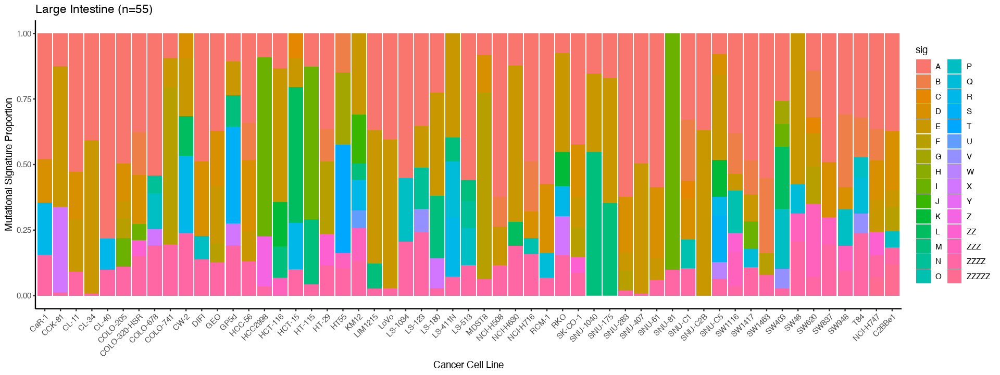

In [80]:
ggplot(sigs_melt, aes(sample, value, fill = sig)) +
  geom_col() +
  ggtitle( paste0("Large Intestine (n=", length(list1), ")")) +
  #scale_fill_brewer() +
  theme(axis.text.x=element_text(angle = 45, hjust = 1)) +
  xlab("Cancer Cell Line") +
  ylab("Mutational Signature Proportion") +
  scale_x_discrete(limits = list1) +
  theme_bw() +
  theme(axis.text.x=element_text(angle = 45, hjust = 1),
    panel.border = element_blank(),
    panel.grid.major = element_blank(),
    panel.grid.minor = element_blank(),
    axis.line = element_line(colour = "black"))

In [81]:
tissues
# 'Adrenal Gland''Autonomic Ganglia''Biliary Tract''Bladder''Bone''Breast''Cervix''CNS''Endometrium''Kidney'
# 'L. Intestine''Liver''Lung''NS''Oesophagus''Ovary''Pancreas''Placenta''Pleura''Prostate''S. Intestine'
# 'Salivary Gland''Skin''Soft Tissue''Stomach''Testis''Thyroid''Upper Aerodigestive Tract''Vulva''WBC'

[1] "Adrenal Gland"             "Autonomic Ganglia"        
 [3] "Biliary Tract"             "Bladder"                  
 [5] "Bone"                      "Breast"                   
 [7] "Cervix"                    "CNS"                      
 [9] "Endometrium"               "Kidney"                   
[11] "L. Intestine"              "Liver"                    
[13] "Lung"                      "NS"                       
[15] "Oesophagus"                "Ovary"                    
[17] "Pancreas"                  "Placenta"                 
[19] "Pleura"                    "Prostate"                 
[21] "S. Intestine"              "Salivary Gland"           
[23] "Skin"                      "Soft Tissue"              
[25] "Stomach"                   "Testis"                   
[27] "Thyroid"                   "Upper Aerodigestive Tract"
[29] "Vulva"                     "WBC"

In [82]:
#tissues = c("Adrenal Gland","Autonomic Ganglia","Biliary Tract","Bladder","Bone","Breast",
#                              "Cervix","CNS","Endometrium","Kidney","L. Intestine","Liver","Lung","NS",
#                              "Oesophagus","Ovary","Pancreas","Placenta","Pleura","Prostate","Salivary Gland",
#                              "S. Intestine","Skin","Soft Tissue","Stomach","Testis","Thyroid",
#                              "Upper Aerodigestive Tract","Vulva","WBC") 

In [83]:
options(repr.plot.width=16, repr.plot.height=6)

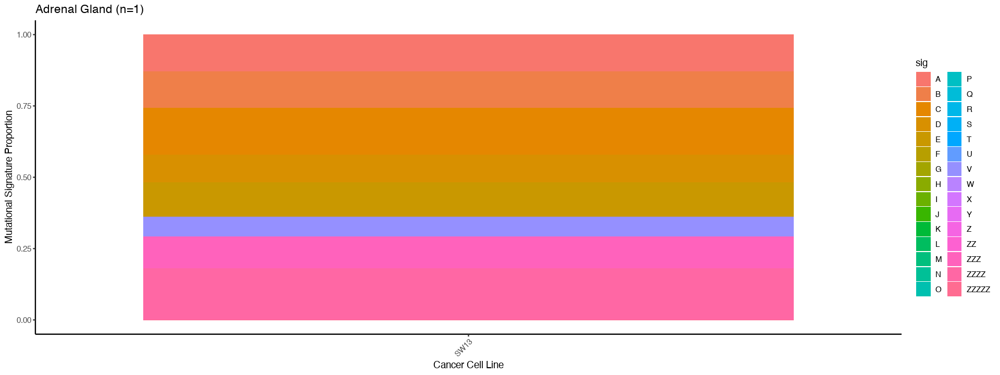

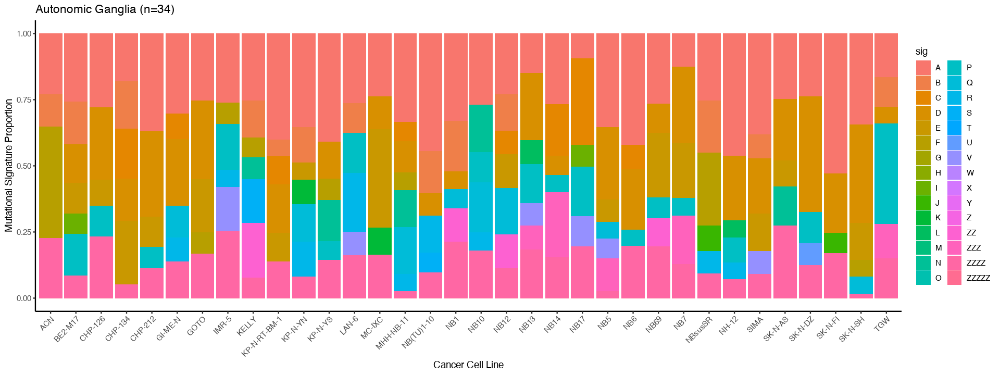

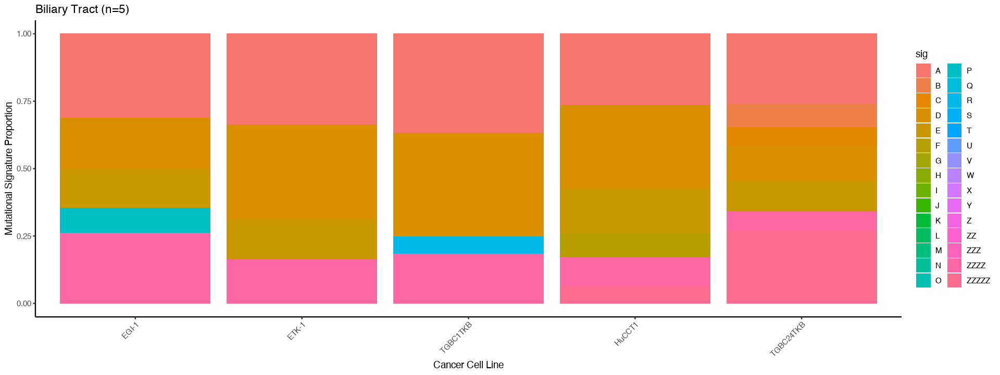

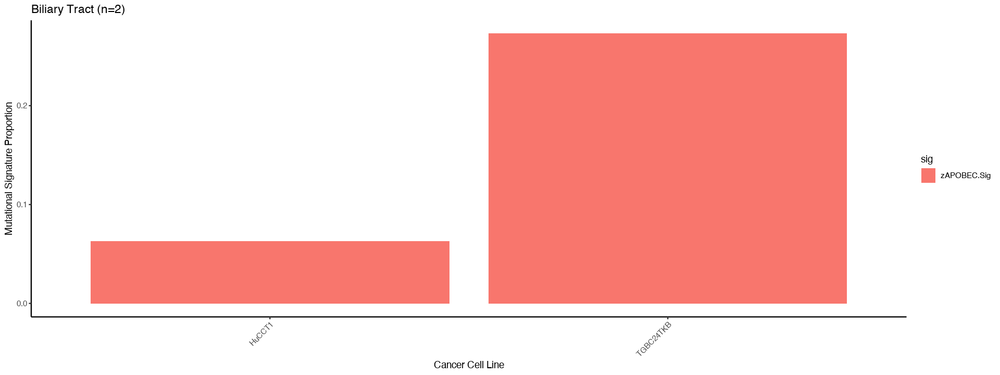

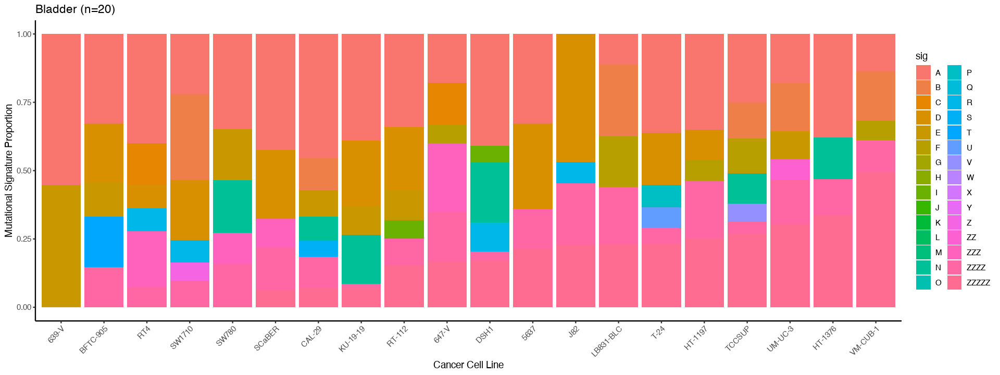

...

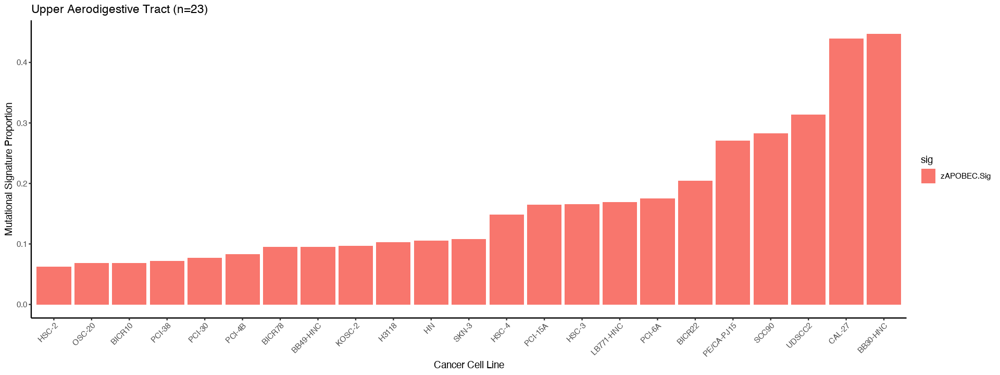

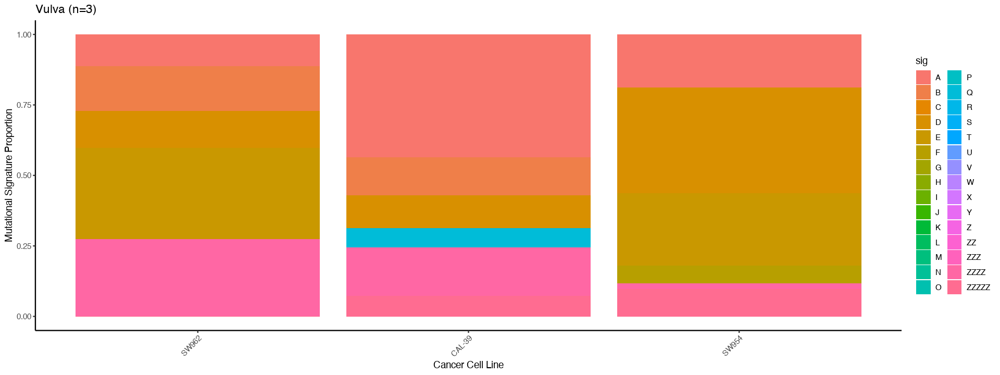

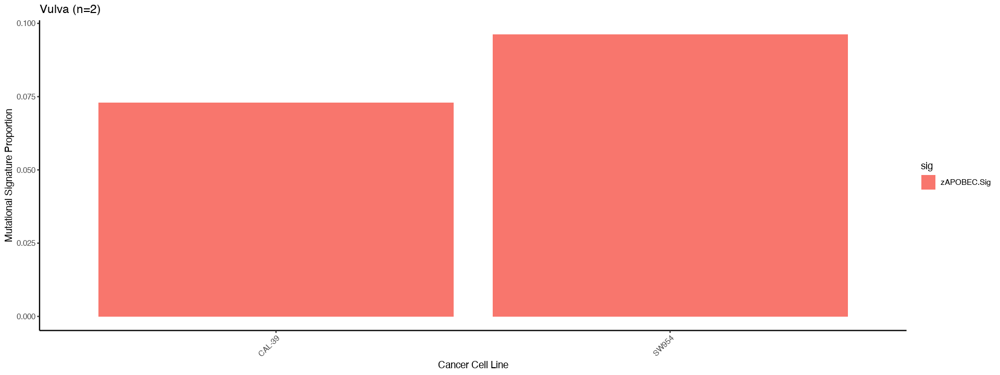

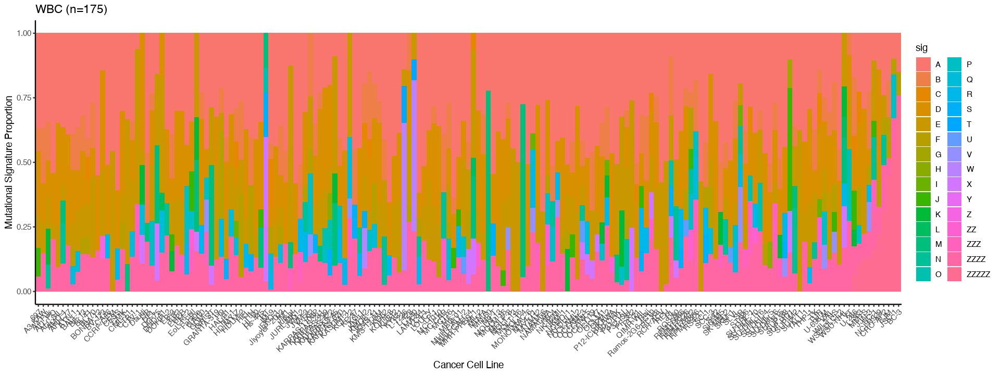

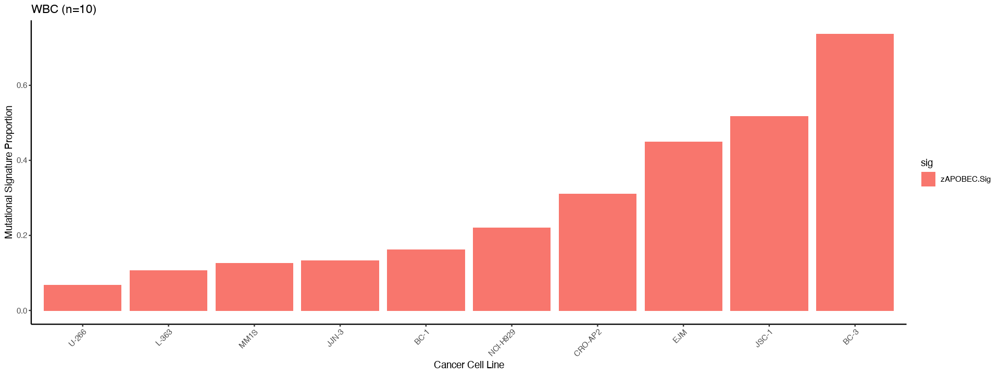

In [84]:
for( this_tissue in tissues ){
    sigs_individual <- subset(sigs_tissues, tissue == this_tissue)
    sigs_individual <- sigs_individual[,!colnames(sigs_individual) %in% c('tissue','mut_tot')]
    sigs_melt <- melt(sigs_individual, id = "sample")
    colnames(sigs_melt) <- c("sample", "sig", "value")
    sigs_melt[,"sig"] <- gsub("weights.", "", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.10", "I", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.11", "J", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.12", "K", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.14", "L", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.15", "M", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.16", "N", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.17", "O", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.18", "P", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.19", "Q", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.20", "R", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.21", "S", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.22", "T", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.23", "U", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.24", "V", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.25", "W", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.26", "X", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.27", "Y", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.28", "Z", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.29", "ZZ", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.30", "ZZZ", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("unknown", "ZZZZ", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("zAPOBEC.Sig", "ZZZZZ", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.1", "A", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.3", "B", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.4", "C", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.5", "D", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.6", "E", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.7", "F", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.8", "G", sigs_melt[,"sig"])
    sigs_melt[,"sig"] <- gsub("Signature.9", "H", sigs_melt[,"sig"])
    list <- sigs_individual[order(sigs_individual$zAPOBEC.Sig),]
    list1 <- as.vector(list[,"sample"])
    print(ggplot(sigs_melt, aes(sample, value, fill = sig)) +
      geom_col() +
      ggtitle( paste0(this_tissue," (n=", length(list1), ")")) +
      #scale_fill_brewer() +
      theme(axis.text.x=element_text(angle = 45, hjust = 1)) +
      xlab("Cancer Cell Line") +
      ylab("Mutational Signature Proportion") +
      scale_x_discrete(limits = list1) +
      theme_bw() +
      theme(axis.text.x=element_text(angle = 45, hjust = 1),
        panel.border = element_blank(),
        panel.grid.major = element_blank(),
        panel.grid.minor = element_blank(),
        axis.line = element_line(colour = "black")))

    sigs_individual <- subset(sigs_individual, zAPOBEC.Sig > 0)
    if( nrow(sigs_individual) > 0){
        sigs_melt <- melt(sigs_individual, id = "sample")
        colnames(sigs_melt) <- c("sample", "sig", "value")
        sigs_melt <- subset(sigs_melt, sig == "zAPOBEC.Sig")
        list <- sigs_individual[order(sigs_individual$zAPOBEC.Sig),]
        list1 <- as.vector(list[,"sample"])
        print(ggplot(sigs_melt, aes(sample, value, fill = sig)) +
          geom_col() +
          ggtitle( paste0(this_tissue," (n=", length(list1), ")")) +
          #scale_fill_brewer() +
          theme(axis.text.x=element_text(angle = 45, hjust = 1)) +
          xlab("Cancer Cell Line") +
          ylab("Mutational Signature Proportion") +
          scale_x_discrete(limits = list1) +
          theme_bw() +
          theme(axis.text.x=element_text(angle = 45, hjust = 1),
            panel.border = element_blank(),
            panel.grid.major = element_blank(),
            panel.grid.minor = element_blank(),
            axis.line = element_line(colour = "black")))
    }
}

In [85]:
enrich_tot <- unique(cosmic_mut_all_sort)
enrich_tot$Mut_TCW <- "0"
enrich_tot$Mut_C <- "0"
enrich_tot$Con_TCW <- "0"
enrich_tot$Con_C <- "0"
mut <- data.frame(do.call('rbind', strsplit(as.character(enrich_tot$mut),'>',fixed=T)))
enrich_tot$mut_ref <- mut[,1]

enrich_C <- subset(enrich_tot, mut_ref == "C")
enrich_CtoK <- subset(enrich_C, mut != "C>A") # Remove C>A mutations!

enrich_CtoK[which(enrich_CtoK$mut_ref == "C"),"Mut_C"] <- "1"

enrich_CtoK[which(enrich_CtoK$trinuc_mut == "T[C>G]A"),"Mut_TCW"] <- "1"
enrich_CtoK[which(enrich_CtoK$trinuc_mut == "T[C>G]T"),"Mut_TCW"] <- "1"
enrich_CtoK[which(enrich_CtoK$trinuc_mut == "T[C>T]A"),"Mut_TCW"] <- "1"
enrich_CtoK[which(enrich_CtoK$trinuc_mut == "T[C>T]T"),"Mut_TCW"] <- "1"

enrich_CtoK$Con_C <- str_count(enrich_CtoK$context, "C") + str_count(enrich_CtoK$context, "G")

enrich_CtoK$Con_TCW <- str_count(enrich_CtoK$context, "TCA") + str_count(enrich_CtoK$context, "TCT") +
                       str_count(enrich_CtoK$context, "TGA") + str_count(enrich_CtoK$context, "TGT")

enrich_final <- enrich_CtoK[,16:20]
enrich_final$Mut_TCW <- as.integer(enrich_final$Mut_TCW)
enrich_final$Mut_C <- as.integer(enrich_final$Mut_C)

enrich_final <- ddply(enrich_final, "sample", numcolwise(sum))

rownames(enrich_final) <- enrich_final$sample
enrich_final$sample <- NULL
enrich_final$enrich_score <- (enrich_final$Mut_TCW / enrich_final$Con_TCW) / (enrich_final$Mut_C / enrich_final$Con_C)

enrich_matrix <- as.data.frame(enrich_final$Mut_TCW)
enrich_matrix$Mut_Denom <- enrich_final$Mut_C - enrich_final$Mut_TCW
enrich_matrix$Con_TCW <- enrich_final$Con_TCW
enrich_matrix$Con_Denom <- enrich_final$Con_C - enrich_final$Con_TCW
rownames(enrich_matrix) <- rownames(enrich_final)
colnames(enrich_matrix) <- c("Mut_TCW", "Mut_Denom", "Con_TCW", "Con_Denom")

enrich_matrix <- as.matrix(enrich_matrix)


exe_fisher <- function(x) {
  m <- matrix(unlist(x), ncol = 2, nrow = 2, byrow = T)
  f <- fisher.test(m)
  return(as.data.frame(f$p.value))
}

fishers <- t(as.data.frame(apply(enrich_matrix, 1, exe_fisher)))
fishers <- as.data.frame(fishers)

enrich_final$fisher_pval <- fishers$V1
enrich_final$bh_adj_qval <- p.adjust(enrich_final$fisher_pval, method = "BH")

enrich_final$Mut_Ratio <- enrich_final$Mut_TCW/(enrich_final$Mut_C - enrich_final$Mut_TCW)
enrich_final$Con_Ratio <- enrich_final$Con_TCW/(enrich_final$Con_C - enrich_final$Con_TCW)
enrich_final[which(enrich_final$Mut_Ratio < enrich_final$Con_Ratio), "bh_adj_qval"] <- 1
enrich_final$Mut_Ratio <- NULL
enrich_final$Con_Ratio <- NULL
enrich_final$sample <- rownames(enrich_final)
rownames(enrich_final) <- NULL


In [86]:
head(cell_line_mutload)

,sample,mut_tot,tissue
,<fct>,<int>,<chr>
1,201T,478,Lung
2,22RV1,1894,Prostate
3,23132-87,1874,Stomach
4,42-MG-BA,231,CNS
5,451Lu,647,Skin
6,5637,651,Bladder


In [87]:
head(subset(cell_line_mutload,tissue=="Lung"))
print(class("Lung"))

,sample,mut_tot,tissue
,<fct>,<int>,<chr>
1,201T,478,Lung
25,A427,476,Lung
28,A549,337,Lung
31,ABC-1,545,Lung
55,BEN,519,Lung
85,CAL-12T,709,Lung


[1] "character"


In [88]:
if( exists("mut_med_quantiles") ){
    rm(mut_med_quantiles)
}

for( this_tissue in tissues ) {
    mut_sub <- subset(cell_line_mutload, tissue == this_tissue)
    if( exists("mut_med_quantiles") ){
        x <- as.data.frame(t(quantile(mut_sub$mut_tot)))
        mut_med_quantiles <- rbind(mut_med_quantiles, x)
    } else {
        mut_med_quantiles <- as.data.frame(t(quantile(mut_sub$mut_tot)))
    }
}

In [89]:
rownames(mut_med_quantiles) = tissues
mut_med_quantiles$tissue <- rownames(mut_med_quantiles)
colnames(mut_med_quantiles) <- c("low", "first", "med", "third", "high", "tissue")

In [90]:
mut_med_quantiles

,low,first,med,third,high,tissue
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
Adrenal Gland,423,423.00,423.0,423.00,423,Adrenal Gland
Autonomic Ganglia,170,231.25,300.5,399.50,589,Autonomic Ganglia
Biliary Tract,257,290.00,369.0,369.00,430,Biliary Tract
Bladder,175,227.75,324.0,437.25,1981,Bladder
Bone,124,210.25,238.0,303.00,3477,Bone
Breast,102,236.00,337.0,462.75,1603,Breast
Cervix,158,310.50,346.5,439.75,1971,Cervix
CNS,88,204.00,243.0,323.00,657,CNS
Endometrium,176,809.50,1810.0,3354.50,4991,Endometrium


In [91]:
mut_med_quantiles <- mut_med_quantiles[order(mut_med_quantiles$med),] 
head(mut_med_quantiles)

,low,first,med,third,high,tissue
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
Pleura,58,162.00,185,220.00,2334,Pleura
Prostate,146,163.75,228,2190.75,3202,Prostate
Kidney,54,192.00,229,321.00,698,Kidney
Pancreas,161,203.75,236,280.50,353,Pancreas
Bone,124,210.25,238,303.00,3477,Bone
CNS,88,204.00,243,323.00,657,CNS


In [92]:
plot_order <- as.vector(mut_med_quantiles[,"tissue"])
head(plot_order)
# 'Pleura''Prostate''Kidney''Pancreas''Bone''CNS'

[1] "Pleura"   "Prostate" "Kidney"   "Pancreas" "Bone"     "CNS"

In [93]:
# Adjust plot size
options(repr.plot.width=16, repr.plot.height=6)

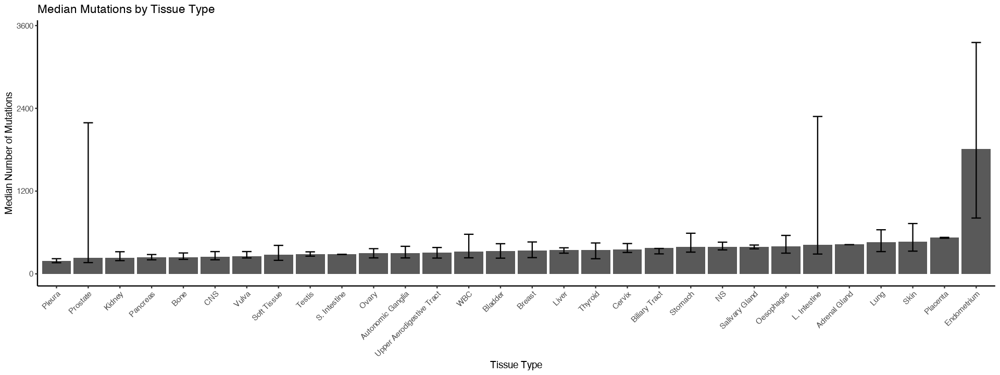

In [94]:
ggplot(mut_med_quantiles, aes(tissue, med)) +
  geom_col() +
  theme(axis.text.x=element_text(angle = 45, hjust = 1), legend.position = "none") +
  geom_errorbar(aes(ymin=first, ymax=third), width=.3) +
  scale_y_continuous(limits = c(0,3501),
    breaks = c(0,1200,2400,3600)) +
  xlab("Tissue Type") +
  ylab("Median Number of Mutations") +
  #geom_text(aes(label = freq), vjust = -0.2) +
  theme_bw() +
  theme(axis.text.x=element_text(angle = 45, hjust = 1),
    panel.border = element_blank(),
    panel.grid.major = element_blank(),
    panel.grid.minor = element_blank(),
    axis.line = element_line(colour = "black")) +
  scale_fill_gradient(low = "blue", high = "red") +
  scale_x_discrete(limits = plot_order ) +
  ggtitle("Median Mutations by Tissue Type")

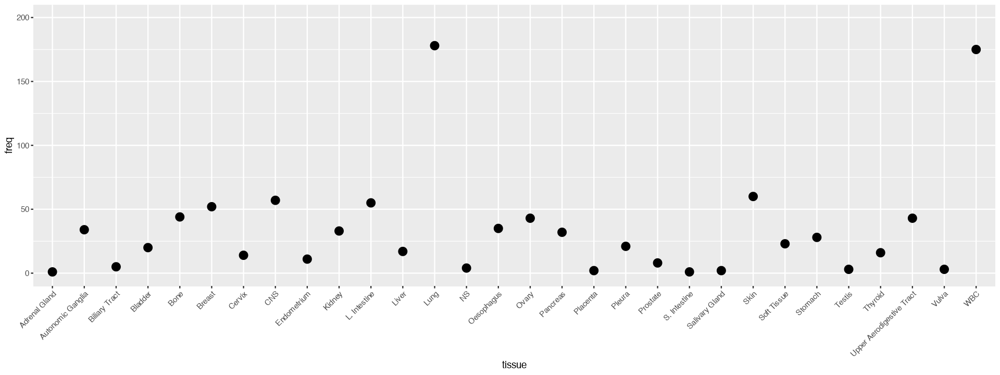

In [95]:
number <- as.data.frame(table(cosmic_tissue_type$tissue))
colnames(number) <- c("tissue", "freq")
ggplot(number, aes(tissue, freq)) +
  geom_point(size = 4) +
  ylim(0,200) +
  theme(axis.text.x=element_text(angle = 45, hjust = 1)) +
  scale_x_discrete(limits = tissues )
#  scale_x_discrete(limits = c("Adrenal Gland","Autonomic Ganglia","Biliary Tract","Bladder","Bone","Breast",
#                              "Cervix","CNS","Endometrium","Kidney","L. Intestine","Liver","Lung","NS",
#                              "Oesophagus","Ovary","Pancreas","Placenta","Pleura","Prostate","Salivary Gland",
#                              "S. Intestine","Skin","Soft Tissue","Stomach","Testis","Thyroid",
#                              "Upper Aerodigestive Tract","Vulva","WBC"))

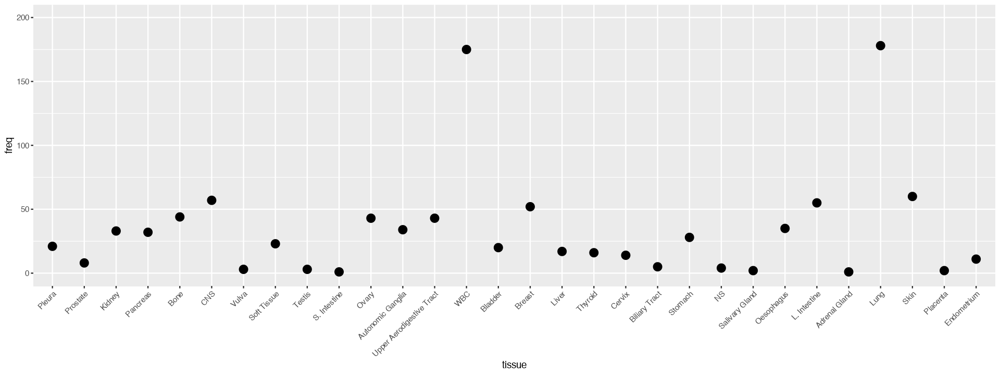

In [96]:
# use same sort as median number of mutations plot
number <- as.data.frame(table(cosmic_tissue_type$tissue))
colnames(number) <- c("tissue", "freq")
ggplot(number, aes(tissue, freq)) +
  geom_point(size = 4) +
  ylim(0,200) +
  theme(axis.text.x=element_text(angle = 45, hjust = 1)) +
  scale_x_discrete(limits = plot_order)

In [97]:
sigs_tissues_individual <- subset(sigs_tissues, tissue == "L. Intestine")
head(sigs_tissues_individual)

,sample,weights.Signature.1,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,weights.Signature.25,weights.Signature.26,weights.Signature.27,weights.Signature.28,weights.Signature.29,weights.Signature.30,unknown,zAPOBEC.Sig,mut_tot,tissue
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
76,C2BBe1,0.3742301,0,0,0.2239434,0.06375364,0.09289549,0,0,0,⋯,0,0.0000000,0,0,0,0,0.06222285,0.1204332,355,L. Intestine
104,CaR-1,0.4800964,0,0,0.1660204,0.00000000,0.00000000,0,0,0,⋯,0,0.0000000,0,0,0,0,0.15498050,0.0000000,340,L. Intestine
107,CCK-81,0.1261551,0,0,0.0000000,0.53593524,0.00000000,0,0,0,⋯,0,0.3261117,0,0,0,0,0.01179789,0.0000000,2917,L. Intestine
120,CL-11,0.5281166,0,0,0.1833559,0.19830626,0.00000000,0,0,0,⋯,0,0.0000000,0,0,0,0,0.09022129,0.0000000,232,L. Intestine
121,CL-34,0.4077921,0,0,0.0000000,0.58501286,0.00000000,0,0,0,⋯,0,0.0000000,0,0,0,0,0.00719503,0.0000000,1177,L. Intestine
122,CL-40,0.7830698,0,0,0.0000000,0.00000000,0.00000000,0,0,0,⋯,0,0.0000000,0,0,0,0,0.09862675,0.0000000,390,L. Intestine


In [98]:
length(sigs_tissues_individual)

[1] 33

In [99]:
sigs_tissues_individual_1 <- sigs_tissues_individual[order(sigs_tissues_individual$zAPOBEC.Sig),]
rownames(sigs_tissues_individual_1) <- c(1:nrow(sigs_tissues_individual_1))
sigs_tissues_individual_1[,"order"] <- rownames(sigs_tissues_individual_1)
head(sigs_tissues_individual_1)

,sample,weights.Signature.1,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,weights.Signature.26,weights.Signature.27,weights.Signature.28,weights.Signature.29,weights.Signature.30,unknown,zAPOBEC.Sig,mut_tot,tissue,order
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>,<chr>
1,CaR-1,0.4800964,0,0,0.1660204,0.00000000,0.00000000,0,0,0.000000,⋯,0.0000000,0,0,0,0,0.15498050,0,340,L. Intestine,1
2,CCK-81,0.1261551,0,0,0.0000000,0.53593524,0.00000000,0,0,0.000000,⋯,0.3261117,0,0,0,0,0.01179789,0,2917,L. Intestine,2
3,CL-11,0.5281166,0,0,0.1833559,0.19830626,0.00000000,0,0,0.000000,⋯,0.0000000,0,0,0,0,0.09022129,0,232,L. Intestine,3
4,CL-34,0.4077921,0,0,0.0000000,0.58501286,0.00000000,0,0,0.000000,⋯,0.0000000,0,0,0,0,0.00719503,0,1177,L. Intestine,4
5,CL-40,0.7830698,0,0,0.0000000,0.00000000,0.00000000,0,0,0.000000,⋯,0.0000000,0,0,0,0,0.09862675,0,390,L. Intestine,5
6,COLO-205,0.4977178,0,0,0.1410225,0.06981521,0.07250227,0,0,0.109247,⋯,0.0000000,0,0,0,0,0.10969521,0,231,L. Intestine,6


In [100]:
length(sigs_tissues_individual_1)

[1] 34

In [101]:
#sigs_tissues_individual_1 <- sigs_tissues_individual_1[
#    ,!colnames(sigs_tissues_individual_1) %in% c('weights.Signature.2','weights.Signature.13','tissue')]
#head(sigs_individual_1)

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 20 rows containing non-finite values (stat_smooth).”
Warning message:
“Removed 20 rows containing missing values (geom_point).”


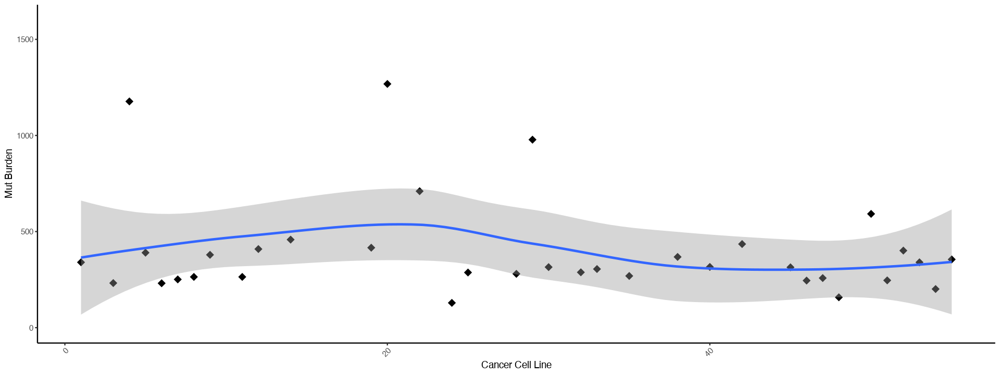

In [102]:
ggplot(sigs_tissues_individual_1, aes(as.numeric(order), mut_tot)) +
  geom_point(shape = 18, size = 4) +
  geom_smooth(span = 0.75) +
  theme(axis.text.x=element_text(angle = 45, hjust = 1)) +
  xlab("Cancer Cell Line") +
  ylab("Mut Burden") +
  ylim(0,1600) +
  theme_bw() +
  theme(axis.text.x=element_text(angle = 45, hjust = 1),
    panel.border = element_blank(),
    panel.grid.major = element_blank(),
    panel.grid.minor = element_blank(),
    axis.line = element_line(colour = "black"))

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

`geom_smooth()` using method = 'loess' and formula 'y ~ x'



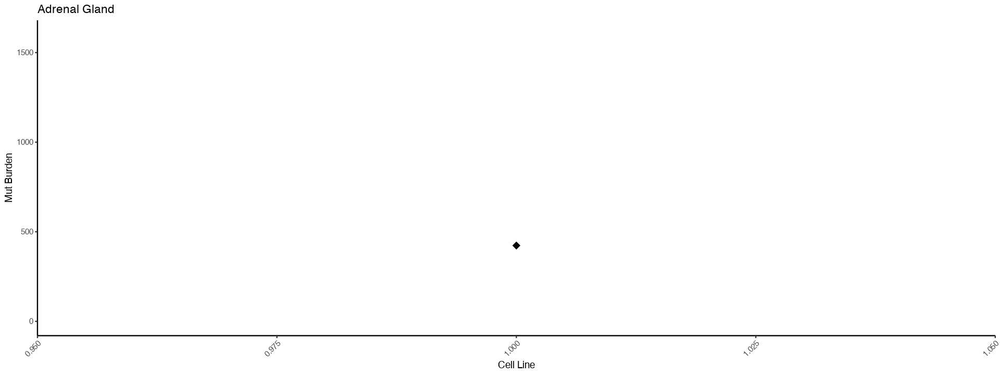

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.98”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.02”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.0804”
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
“span too small.   fewer data values than degrees of freedom.”
Warning message in predLoess(object$y, object$

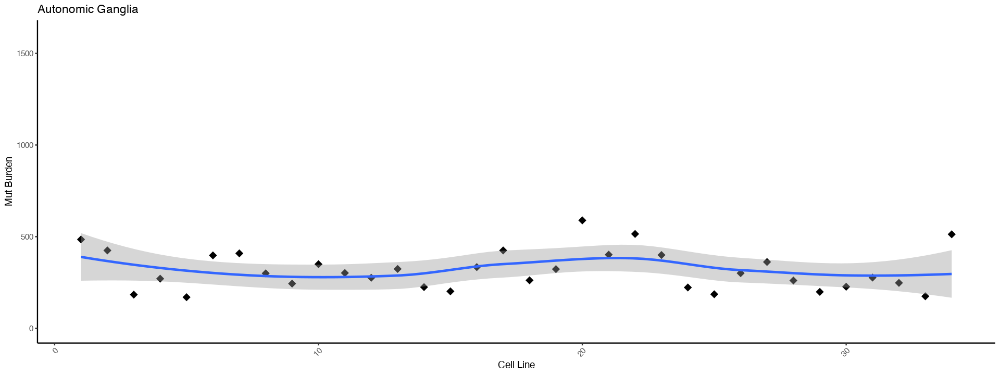

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 1 rows containing non-finite values (stat_smooth).”
Warning message:
“Removed 1 rows containing missing values (geom_point).”


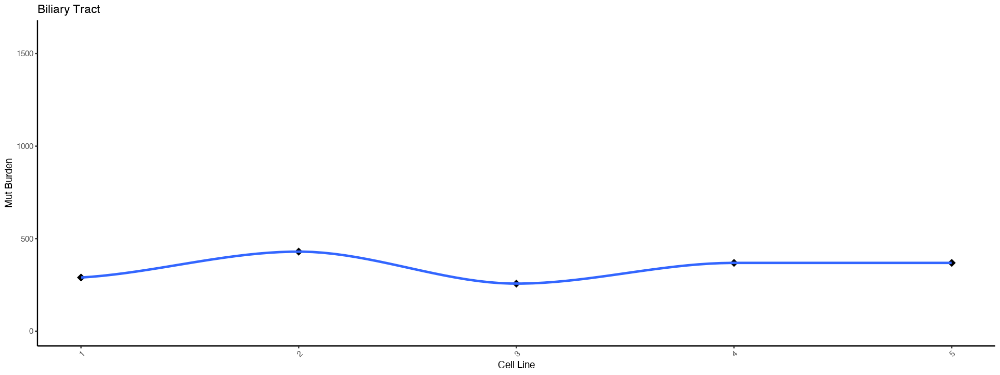

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 1 rows containing non-finite values (stat_smooth).”
Warning message:
“Removed 1 rows containing missing values (geom_point).”


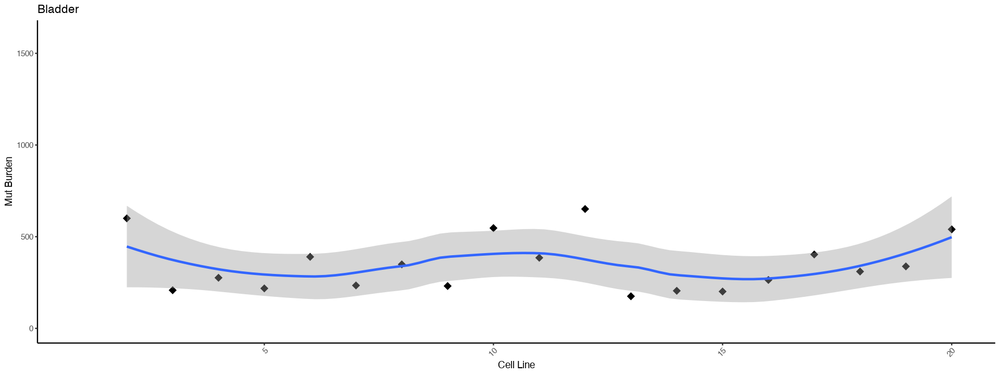

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 1 rows containing non-finite values (stat_smooth).”
Warning message:
“Removed 1 rows containing missing values (geom_point).”


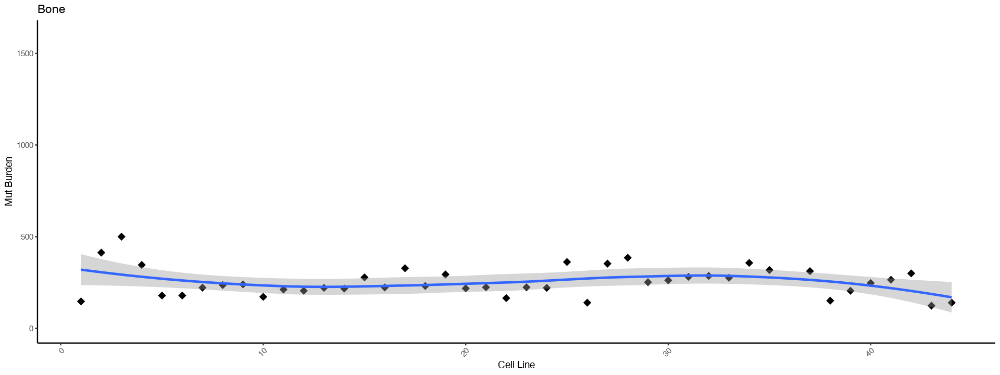

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 1 rows containing non-finite values (stat_smooth).”
Warning message:
“Removed 1 rows containing missing values (geom_point).”


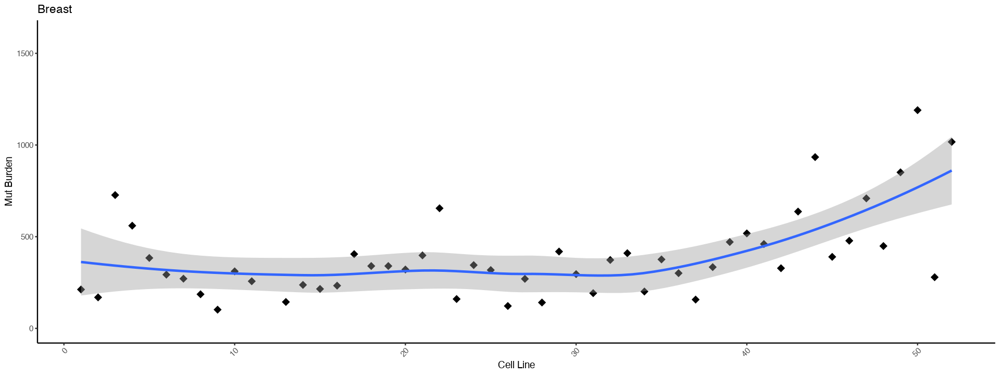

`geom_smooth()` using method = 'loess' and formula 'y ~ x'



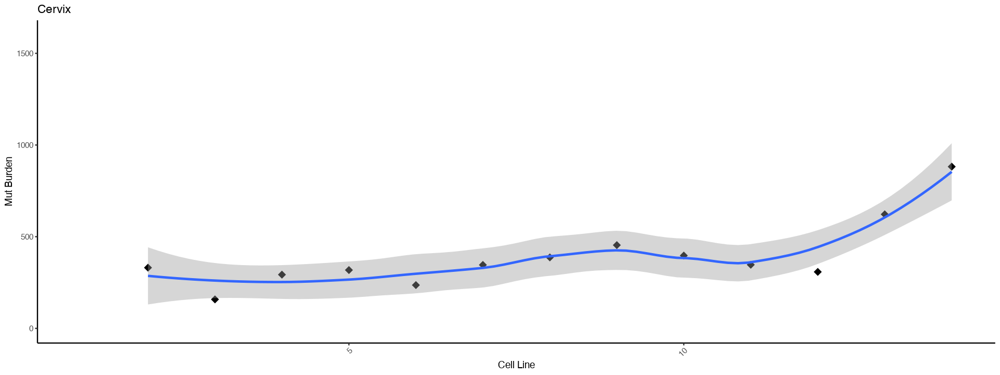

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 6 rows containing non-finite values (stat_smooth).”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 1.97”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 4.03”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
“span too small.   fewer data v

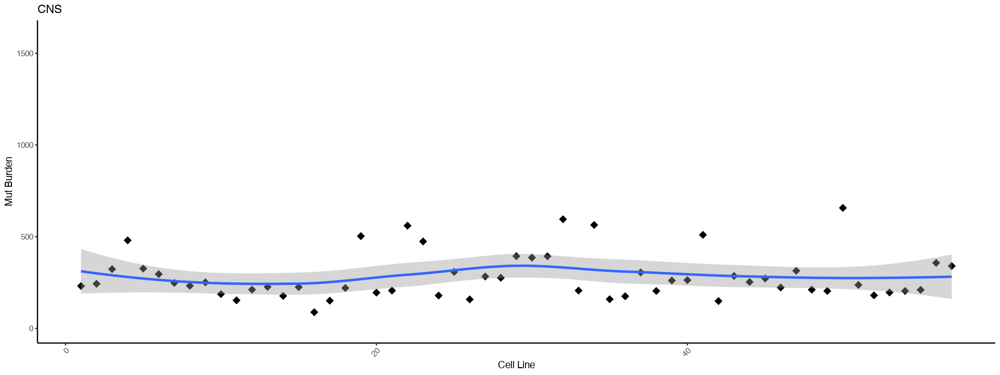

`geom_smooth()` using method = 'loess' and formula 'y ~ x'



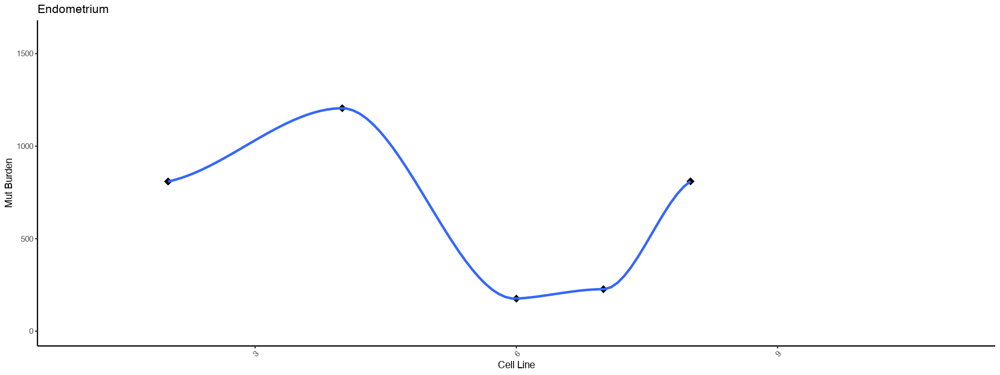

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 20 rows containing non-finite values (stat_smooth).”
Warning message:
“Removed 20 rows containing missing values (geom_point).”


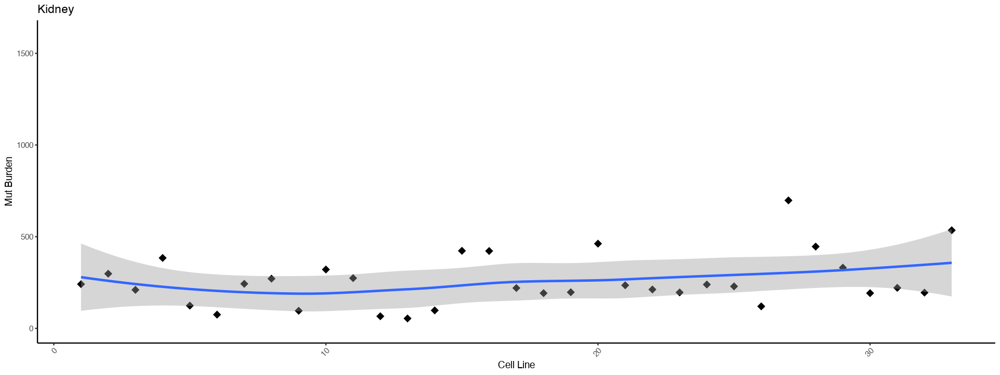

`geom_smooth()` using method = 'loess' and formula 'y ~ x'



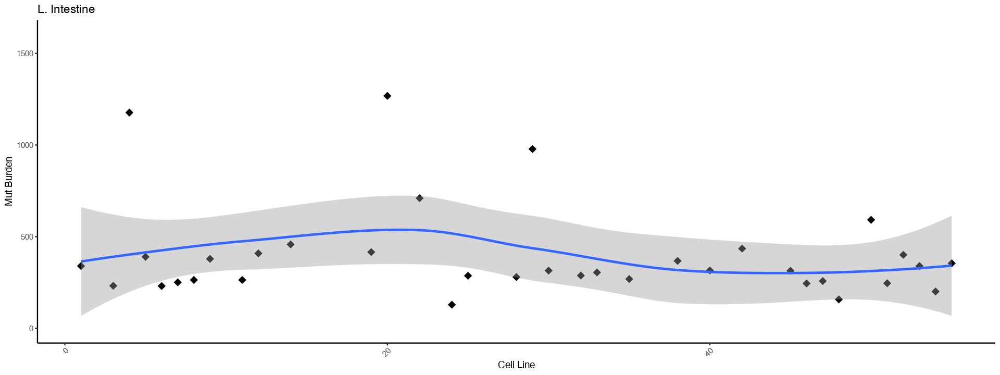

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 6 rows containing non-finite values (stat_smooth).”
Warning message:
“Removed 6 rows containing missing values (geom_point).”


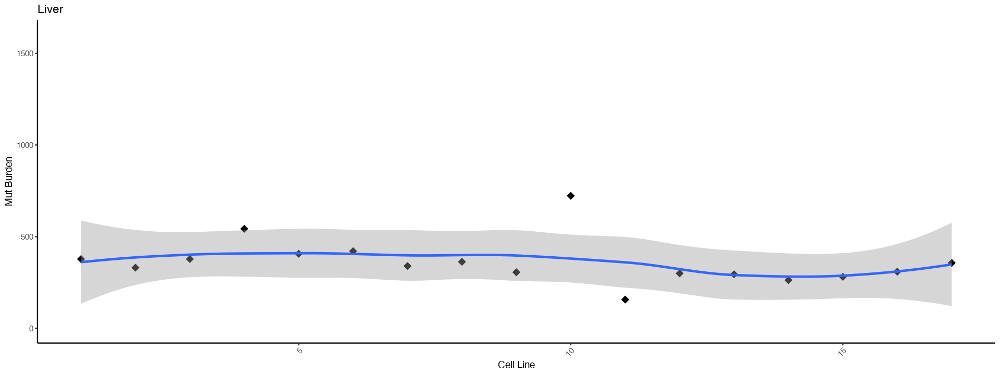

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.985”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.015”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.0602”
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
“span too small.   fewer data values than degrees of freedom.”
Warning message in predLoess(object$y, objec

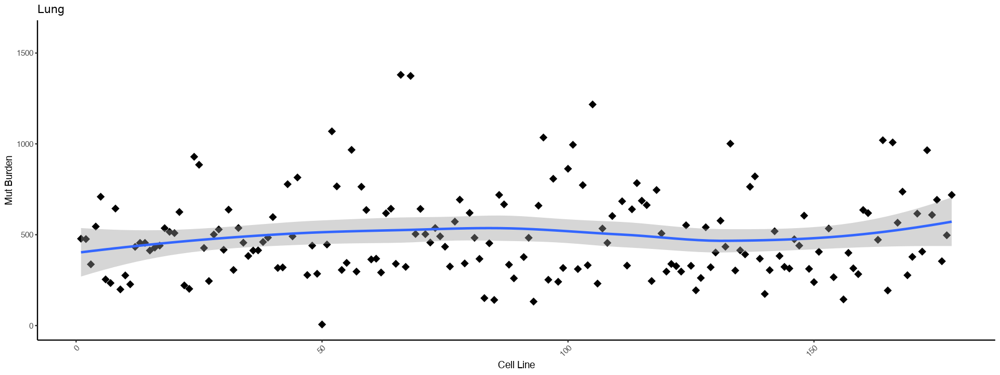

`geom_smooth()` using method = 'loess' and formula 'y ~ x'



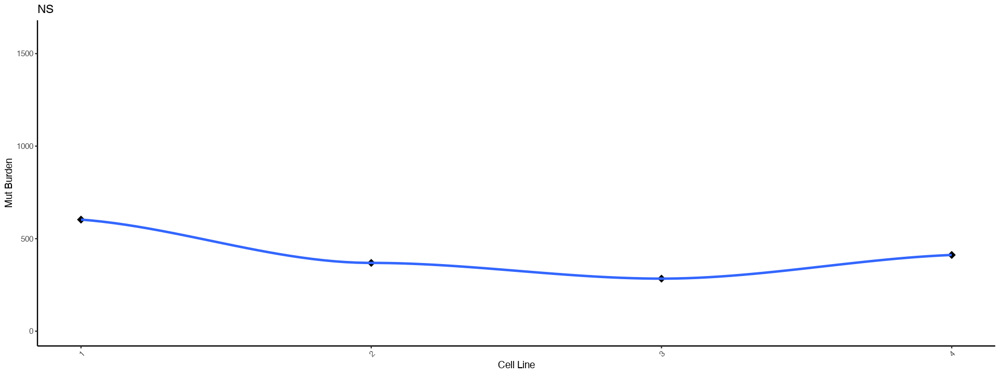

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 2 rows containing non-finite values (stat_smooth).”
Warning message:
“Removed 2 rows containing missing values (geom_point).”


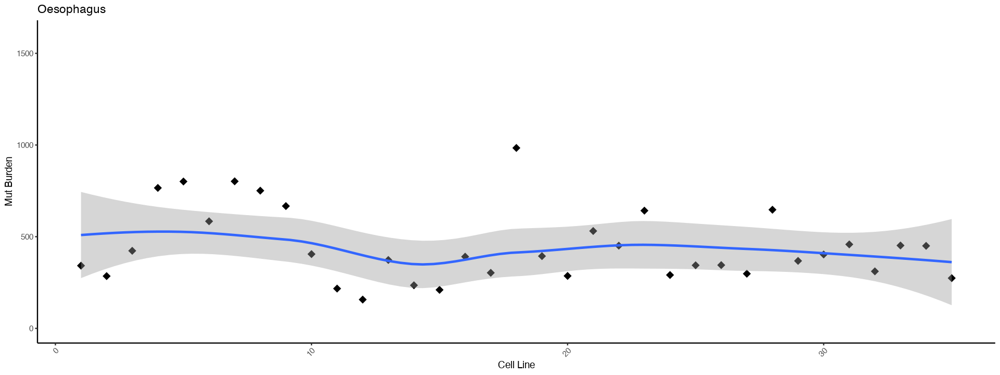

`geom_smooth()` using method = 'loess' and formula 'y ~ x'



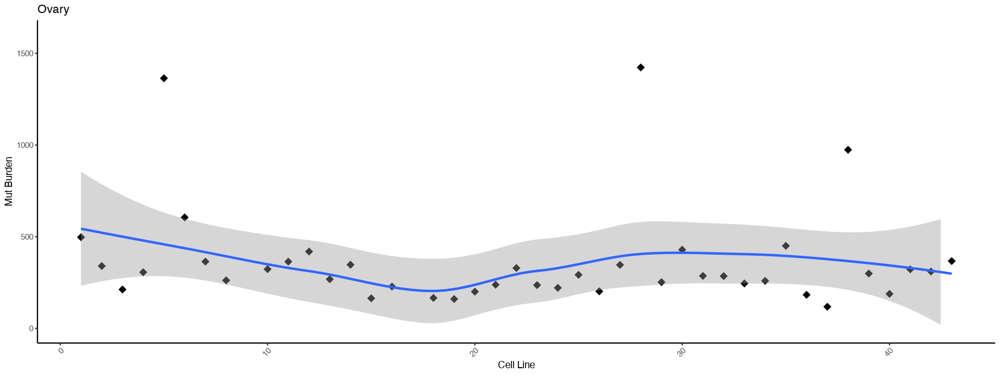

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“at  0.995”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“radius  2.5e-05”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“all data on boundary of neighborhood. make span bigger”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.995”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 0.005”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  1”
Warning message in simpleLoess(y, x, w, span, degree = degree, parame

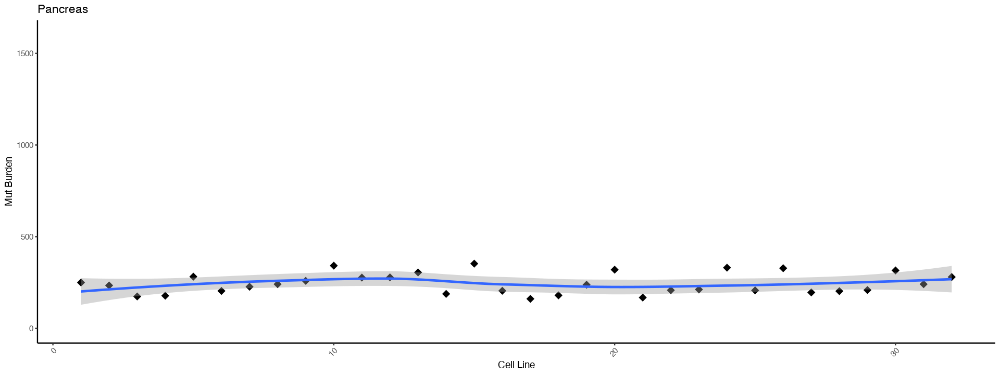

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 1 rows containing non-finite values (stat_smooth).”
Warning message:
“Removed 1 rows containing missing values (geom_point).”


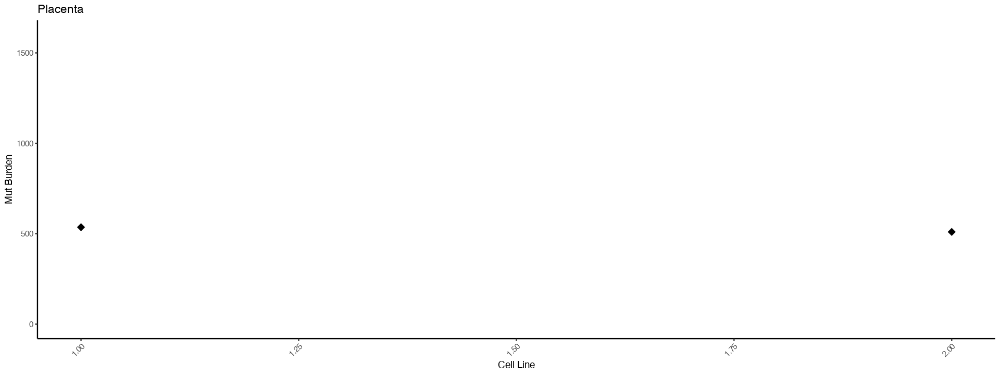

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 3 rows containing non-finite values (stat_smooth).”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 1.97”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 4.03”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
“span too small.   fewer data v

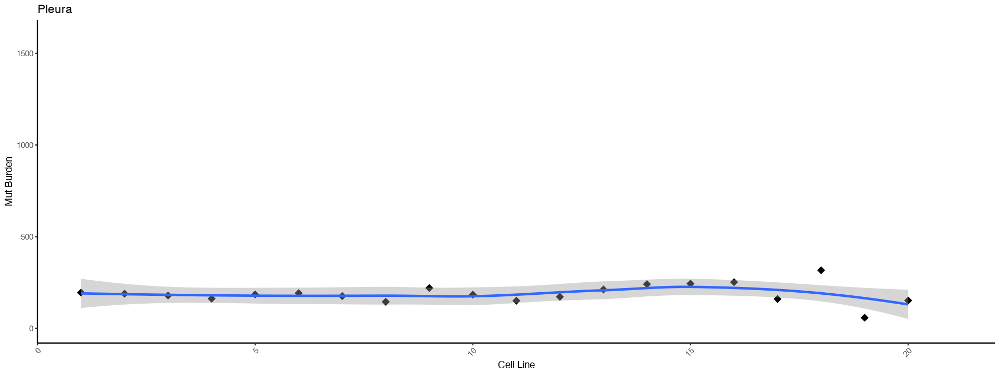

`geom_smooth()` using method = 'loess' and formula 'y ~ x'



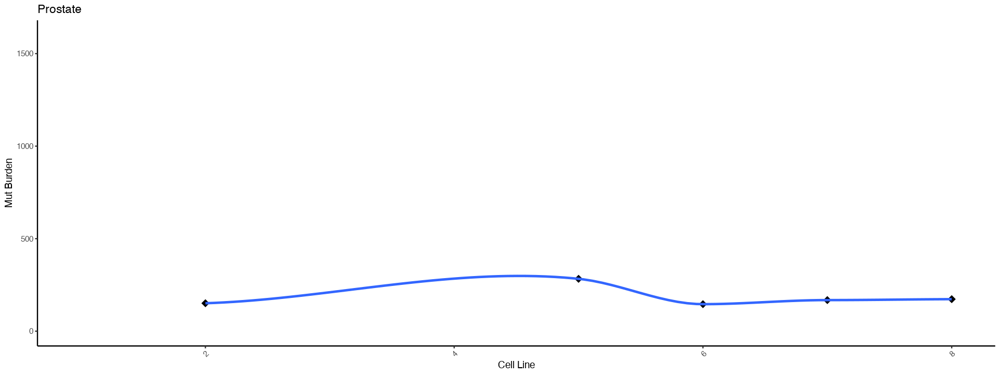

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“at  0.995”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“radius  2.5e-05”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“all data on boundary of neighborhood. make span bigger”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.995”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 0.005”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  1”
Warning message in simpleLoess(y, x, w, span, degree = degree, parame

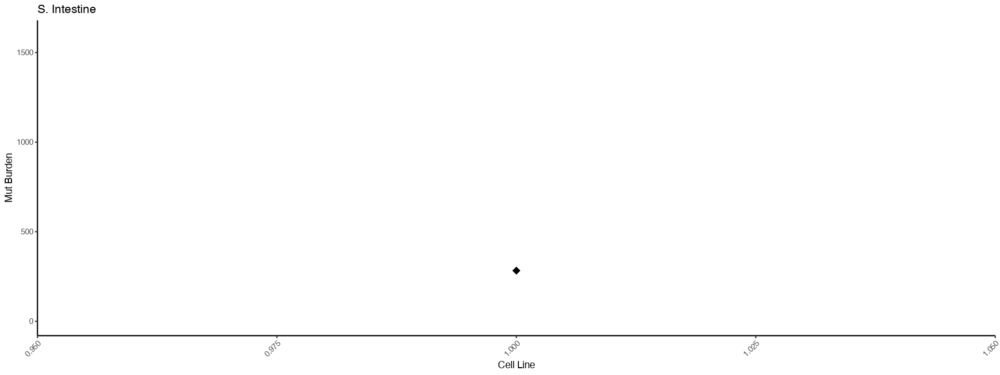

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 4 rows containing non-finite values (stat_smooth).”
Warning message:
“Removed 4 rows containing missing values (geom_point).”


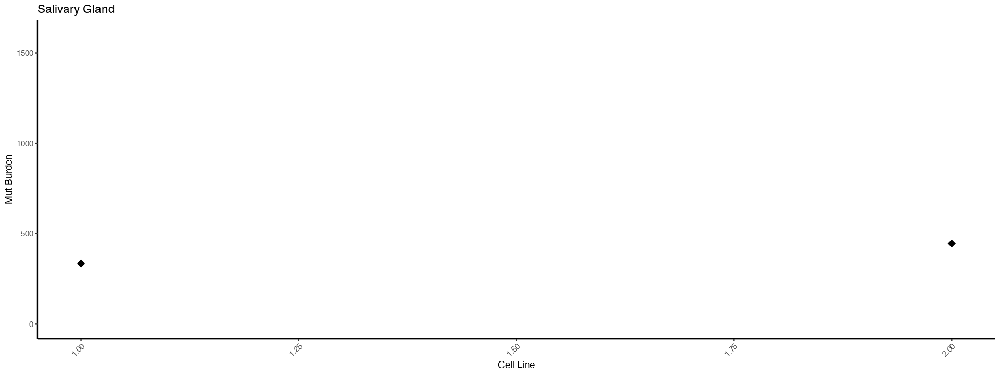

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 2 rows containing non-finite values (stat_smooth).”
Warning message:
“Removed 2 rows containing missing values (geom_point).”


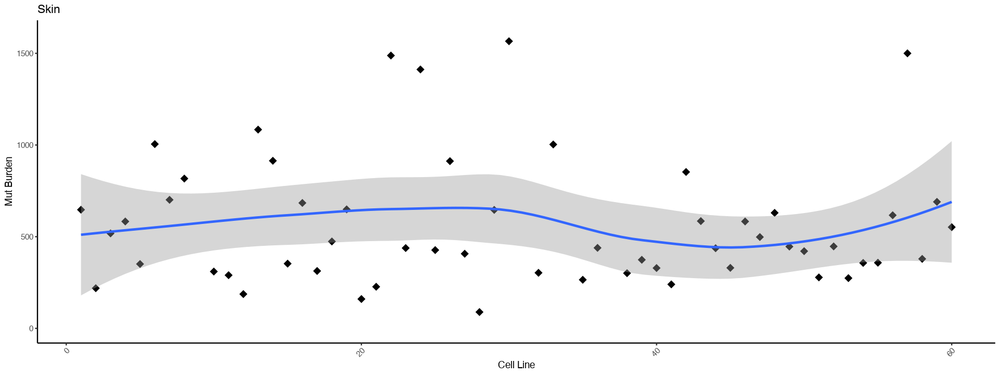

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 2 rows containing non-finite values (stat_smooth).”
Warning message:
“Removed 2 rows containing missing values (geom_point).”


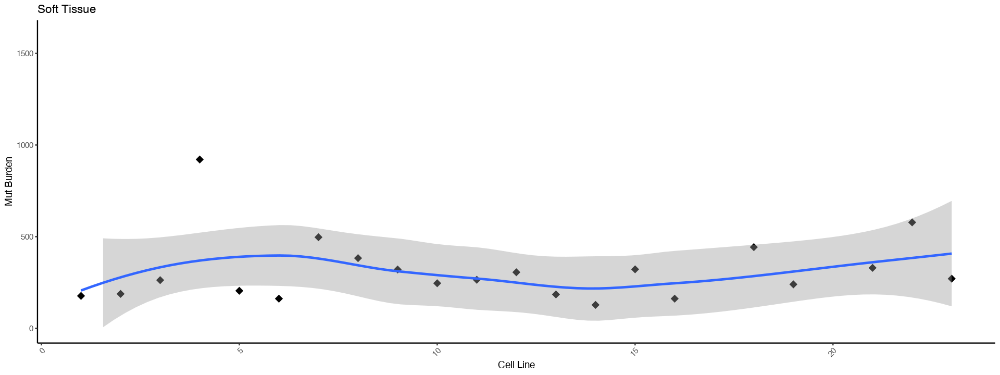

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.99”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 1.01”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 1.0201”
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
“span too small.   fewer data values than degrees of freedom.”
Warning message in predLoess(object$y, object$

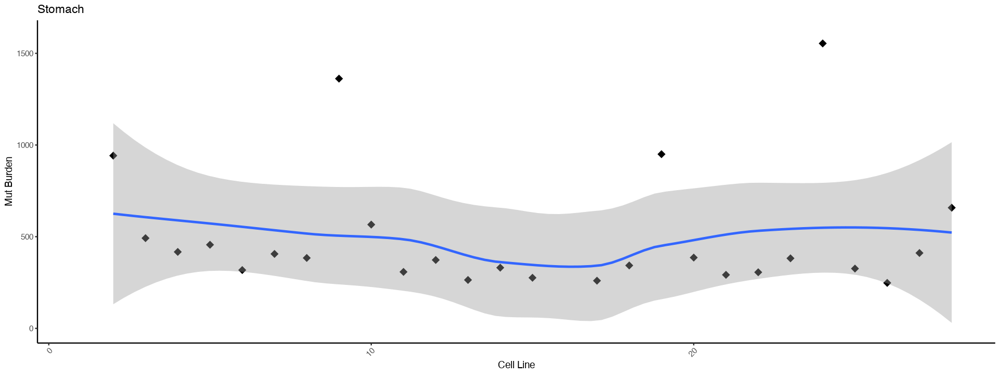

`geom_smooth()` using method = 'loess' and formula 'y ~ x'



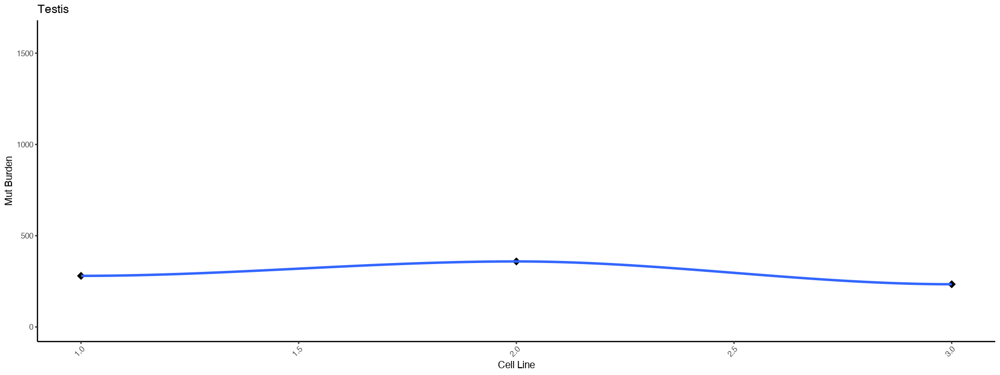

`geom_smooth()` using method = 'loess' and formula 'y ~ x'



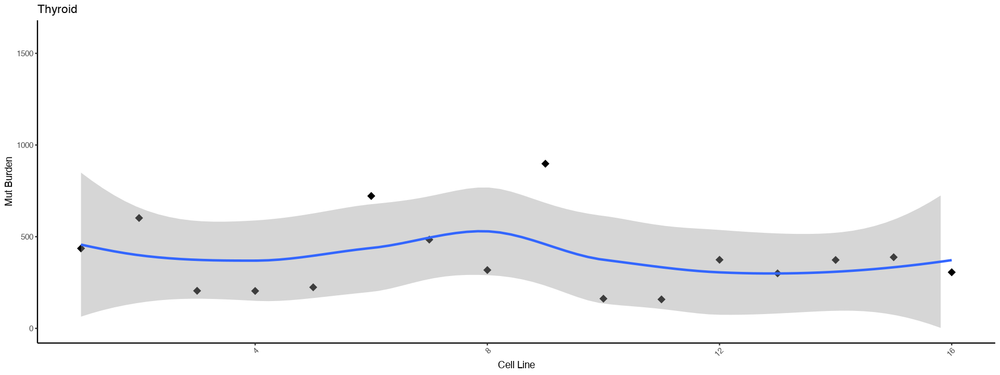

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.99”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 1.01”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 1.0201”
Warning message in predLoess(object$y, object$x, newx = if (is.null(newdata)) object$x else if (is.data.frame(newdata)) as.matrix(model.frame(delete.response(terms(object)), :
“span too small.   fewer data values than degrees of freedom.”
Warning message in predLoess(object$y, object$

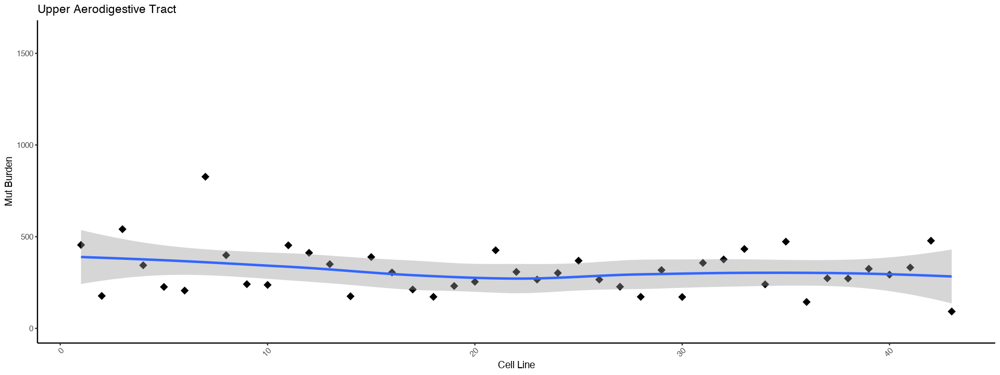

`geom_smooth()` using method = 'loess' and formula 'y ~ x'

Warning message:
“Removed 18 rows containing non-finite values (stat_smooth).”
Warning message:
“Removed 18 rows containing missing values (geom_point).”


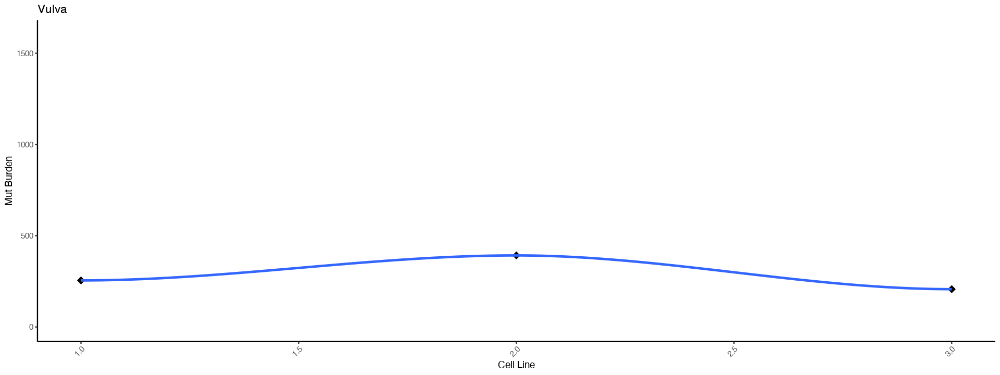

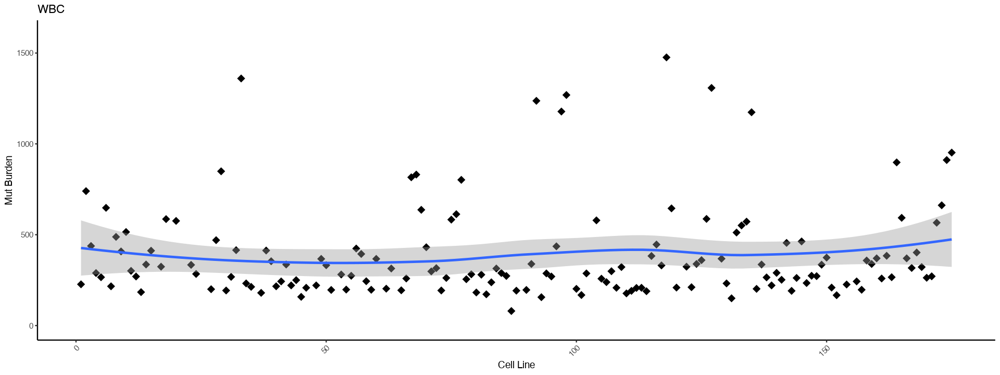

In [103]:
for( this_tissue in tissues ){
    sigs_tissues_individual <- subset(sigs_tissues, tissue == this_tissue)
    sigs_tissues_individual_1 <- sigs_tissues_individual[order(sigs_tissues_individual$zAPOBEC.Sig),]
    rownames(sigs_tissues_individual_1) <- c(1:nrow(sigs_tissues_individual_1))
    sigs_tissues_individual_1[,"order"] <- rownames(sigs_tissues_individual_1)
    print(ggplot(sigs_tissues_individual_1, aes(as.numeric(order), mut_tot)) +
      geom_point(shape = 18, size = 4) +
      geom_smooth(span = 0.75) +
      theme(axis.text.x=element_text(angle = 45, hjust = 1)) +
      ggtitle(this_tissue) +
      xlab("Cell Line") +
      ylab("Mut Burden") +
      ylim(0,1600) +
      theme_bw() +
      theme(axis.text.x=element_text(angle = 45, hjust = 1),
        panel.border = element_blank(),
        panel.grid.major = element_blank(),
        panel.grid.minor = element_blank(),
        axis.line = element_line(colour = "black")))
}

In [104]:
sigs_enrich <- merge(sigs_tissues, enrich_final, by = "sample")
head(sigs_enrich)

,sample,weights.Signature.1,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,zAPOBEC.Sig,mut_tot,tissue,Mut_TCW,Mut_C,Con_TCW,Con_C,enrich_score,fisher_pval,bh_adj_qval
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<int>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>
1,201T,0.3577211,0.06737416,0.1834977,0.3125219,0.0000000,0.00000000,0,0,0,⋯,0.0000000,478,Lung,13,121,301,2793,0.9969249,1.000000e+00,1.000000e+00
2,22RV1,0.4942950,0.00000000,0.0000000,0.0000000,0.5057050,0.00000000,0,0,0,⋯,0.0000000,1894,Prostate,16,695,1590,15952,0.2309687,8.812402e-15,1.000000e+00
3,23132-87,0.1470341,0.00000000,0.0000000,0.0000000,0.5110435,0.00000000,0,0,0,⋯,0.0000000,1874,Stomach,21,579,1297,13495,0.3773754,1.148650e-07,1.000000e+00
4,42-MG-BA,0.4631542,0.09640663,0.0000000,0.2871744,0.0000000,0.06034258,0,0,0,⋯,0.0000000,231,CNS,10,79,192,1730,1.1405591,5.880910e-01,9.279759e-01
5,451Lu,0.1972272,0.08236096,0.0000000,0.0000000,0.0000000,0.63184291,0,0,0,⋯,0.0000000,647,Skin,37,281,703,5860,1.0975838,5.731428e-01,9.145817e-01
6,5637,0.3277781,0.00000000,0.0000000,0.3135831,0.0000000,0.00000000,0,0,0,⋯,0.2128992,651,Bladder,54,235,613,5238,1.9635001,2.035192e-06,2.332467e-05


In [105]:
sigs_enrich_tcw <- merge(sigs_enrich, tca_tct, by = "sample")
head(sigs_enrich_tcw)

,sample,weights.Signature.1,weights.Signature.3,weights.Signature.4,weights.Signature.5,weights.Signature.6,weights.Signature.7,weights.Signature.8,weights.Signature.9,weights.Signature.10,⋯,mut_tot,tissue,Mut_TCW,Mut_C,Con_TCW,Con_C,enrich_score,fisher_pval,bh_adj_qval,tca_tct
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<int>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>
1,201T,0.3577211,0.06737416,0.1834977,0.3125219,0.0000000,0.00000000,0,0,0,⋯,478,Lung,13,121,301,2793,0.9969249,1.000000e+00,1.000000e+00,0.04184100
2,22RV1,0.4942950,0.00000000,0.0000000,0.0000000,0.5057050,0.00000000,0,0,0,⋯,1894,Prostate,16,695,1590,15952,0.2309687,8.812402e-15,1.000000e+00,0.01531151
3,23132-87,0.1470341,0.00000000,0.0000000,0.0000000,0.5110435,0.00000000,0,0,0,⋯,1874,Stomach,21,579,1297,13495,0.3773754,1.148650e-07,1.000000e+00,0.02027748
4,42-MG-BA,0.4631542,0.09640663,0.0000000,0.2871744,0.0000000,0.06034258,0,0,0,⋯,231,CNS,10,79,192,1730,1.1405591,5.880910e-01,9.279759e-01,0.06060606
5,451Lu,0.1972272,0.08236096,0.0000000,0.0000000,0.0000000,0.63184291,0,0,0,⋯,647,Skin,37,281,703,5860,1.0975838,5.731428e-01,9.145817e-01,0.16692427
6,5637,0.3277781,0.00000000,0.0000000,0.3135831,0.0000000,0.00000000,0,0,0,⋯,651,Bladder,54,235,613,5238,1.9635001,2.035192e-06,2.332467e-05,0.19815668


In [106]:
# Adjust plot size
options(repr.plot.width=10, repr.plot.height=10)

Warning message:
“Removed 3 rows containing missing values (geom_point).”


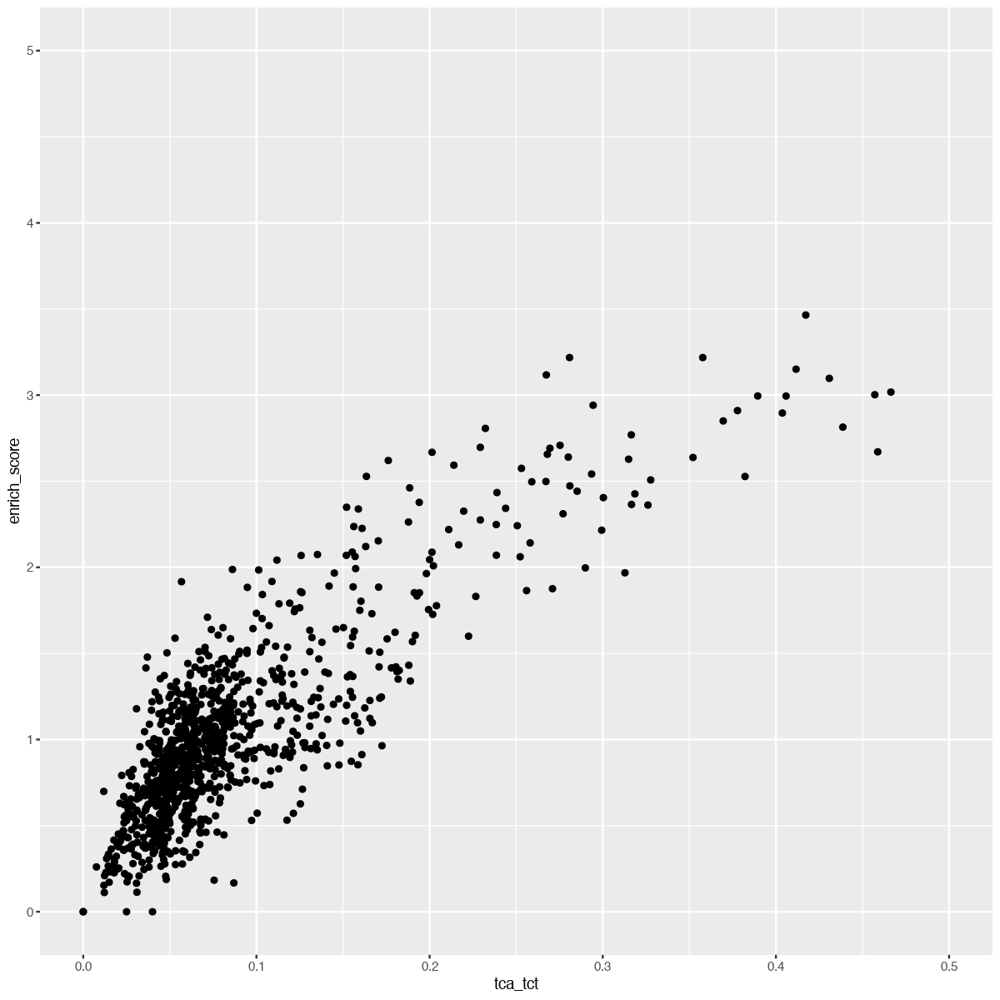

In [107]:
#ggplot(sigs_enrich_tcw, aes(enrich_score, tca_tct)) +
#  geom_point() +
#  xlim(0,5) +
#  ylim(0,0.5)

ggplot(sigs_enrich_tcw, aes(tca_tct,enrich_score)) +
  geom_point() +
  ylim(0,5) +
  xlim(0,0.5)

Warning message:
“Removed 3 rows containing missing values (geom_point).”


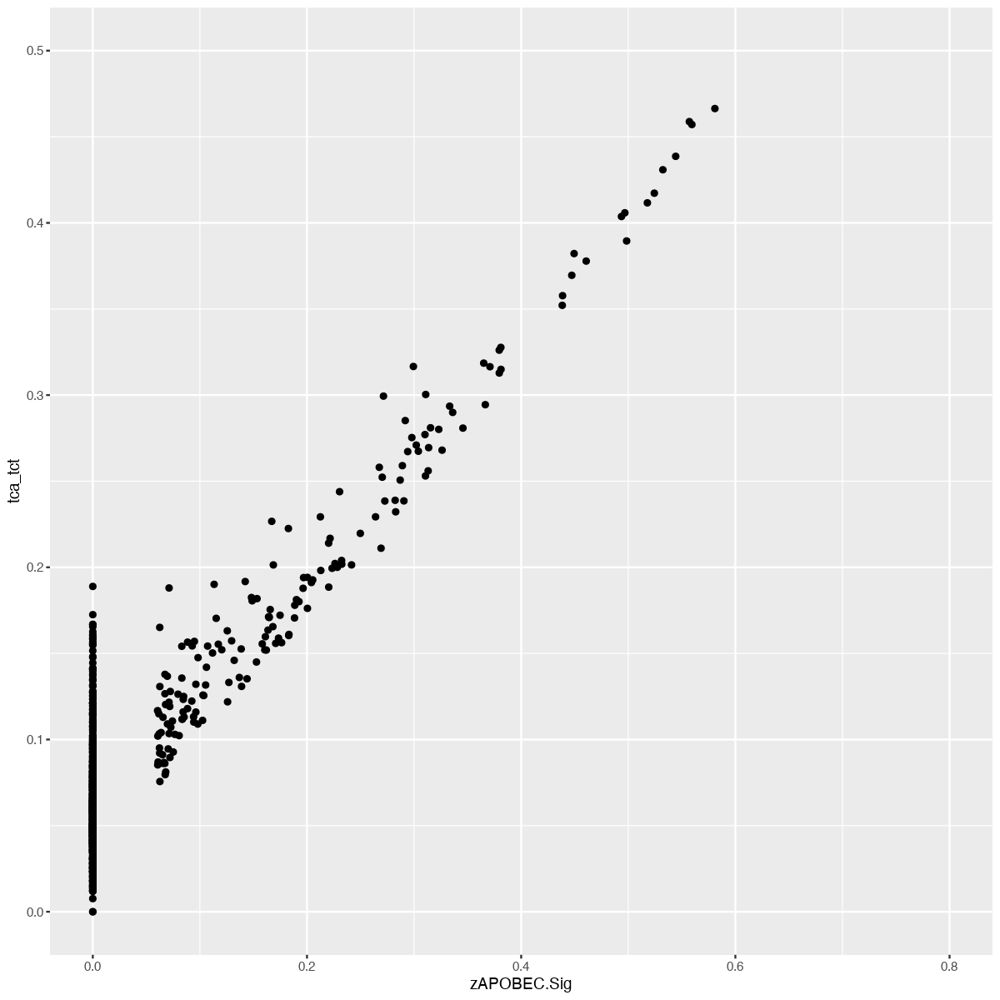

In [108]:
ggplot(sigs_enrich_tcw, aes(zAPOBEC.Sig, tca_tct)) +
  geom_point() +
  xlim(0,0.8) +
  ylim(0,0.5)

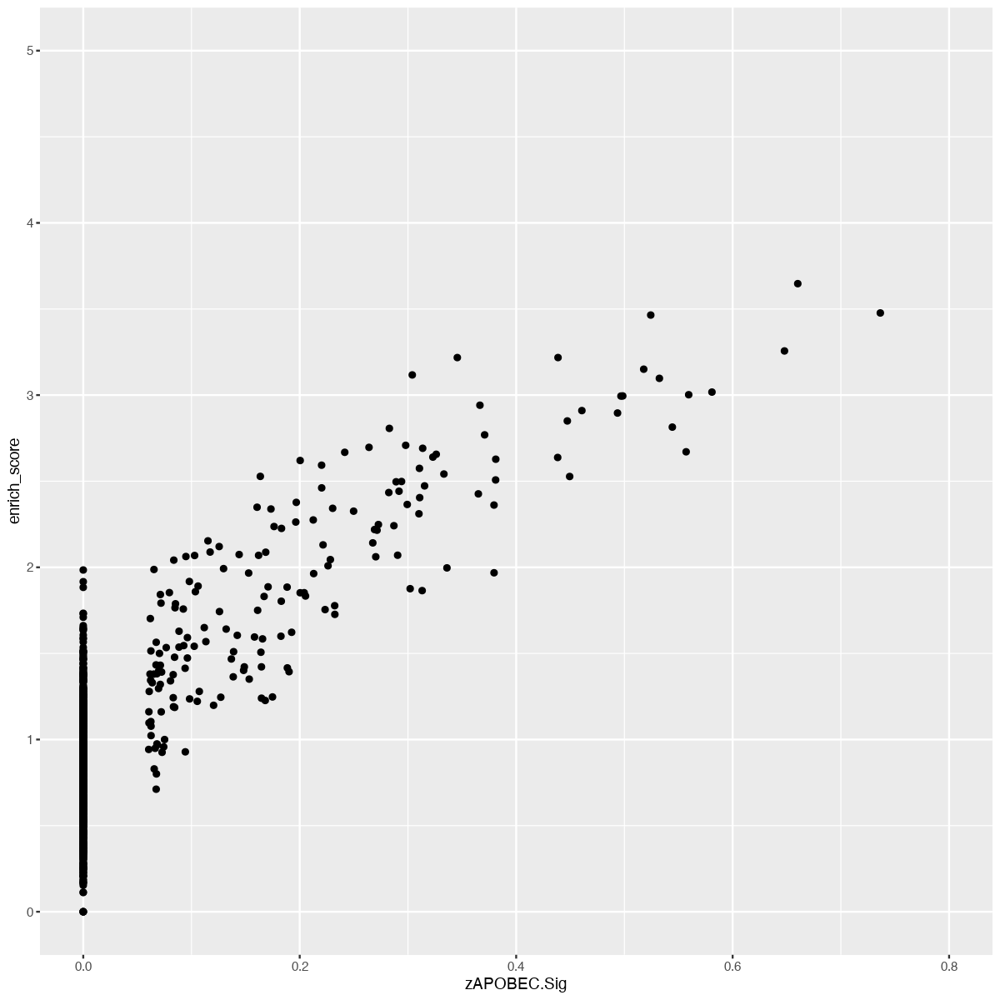

In [109]:
ggplot(sigs_enrich_tcw, aes(zAPOBEC.Sig, enrich_score)) +
  geom_point() +
  xlim(0,0.8) +
  ylim(0,5)

In [110]:
# Try to plot "Mutation Fraction"/"Trinucleotide Context" from "context"

In [111]:
head(context)

,A[C>A]A,A[C>A]C,A[C>A]G,A[C>A]T,C[C>A]A,C[C>A]C,C[C>A]G,C[C>A]T,G[C>A]A,G[C>A]C,⋯,C[T>G]G,C[T>G]T,G[T>G]A,G[T>G]C,G[T>G]G,G[T>G]T,T[T>G]A,T[T>G]C,T[T>G]G,T[T>G]T
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
201T,0.0209205021,0.004184100,0.0104602510,0.0104602510,0.008368201,0.027196653,0.008368201,0.006276151,0.016736402,0.014644351,⋯,0.008368201,0.006276151,0.0020920502,0.0000000000,0.0000000000,0.002092050,0.00209205,0.004184100,0.004184100,0.0020920502
22RV1,0.0005279831,0.002639916,0.0000000000,0.0005279831,0.005807814,0.013727561,0.010031679,0.029567054,0.001583949,0.002639916,⋯,0.004751848,0.004223865,0.0005279831,0.0005279831,0.0005279831,0.000000000,0.00000000,0.001583949,0.001055966,0.0005279831
23132-87,0.0010672359,0.001600854,0.0005336179,0.0048025614,0.011205977,0.023479189,0.006403415,0.038420491,0.003735326,0.007470651,⋯,0.003735326,0.008004269,0.0000000000,0.0010672359,0.0016008538,0.007470651,0.00000000,0.001067236,0.000000000,0.0037353255
42-MG-BA,0.0129870130,0.012987013,0.0000000000,0.0000000000,0.021645022,0.004329004,0.000000000,0.000000000,0.004329004,0.004329004,⋯,0.000000000,0.008658009,0.0000000000,0.0000000000,0.0000000000,0.000000000,0.00000000,0.000000000,0.004329004,0.0000000000
451Lu,0.0061823802,0.003091190,0.0000000000,0.0061823802,0.004636785,0.001545595,0.003091190,0.003091190,0.006182380,0.003091190,⋯,0.001545595,0.003091190,0.0000000000,0.0000000000,0.0061823802,0.003091190,0.00000000,0.001545595,0.001545595,0.0015455951
5637,0.0015360983,0.009216590,0.0092165899,0.0030721966,0.006144393,0.007680492,0.001536098,0.004608295,0.003072197,0.012288786,⋯,0.000000000,0.000000000,0.0000000000,0.0000000000,0.0030721966,0.003072197,0.00000000,0.001536098,0.009216590,0.0030721966


In [112]:
context$sample <- rownames(context)
head(context)

,A[C>A]A,A[C>A]C,A[C>A]G,A[C>A]T,C[C>A]A,C[C>A]C,C[C>A]G,C[C>A]T,G[C>A]A,G[C>A]C,⋯,C[T>G]T,G[T>G]A,G[T>G]C,G[T>G]G,G[T>G]T,T[T>G]A,T[T>G]C,T[T>G]G,T[T>G]T,sample
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
201T,0.0209205021,0.004184100,0.0104602510,0.0104602510,0.008368201,0.027196653,0.008368201,0.006276151,0.016736402,0.014644351,⋯,0.006276151,0.0020920502,0.0000000000,0.0000000000,0.002092050,0.00209205,0.004184100,0.004184100,0.0020920502,201T
22RV1,0.0005279831,0.002639916,0.0000000000,0.0005279831,0.005807814,0.013727561,0.010031679,0.029567054,0.001583949,0.002639916,⋯,0.004223865,0.0005279831,0.0005279831,0.0005279831,0.000000000,0.00000000,0.001583949,0.001055966,0.0005279831,22RV1
23132-87,0.0010672359,0.001600854,0.0005336179,0.0048025614,0.011205977,0.023479189,0.006403415,0.038420491,0.003735326,0.007470651,⋯,0.008004269,0.0000000000,0.0010672359,0.0016008538,0.007470651,0.00000000,0.001067236,0.000000000,0.0037353255,23132-87
42-MG-BA,0.0129870130,0.012987013,0.0000000000,0.0000000000,0.021645022,0.004329004,0.000000000,0.000000000,0.004329004,0.004329004,⋯,0.008658009,0.0000000000,0.0000000000,0.0000000000,0.000000000,0.00000000,0.000000000,0.004329004,0.0000000000,42-MG-BA
451Lu,0.0061823802,0.003091190,0.0000000000,0.0061823802,0.004636785,0.001545595,0.003091190,0.003091190,0.006182380,0.003091190,⋯,0.003091190,0.0000000000,0.0000000000,0.0061823802,0.003091190,0.00000000,0.001545595,0.001545595,0.0015455951,451Lu
5637,0.0015360983,0.009216590,0.0092165899,0.0030721966,0.006144393,0.007680492,0.001536098,0.004608295,0.003072197,0.012288786,⋯,0.000000000,0.0000000000,0.0000000000,0.0030721966,0.003072197,0.00000000,0.001536098,0.009216590,0.0030721966,5637


In [113]:
context <- merge(context, cosmic_tissue_type, by = "sample", all.x = T)
head(context)

,sample,A[C>A]A,A[C>A]C,A[C>A]G,A[C>A]T,C[C>A]A,C[C>A]C,C[C>A]G,C[C>A]T,G[C>A]A,⋯,C[T>G]T,G[T>G]A,G[T>G]C,G[T>G]G,G[T>G]T,T[T>G]A,T[T>G]C,T[T>G]G,T[T>G]T,tissue
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
1,201T,0.0209205021,0.004184100,0.0104602510,0.0104602510,0.008368201,0.027196653,0.008368201,0.006276151,0.016736402,⋯,0.006276151,0.0020920502,0.0000000000,0.0000000000,0.002092050,0.00209205,0.004184100,0.004184100,0.0020920502,Lung
2,22RV1,0.0005279831,0.002639916,0.0000000000,0.0005279831,0.005807814,0.013727561,0.010031679,0.029567054,0.001583949,⋯,0.004223865,0.0005279831,0.0005279831,0.0005279831,0.000000000,0.00000000,0.001583949,0.001055966,0.0005279831,Prostate
3,23132-87,0.0010672359,0.001600854,0.0005336179,0.0048025614,0.011205977,0.023479189,0.006403415,0.038420491,0.003735326,⋯,0.008004269,0.0000000000,0.0010672359,0.0016008538,0.007470651,0.00000000,0.001067236,0.000000000,0.0037353255,Stomach
4,42-MG-BA,0.0129870130,0.012987013,0.0000000000,0.0000000000,0.021645022,0.004329004,0.000000000,0.000000000,0.004329004,⋯,0.008658009,0.0000000000,0.0000000000,0.0000000000,0.000000000,0.00000000,0.000000000,0.004329004,0.0000000000,CNS
5,451Lu,0.0061823802,0.003091190,0.0000000000,0.0061823802,0.004636785,0.001545595,0.003091190,0.003091190,0.006182380,⋯,0.003091190,0.0000000000,0.0000000000,0.0061823802,0.003091190,0.00000000,0.001545595,0.001545595,0.0015455951,Skin
6,5637,0.0015360983,0.009216590,0.0092165899,0.0030721966,0.006144393,0.007680492,0.001536098,0.004608295,0.003072197,⋯,0.000000000,0.0000000000,0.0000000000,0.0030721966,0.003072197,0.00000000,0.001536098,0.009216590,0.0030721966,Bladder


In [114]:
context_melt <- melt(context,id=c("sample","tissue"))
head(context_melt)

,sample,tissue,variable,value
,<chr>,<chr>,<fct>,<dbl>
1,201T,Lung,A[C>A]A,0.0209205021
2,22RV1,Prostate,A[C>A]A,0.0005279831
3,23132-87,Stomach,A[C>A]A,0.0010672359
4,42-MG-BA,CNS,A[C>A]A,0.0129870130
5,451Lu,Skin,A[C>A]A,0.0061823802
6,5637,Bladder,A[C>A]A,0.0015360983


In [115]:
context_melt$alt <- substr(context_melt$variable, 5, 5)
head(context_melt)

,sample,tissue,variable,value,alt
,<chr>,<chr>,<fct>,<dbl>,<chr>
1,201T,Lung,A[C>A]A,0.0209205021,A
2,22RV1,Prostate,A[C>A]A,0.0005279831,A
3,23132-87,Stomach,A[C>A]A,0.0010672359,A
4,42-MG-BA,CNS,A[C>A]A,0.0129870130,A
5,451Lu,Skin,A[C>A]A,0.0061823802,A
6,5637,Bladder,A[C>A]A,0.0015360983,A


In [116]:
context_melt$trinuc <- paste0(substr(context_melt$variable, 1, 1),
                              substr(context_melt$variable, 3, 3),
                              substr(context_melt$variable, 7, 7))
head(context_melt)

,sample,tissue,variable,value,alt,trinuc
,<chr>,<chr>,<fct>,<dbl>,<chr>,<chr>
1,201T,Lung,A[C>A]A,0.0209205021,A,ACA
2,22RV1,Prostate,A[C>A]A,0.0005279831,A,ACA
3,23132-87,Stomach,A[C>A]A,0.0010672359,A,ACA
4,42-MG-BA,CNS,A[C>A]A,0.0129870130,A,ACA
5,451Lu,Skin,A[C>A]A,0.0061823802,A,ACA
6,5637,Bladder,A[C>A]A,0.0015360983,A,ACA


In [117]:
# Adjust plot size
options(repr.plot.width=16, repr.plot.height=6)

In [118]:
samples <- unique(as.vector(context_melt[,"sample"]))
head(samples)

[1] "201T"     "22RV1"    "23132-87" "42-MG-BA" "451Lu"    "5637"

In [119]:
length(samples)

[1] 1020

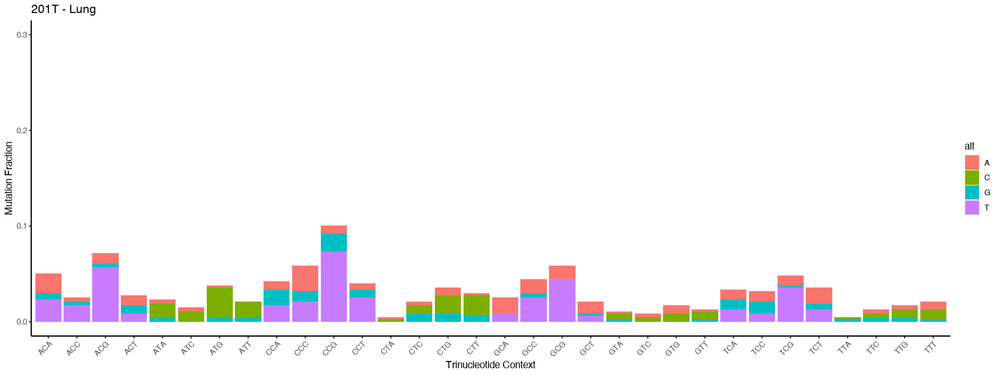

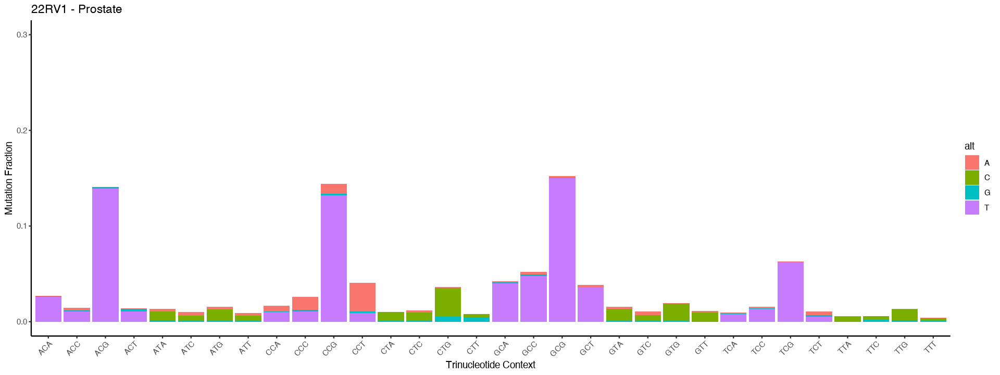

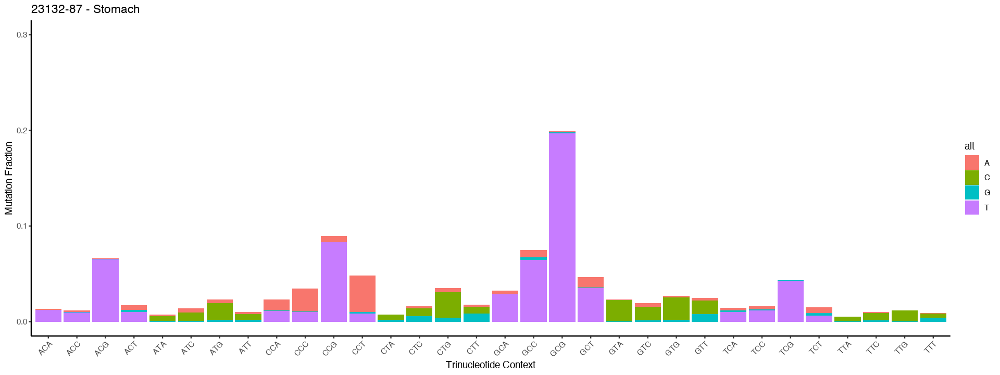

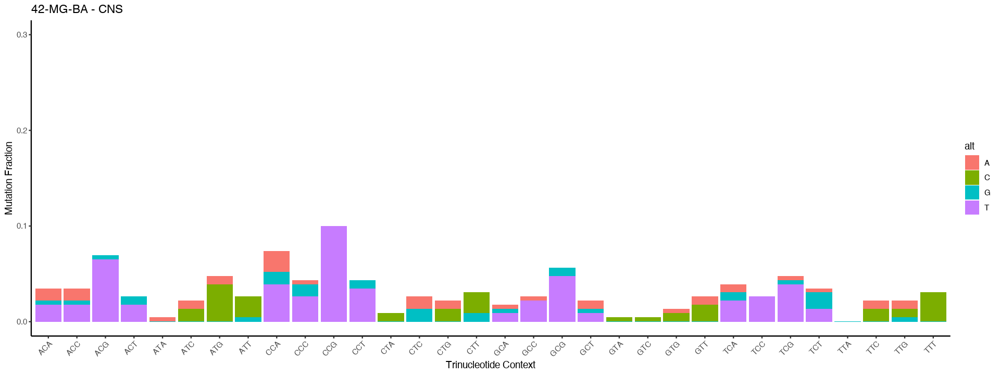

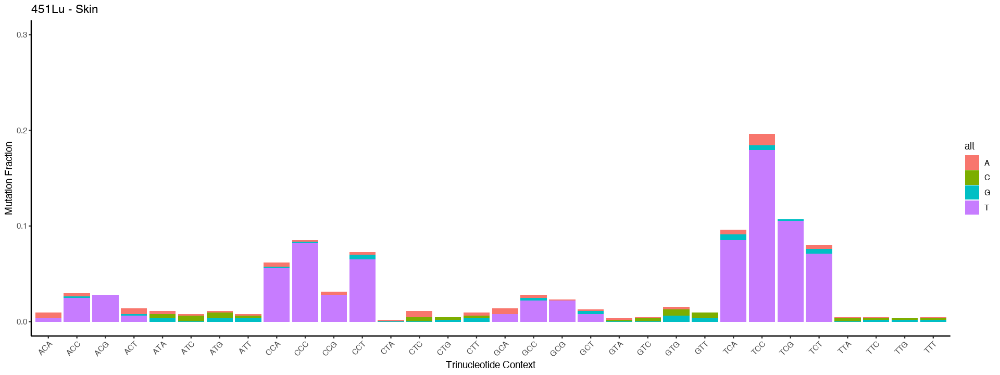

...

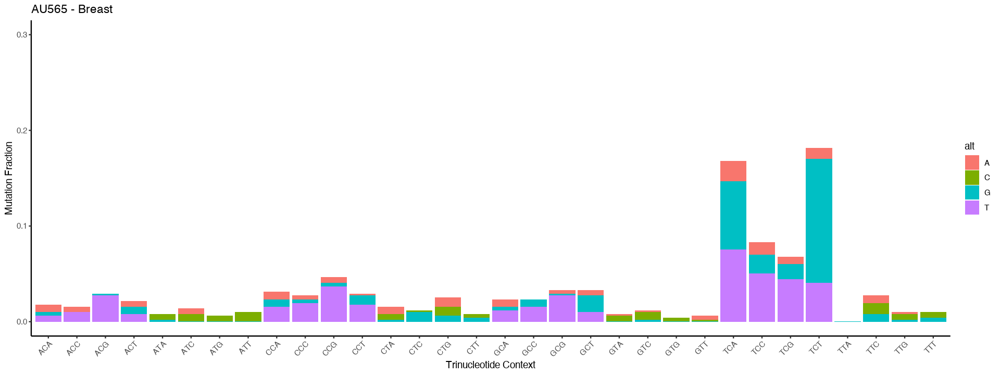

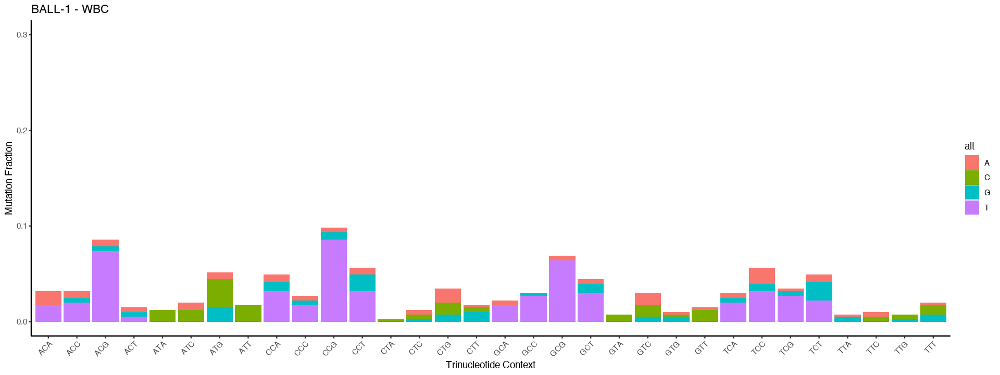

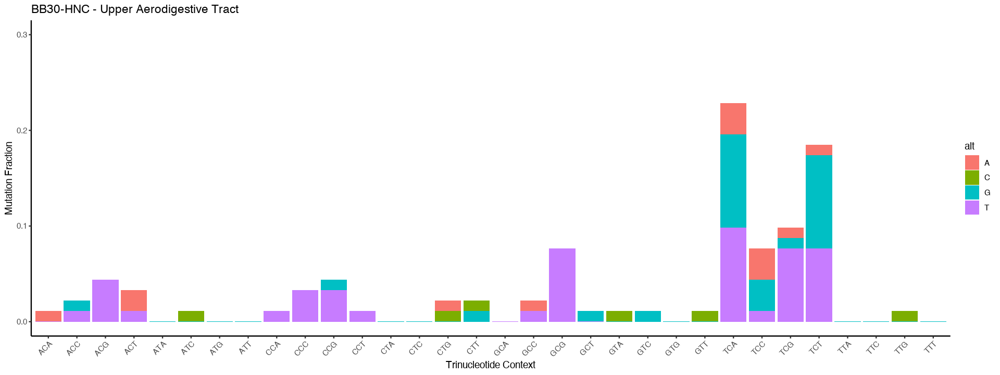

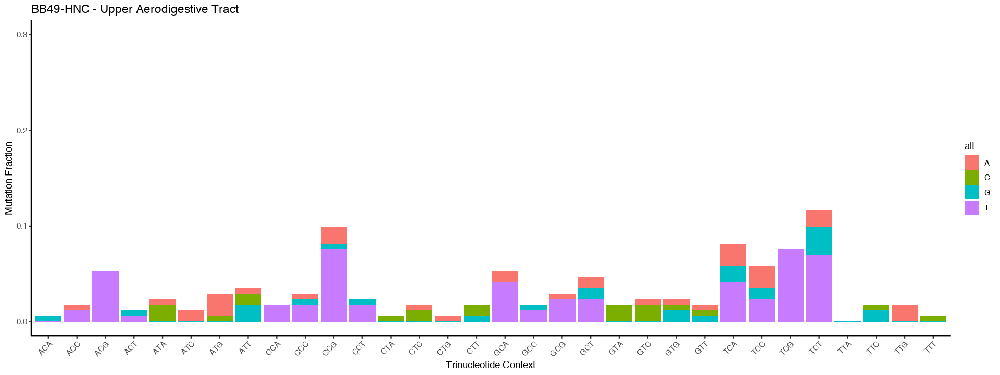

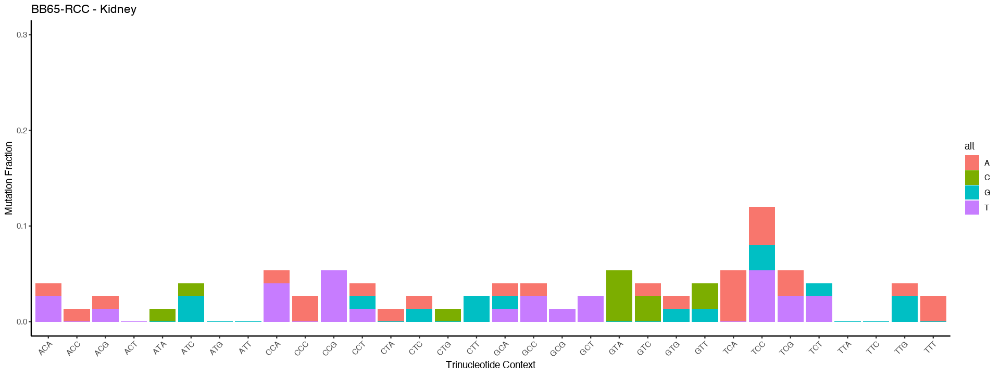

Warning message:
“Removed 2 rows containing missing values (geom_col).”


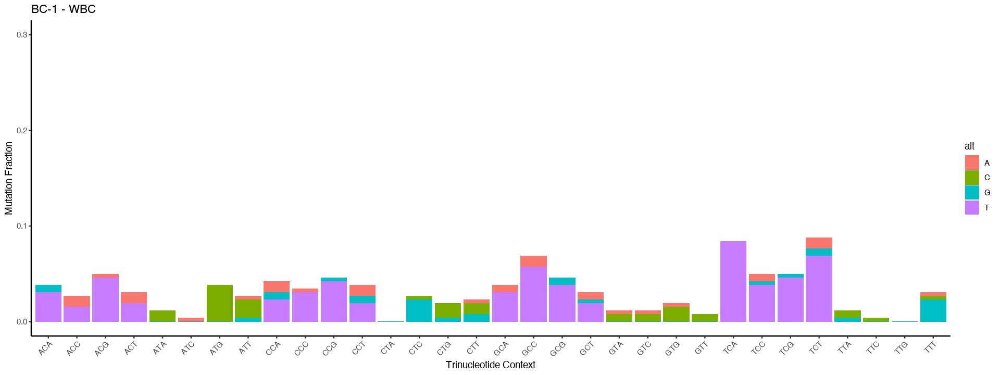

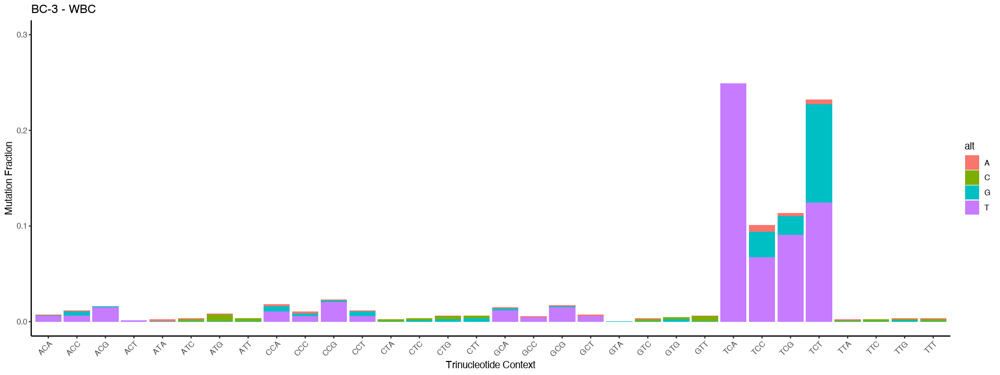

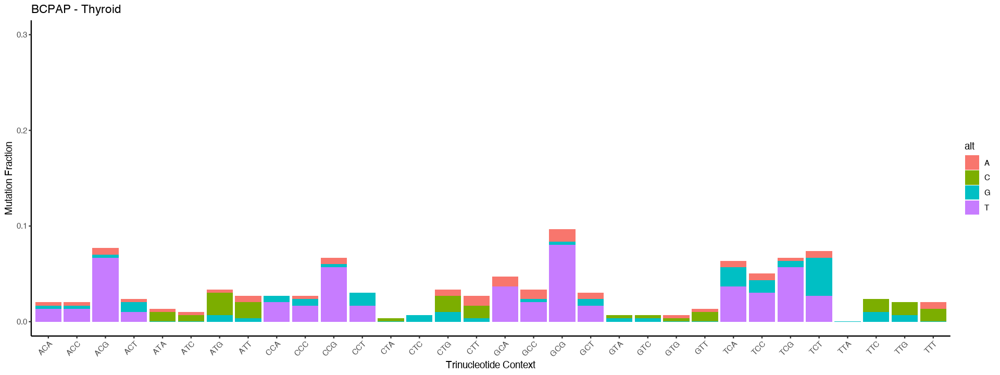

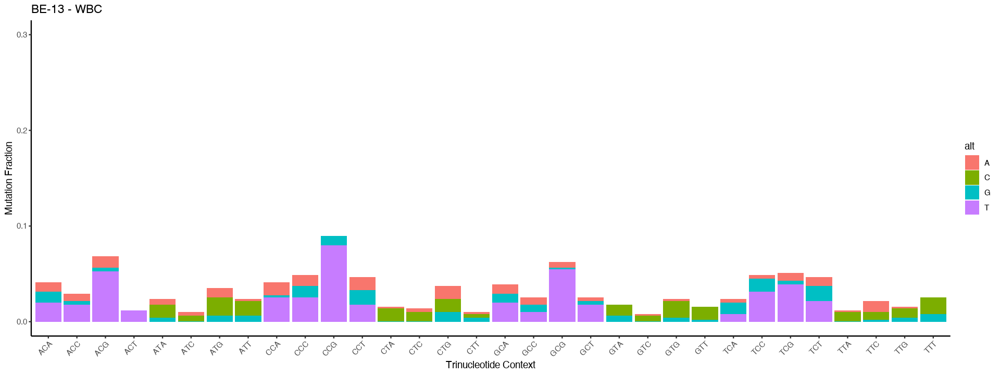

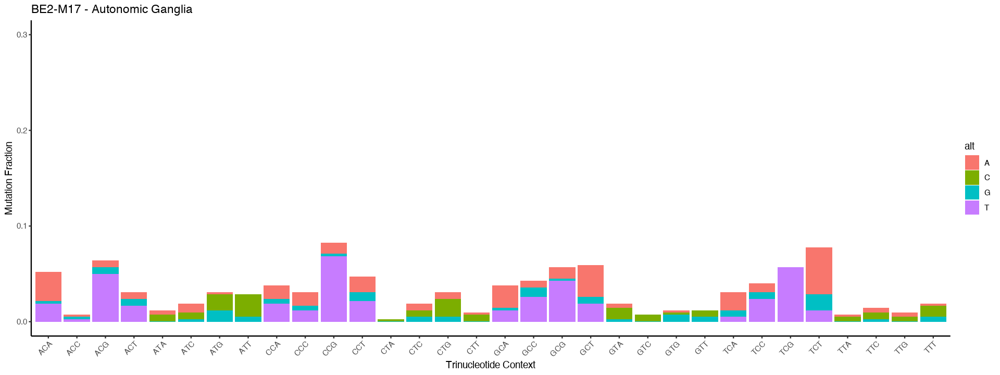

...

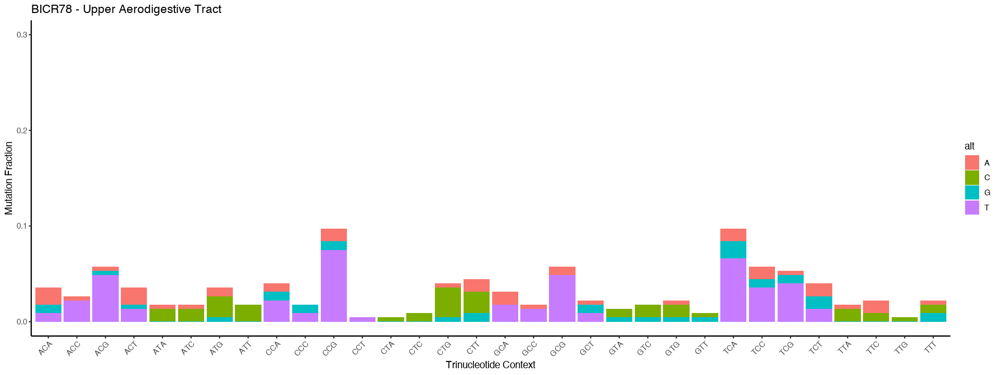

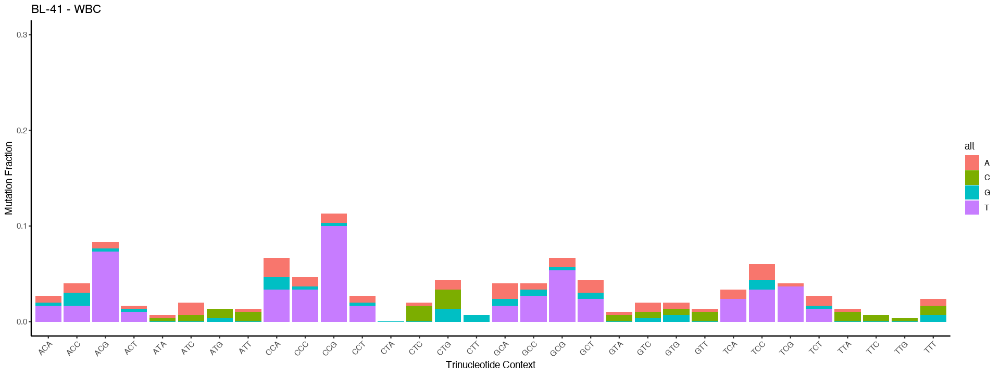

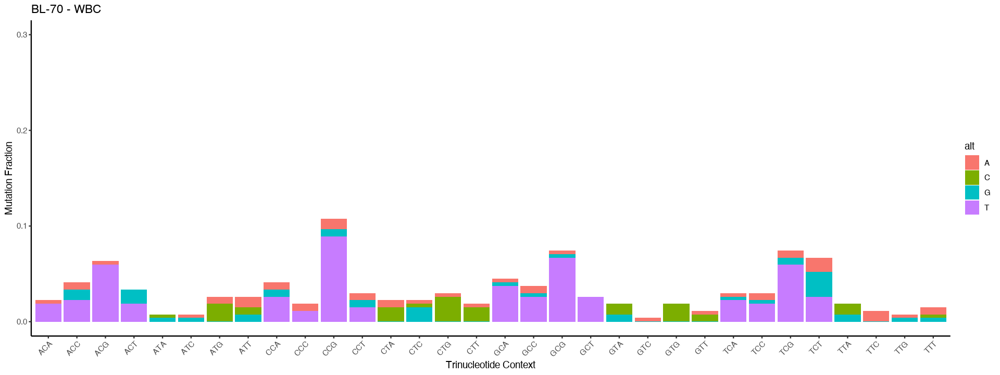

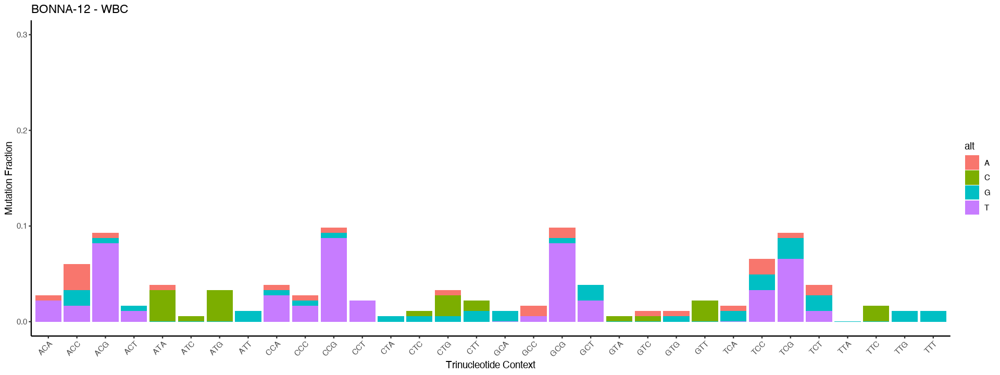

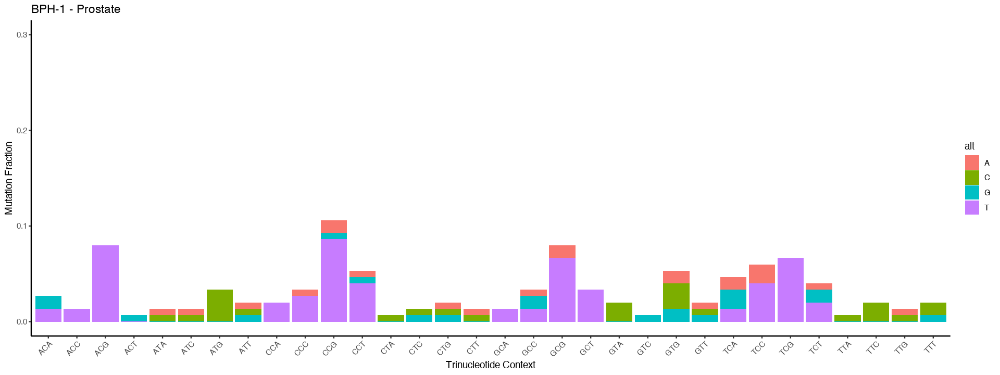

Warning message:
“Removed 1 rows containing missing values (geom_col).”


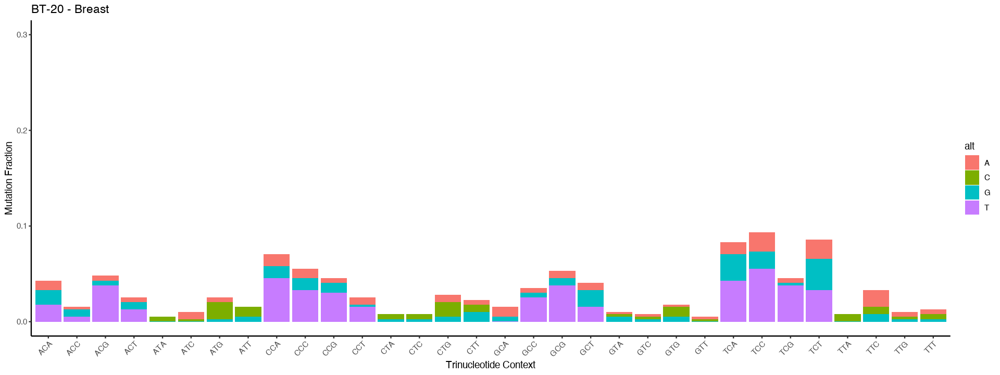

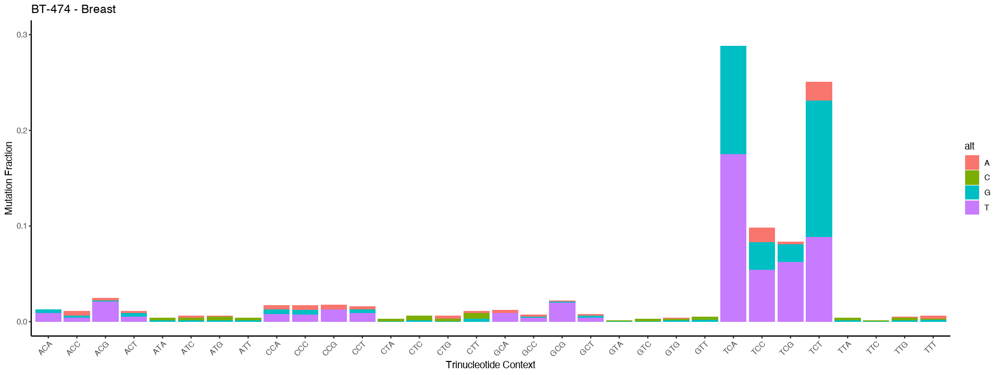

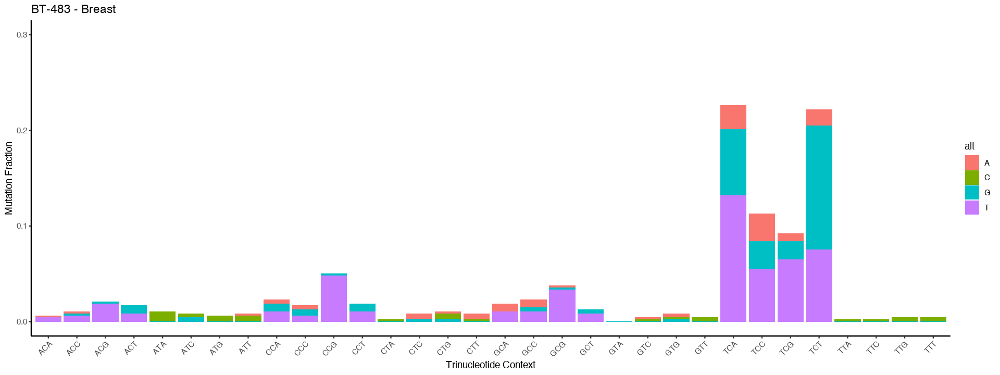

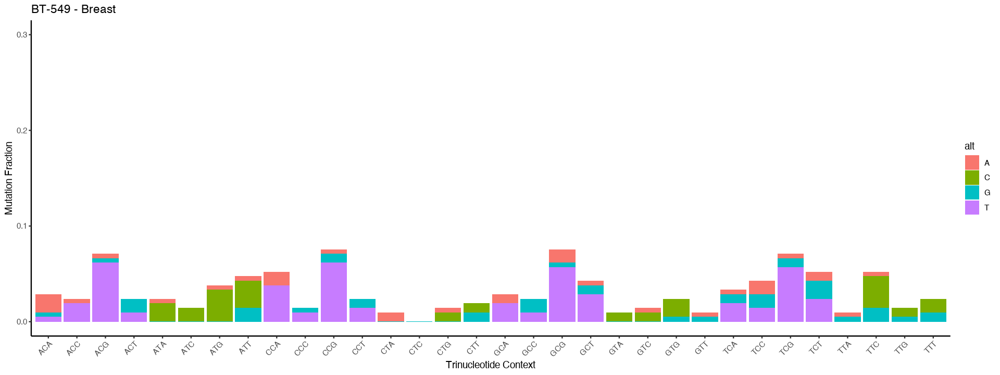

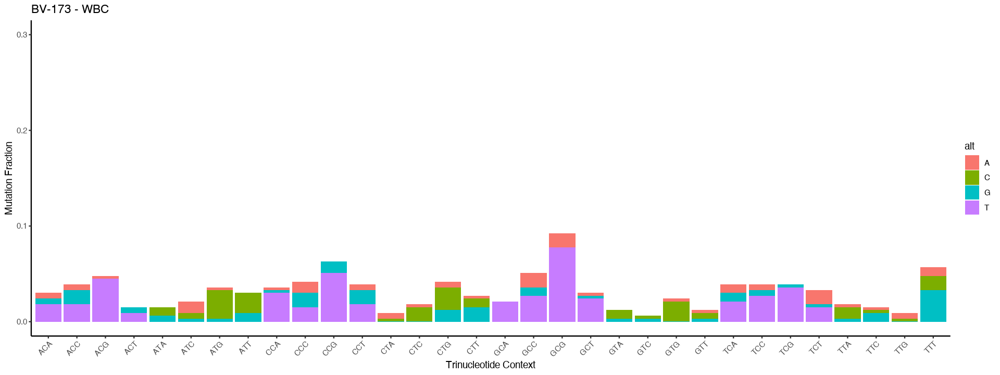

...

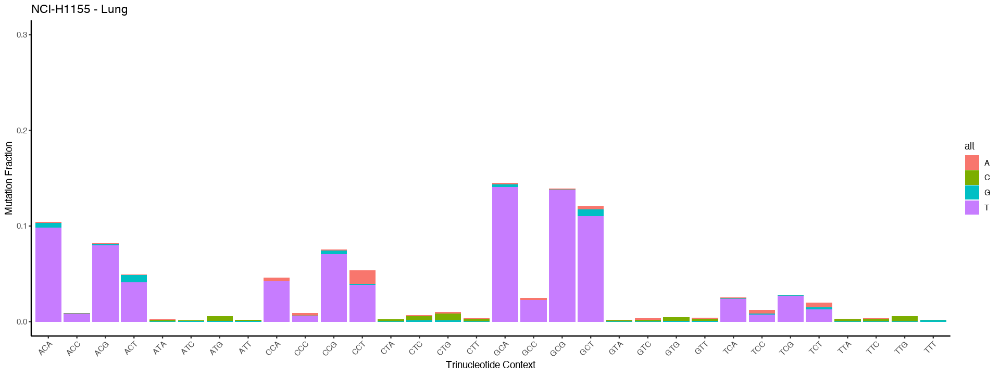

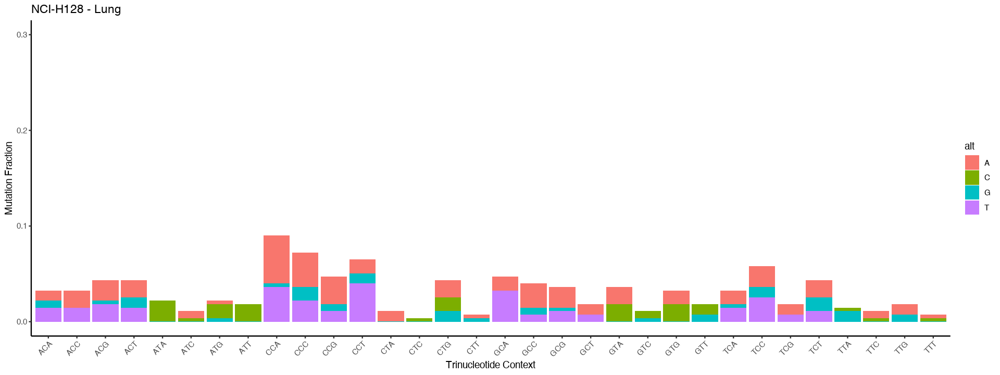

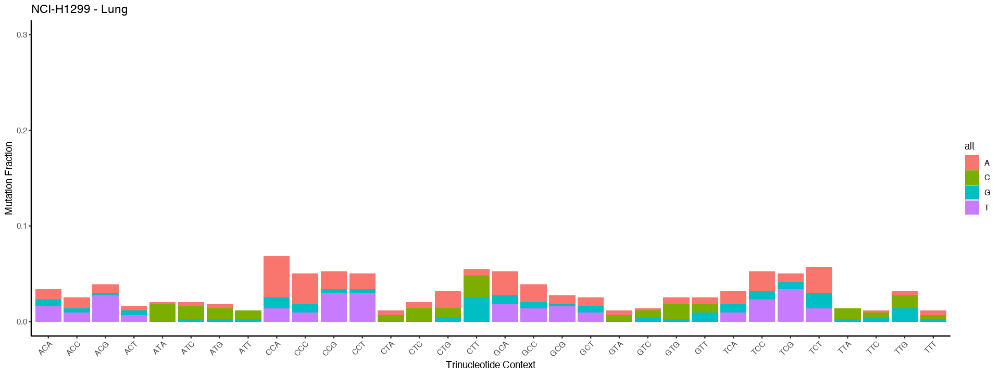

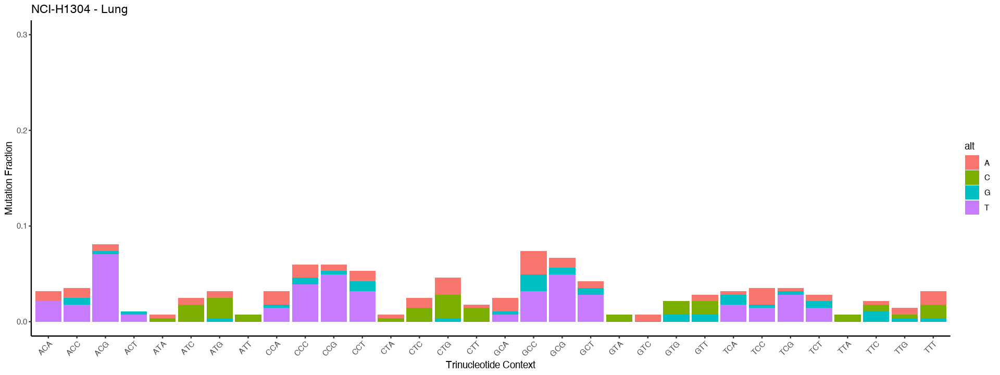

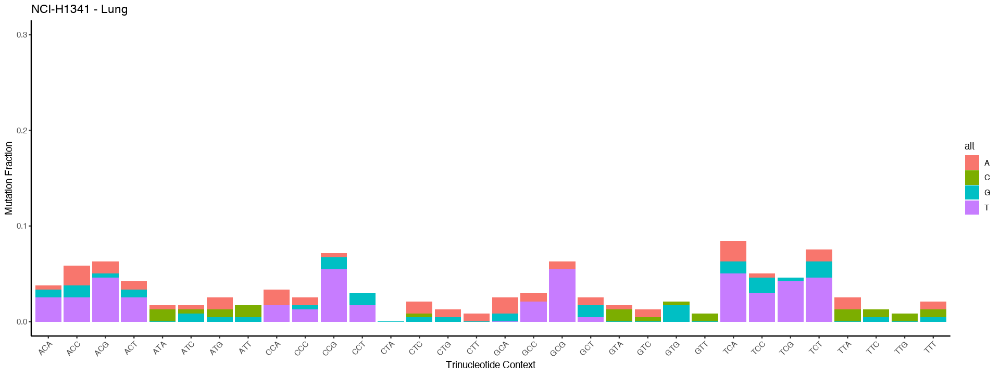

Warning message:
“Removed 1 rows containing missing values (position_stack).”


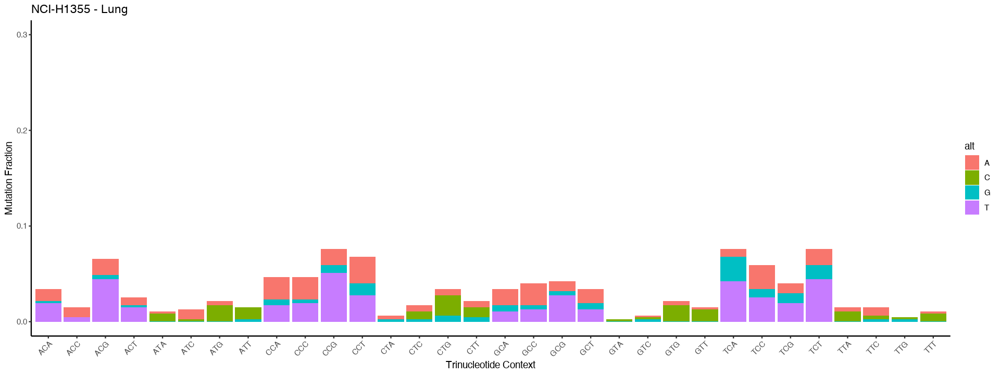

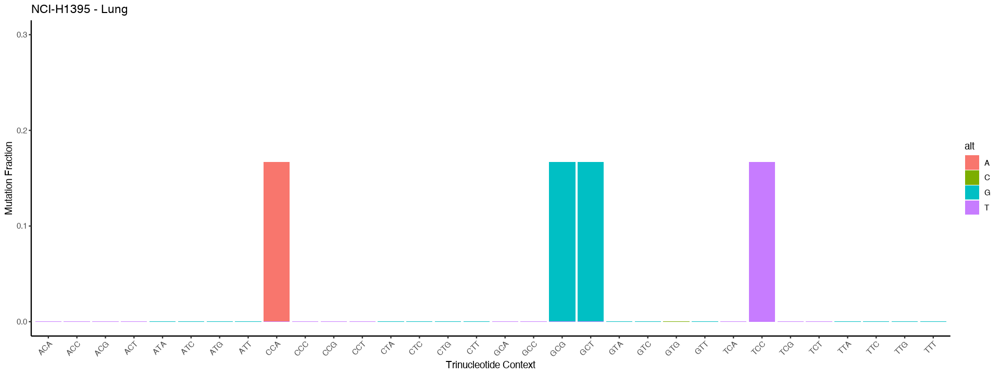

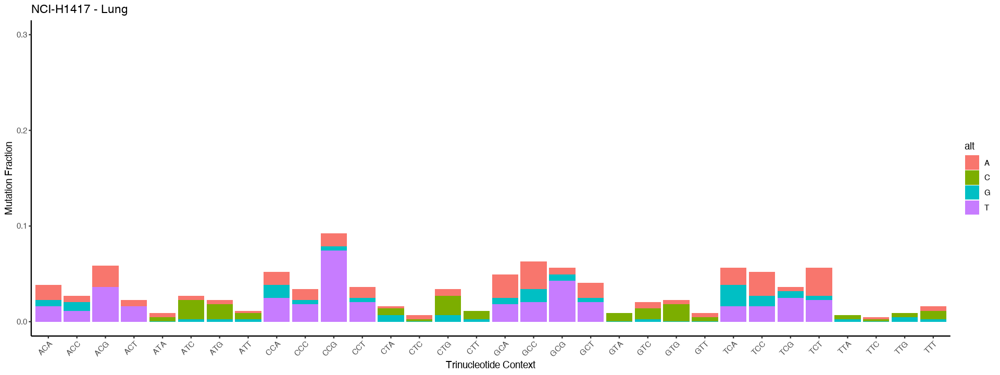

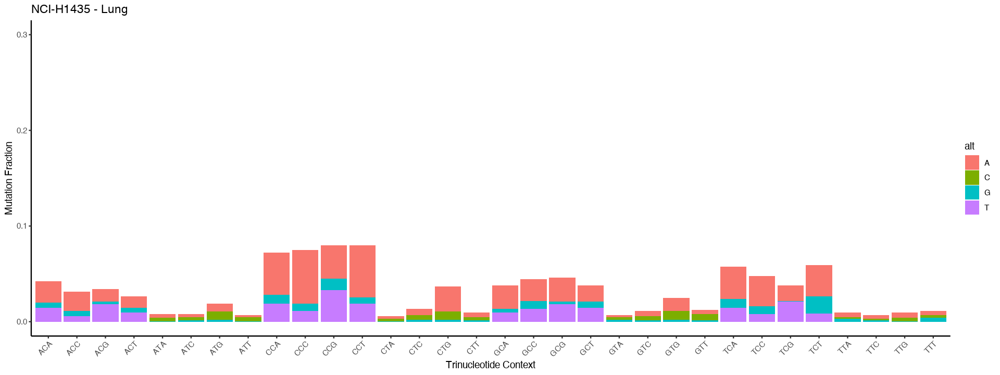

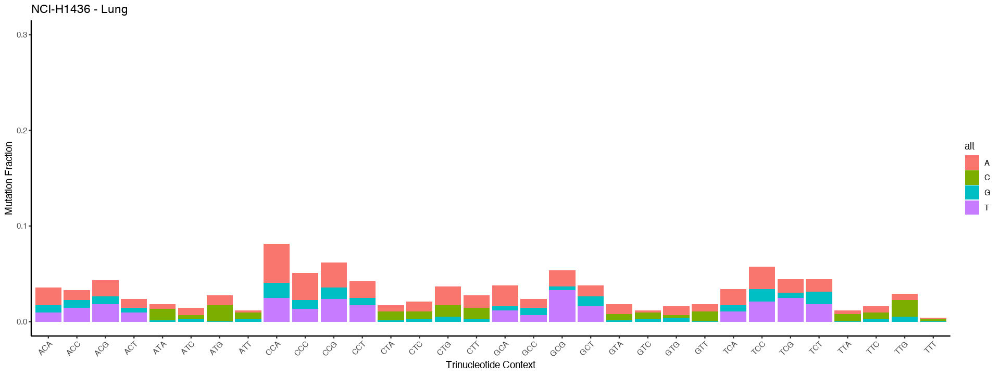

...

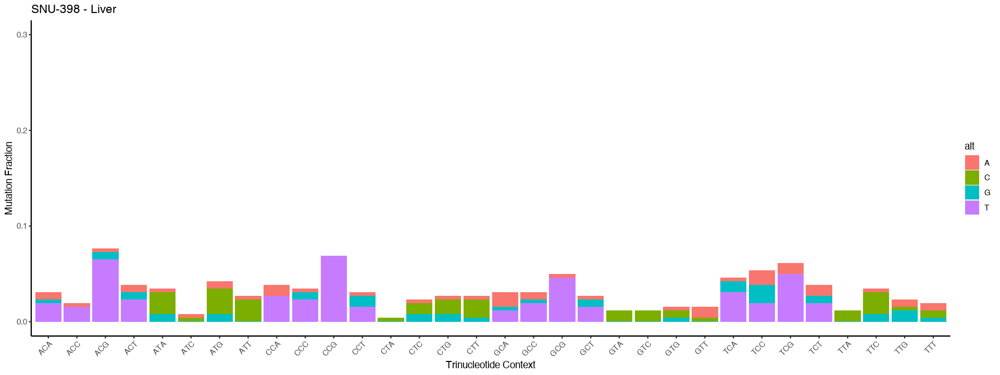

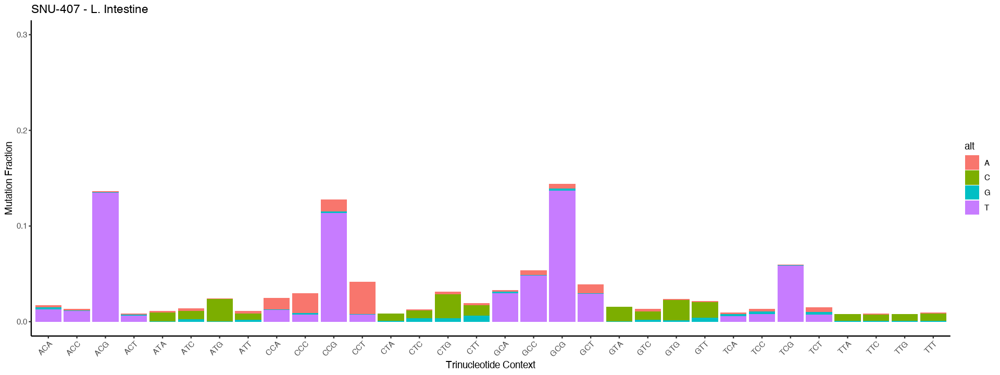

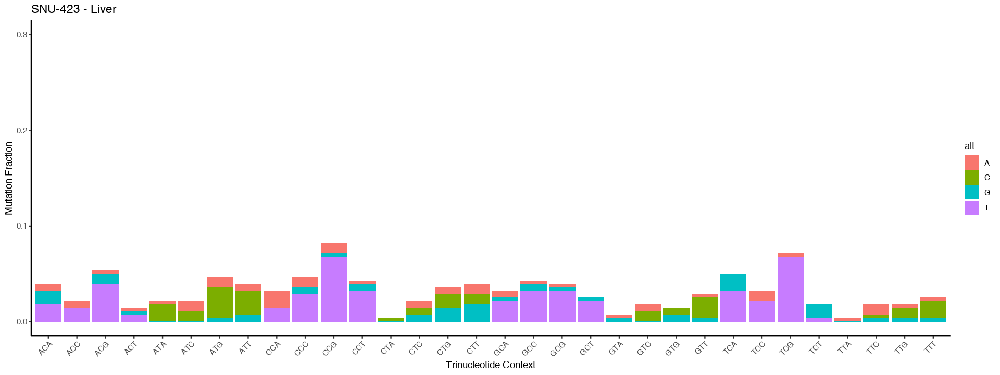

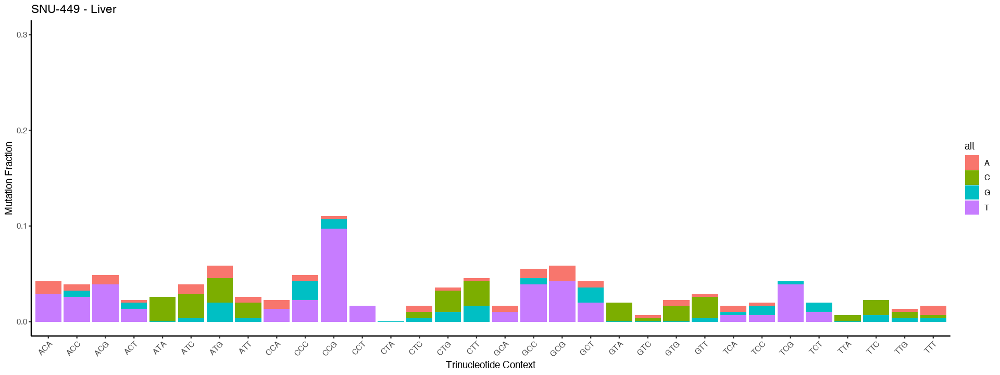

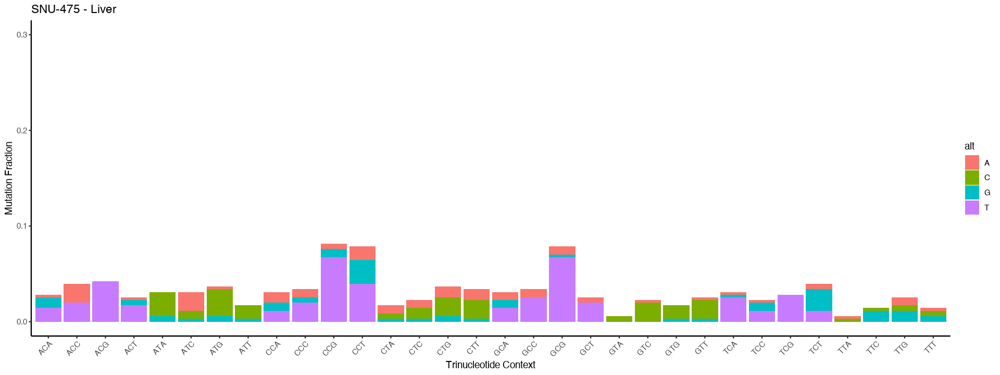

Warning message:
“Removed 1 rows containing missing values (geom_col).”


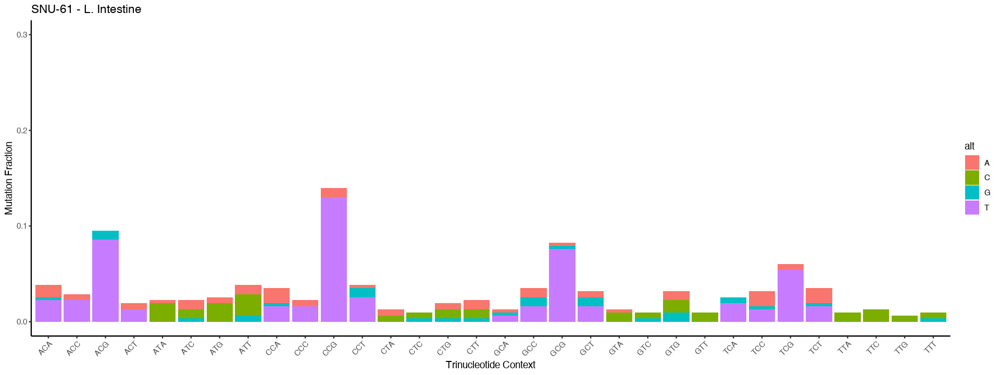

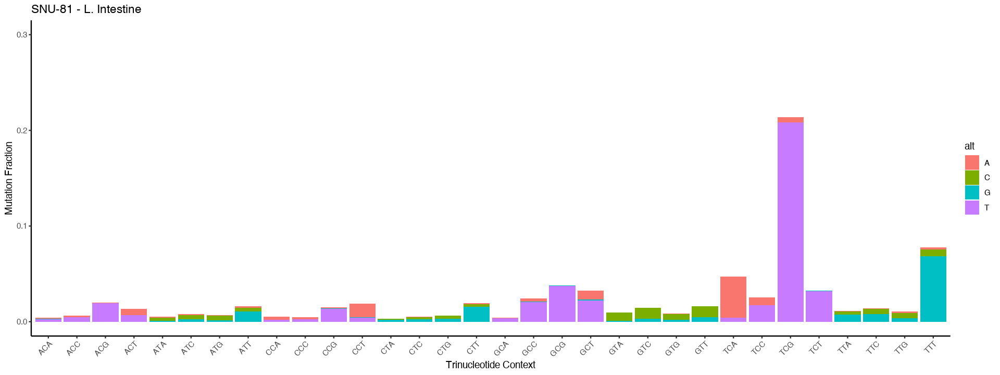

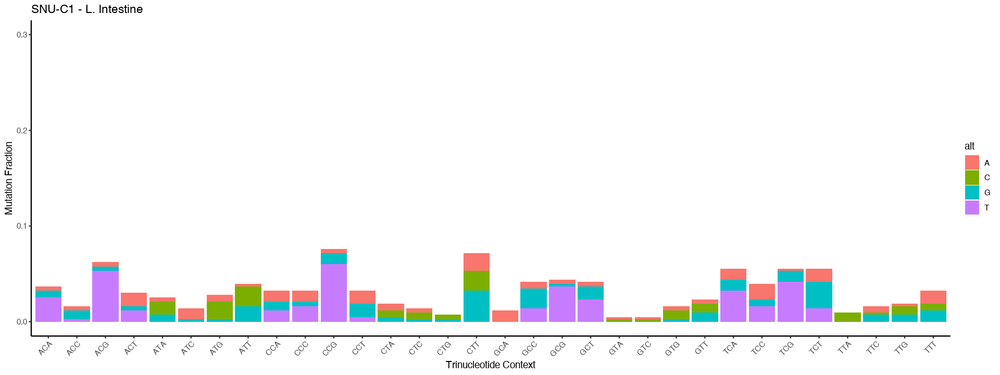

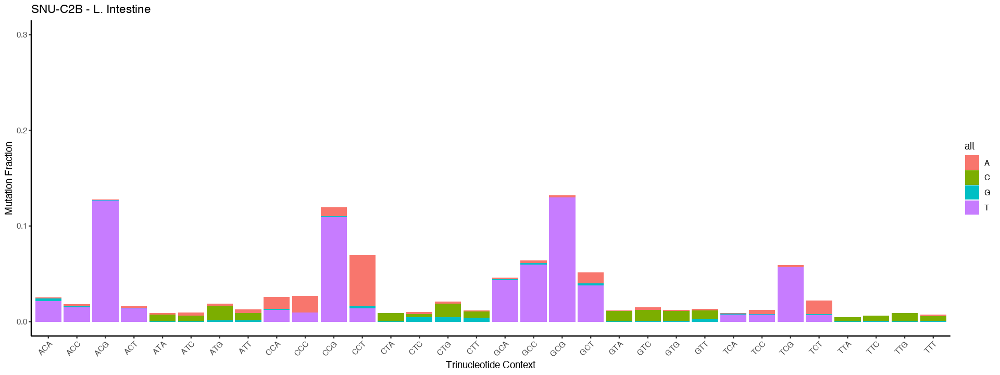

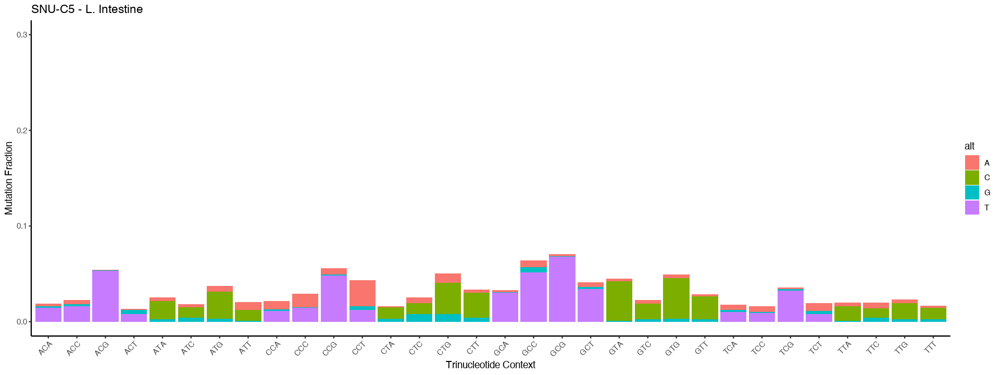

...

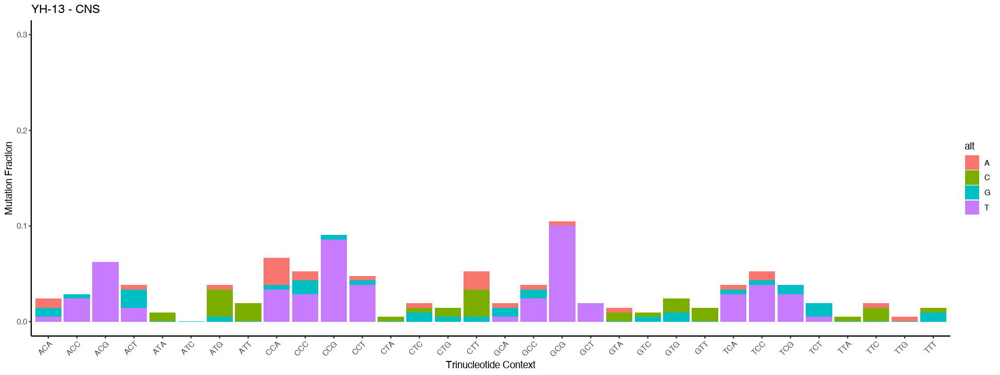

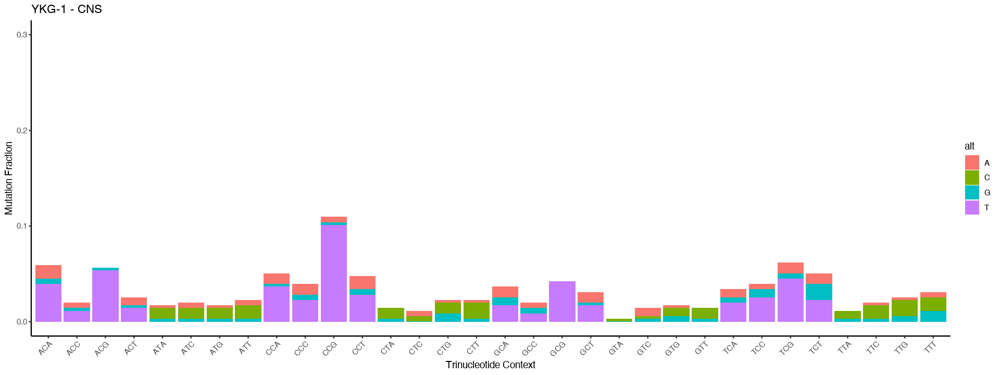

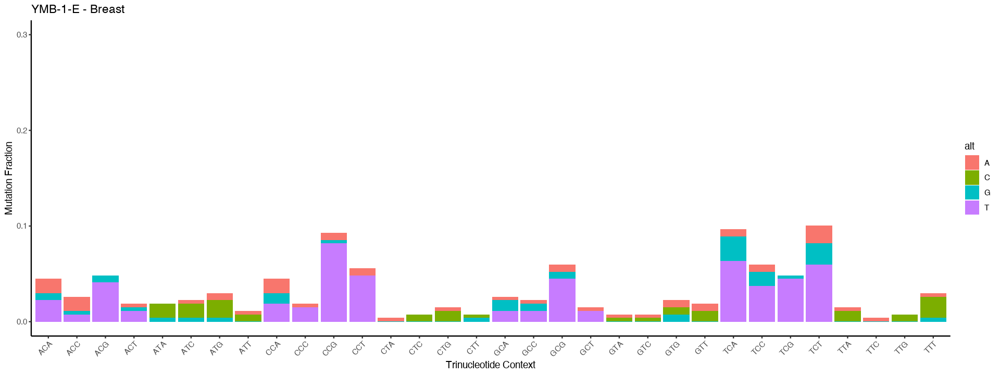

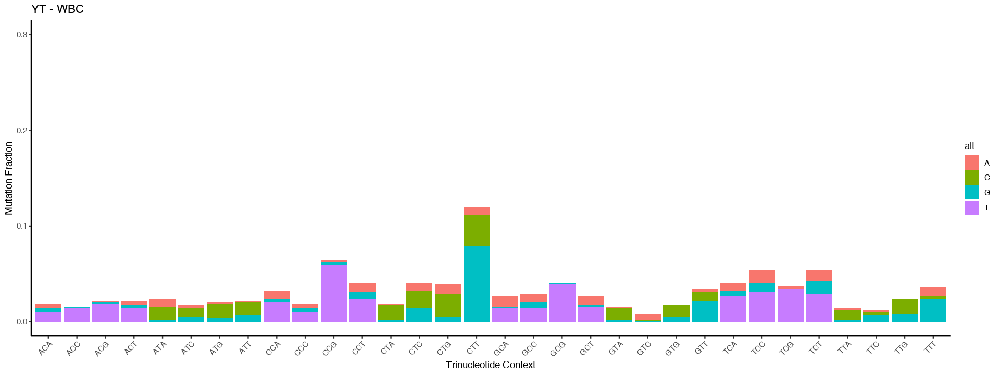

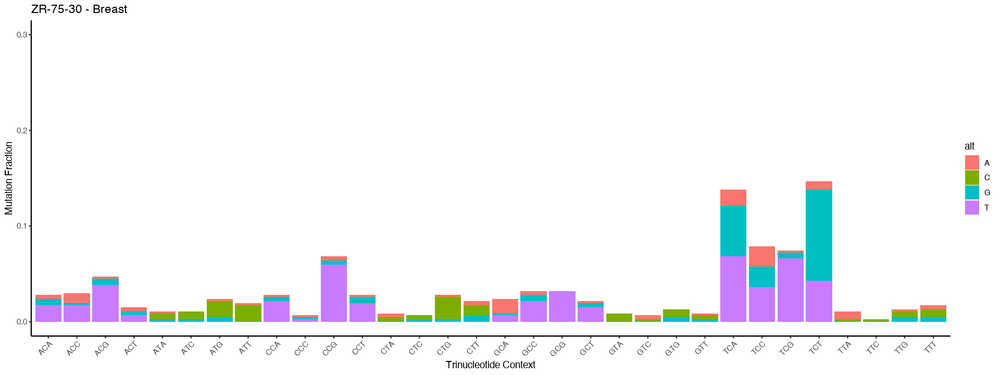

In [120]:
#for( this_tissue in tissues ){
for( this_sample in samples ){
    cell_line = subset(context_melt, sample == this_sample ) #& tissue == this_tissue )
    if( nrow(cell_line) > 0 ){
        print(ggplot(cell_line, aes(trinuc, value, fill = alt)) +
            geom_col() +
            ylim(0,0.30) +  # fixed y limit for easier viewing and comparison
            ggtitle( paste0( this_sample, " - ", cell_line$tissue[1] ) ) +
#            ggtitle( paste0( this_tissue, " - ", this_sample ) ) +
            theme(axis.text.x=element_text(angle = 45, hjust = 1)) +
            xlab("Trinucleotide Context") +
            ylab("Mutation Fraction") +
            #      scale_x_discrete(limits = list1) +
            theme_bw() +
            theme(axis.text.x=element_text(angle = 45, hjust = 1),
                panel.border = element_blank(),
                panel.grid.major = element_blank(),
                panel.grid.minor = element_blank(),
                axis.line = element_line(colour = "black")))
    }
} # }

In [121]:
date()

[1] "Thu Jun  4 20:29:55 2020"